# Notebook using single files

In [1]:
#We'll be using TF 2.1 and torchaudio
!export LD_LIBRARY_PATH=/usr/local/cuda/lib64
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

Num GPUs Available:  1
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 7896102422669540108
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 11979666683388939119
physical_device_desc: "device: XLA_CPU device"
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 16837963803920052567
physical_device_desc: "device: XLA_GPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 7825732404
locality {
  bus_id: 1
  links {
  }
}
incarnation: 3471121399222295643
physical_device_desc: "device: 0, name: GeForce RTX 2060 SUPER, pci bus id: 0000:01:00.0, compute capability: 7.5"
]


In [2]:
#Imports

from __future__ import print_function, division
from glob import glob
import scipy
import soundfile as sf
import matplotlib.pyplot as plt
from IPython.display import clear_output
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Concatenate, Conv2D, Conv2DTranspose, GlobalAveragePooling2D, UpSampling2D, LeakyReLU, ReLU, Add, Multiply, Lambda, Dot, BatchNormalization, Activation, ZeroPadding2D, Cropping2D, Cropping1D
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import TruncatedNormal, he_normal
import tensorflow.keras.backend as K
import datetime
import numpy as np
import random
import matplotlib.pyplot as plt
import collections
from PIL import Image
from skimage.transform import resize
import imageio
import librosa
import librosa.display
from librosa.feature import melspectrogram
import os
import time
import IPython

In [3]:
#Hyperparameters

hop=192               #hop size (window size = 6*hop)
sr=16000              #sampling rate
min_level_db=-100     #reference values to normalize data
ref_level_db=20

shape=24              #length of time axis of split specrograms to feed to generator            
vec_len=128           #length of vector generated by siamese vector
bs = 16               #batch size
delta = 2.            #constant for siamese loss

In [4]:
# There seems to be a problem with Tensorflow STFT, so we'll be using pytorch to handle offline mel-spectrogram generation and waveform reconstruction
# For waveform reconstruction, a gradient-based method is used:

""" Decorsière, Rémi, Peter L. Søndergaard, Ewen N. MacDonald, and Torsten Dau. 
"Inversion of auditory spectrograms, traditional spectrograms, and other envelope representations." 
IEEE/ACM Transactions on Audio, Speech, and Language Processing 23, no. 1 (2014): 46-56."""

# ORIGINAL CODE FROM https://github.com/yoyololicon/spectrogram-inversion

import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm import tqdm
from functools import partial
import math
import heapq
from torchaudio.transforms import MelScale, Spectrogram

torch.set_default_tensor_type("torch.cuda.FloatTensor")

specobj = Spectrogram(
    n_fft=6 * hop, win_length=6 * hop, hop_length=hop, pad=0, power=2, normalized=True
)
specfunc = specobj.forward
melobj = MelScale(n_mels=hop, sample_rate=sr, f_min=0.0)
melfunc = melobj.forward


def melspecfunc(waveform):
    specgram = specfunc(waveform)
    mel_specgram = melfunc(specgram)
    return mel_specgram


def spectral_convergence(input, target):
    return 20 * ((input - target).norm().log10() - target.norm().log10())


def GRAD(
    spec,
    transform_fn,
    samples=None,
    init_x0=None,
    maxiter=1000,
    tol=1e-6,
    verbose=1,
    evaiter=10,
    lr=0.003,
):

    spec = torch.Tensor(spec)
    samples = (spec.shape[-1] * hop) - hop

    if init_x0 is None:
        init_x0 = spec.new_empty((1, samples)).normal_(std=1e-6)
    x = nn.Parameter(init_x0)
    T = spec

    criterion = nn.L1Loss()
    optimizer = torch.optim.Adam([x], lr=lr)

    bar_dict = {}
    metric_func = spectral_convergence
    bar_dict["spectral_convergence"] = 0
    metric = "spectral_convergence"

    init_loss = None
    with tqdm(total=maxiter, disable=not verbose) as pbar:
        for i in range(maxiter):
            optimizer.zero_grad()
            V = transform_fn(x)
            loss = criterion(V, T)
            loss.backward()
            optimizer.step()
            lr = lr * 0.9999
            for param_group in optimizer.param_groups:
                param_group["lr"] = lr

            if i % evaiter == evaiter - 1:
                with torch.no_grad():
                    V = transform_fn(x)
                    bar_dict[metric] = metric_func(V, spec).item()
                    l2_loss = criterion(V, spec).item()
                    pbar.set_postfix(**bar_dict, loss=l2_loss)
                    pbar.update(evaiter)

    return x.detach().view(-1).cpu()


def normalize(S):
    return np.clip((((S - min_level_db) / -min_level_db) * 2.0) - 1.0, -1, 1)


def denormalize(S):
    return (((np.clip(S, -1, 1) + 1.0) / 2.0) * -min_level_db) + min_level_db


def prep(wv, hop=192):
    S = np.array(
        torch.squeeze(melspecfunc(torch.Tensor(wv).view(1, -1))).detach().cpu()
    )
    S = librosa.power_to_db(S) - ref_level_db
    return normalize(S)


def deprep(S):
    S = denormalize(S) + ref_level_db
    S = librosa.db_to_power(S)
    wv = GRAD(np.expand_dims(S, 0), melspecfunc, maxiter=2000, evaiter=10, tol=1e-8)
    return np.array(np.squeeze(wv))

In [5]:
# Helper functions

# Generate spectrograms from waveform array
def tospec(data):
    specs = np.empty(data.shape[0], dtype=object)
    for i in range(data.shape[0]):
        x = data[i]
        S = prep(x)
        S = np.array(S, dtype=np.float32)
        specs[i] = np.expand_dims(S, -1)
    print(specs.shape)
    return specs


# Generate multiple spectrograms with a determined length from single wav file
def tospeclong(path, length=4 * 16000):
    x, sr = librosa.load(path, sr=16000)
    x, _ = librosa.effects.trim(x)
    loudls = librosa.effects.split(x, top_db=50)
    xls = np.array([])
    for interv in loudls:
        xls = np.concatenate((xls, x[interv[0] : interv[1]]))
    x = xls
    num = x.shape[0] // length
    specs = np.empty(num, dtype=object)
    for i in range(num - 1):
        a = x[i * length : (i + 1) * length]
        S = prep(a)
        S = np.array(S, dtype=np.float32)
        try:
            sh = S.shape
            specs[i] = S
        except AttributeError:
            print("spectrogram failed")
    print(specs.shape)
    return specs


# Waveform array from path of folder containing wav files
def audio_array(path):
    ls = glob(f"{path}/*.wav")
    adata = []
    for i in range(len(ls)):
        x, sr = tf.audio.decode_wav(tf.io.read_file(ls[i]), 1)
        x = np.array(x, dtype=np.float32)
        adata.append(x)
    return np.array(adata)


# Concatenate spectrograms in array along the time axis
def testass(a):
    but = False
    con = np.array([])
    nim = a.shape[0]
    for i in range(nim):
        im = a[i]
        im = np.squeeze(im)
        if not but:
            con = im
            but = True
        else:
            con = np.concatenate((con, im), axis=1)
    return np.squeeze(con)


# Split spectrograms in chunks with equal size
def splitcut(data):
    ls = []
    mini = 0
    minifinal = 10 * shape  # max spectrogram length
    for i in range(data.shape[0] - 1):
        if data[i].shape[1] <= data[i + 1].shape[1]:
            mini = data[i].shape[1]
        else:
            mini = data[i + 1].shape[1]
        if mini >= 3 * shape and mini < minifinal:
            minifinal = mini
    for i in range(data.shape[0]):
        x = data[i]
        if x.shape[1] >= 3 * shape:
            for n in range(x.shape[1] // minifinal):
                ls.append(x[:, n * minifinal : n * minifinal + minifinal, :])
            ls.append(x[:, -minifinal:, :])
    return np.array(ls)

In [6]:
# Tim: Make source/target folders. I will go for some soundfiles for two different instruments (keyboard and brass)

from mlp64 import data
from mlp64 import experiment
from mlp64 import models
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

path = Path("/home/tim/Desktop/MLP64/dataset/nsynth-test/")
first = data.create_dataset_df(path / "examples.json", instrument_family_str="keyboard", instrument_source_str="acoustic", exclude_qualities=["distortion", "percussive"], velocity=[75, 75])
second = data.create_dataset_df(path / "examples.json", instrument_family_str="brass", instrument_source_str="acoustic", exclude_qualities=["distortion", "percussive"], velocity=[75, 75])
second = second[second.instrument_str == "brass_acoustic_046"]

JSON loaded into DataFrame!
JSON loaded into DataFrame!


In [24]:
# Copy files 
import shutil
for f in data.dftostr(first):
    shutil.copy(path / "audio" / f, "../baselines/melganvc/a/" + f)
    
for f in data.dftostr(second):
    shutil.copy(path / "audio" / f, "../baselines/melganvc/b/" + f)

In [6]:
#Generating Mel-Spectrogram dataset (Uncomment where needed)
#adata: source spectrograms
#bdata: target spectrograms

# Keyboard
awv = audio_array('../baselines/melganvc/a/single')                               #get waveform array from folder containing wav files
aspec = tospec(awv)                                                                 #get spectrogram array
adata = splitcut(aspec)                                                             #split spectrogams to fixed length
# Brass
bwv = audio_array('../baselines/melganvc/b/single')
bspec = tospec(bwv)
bdata = splitcut(bspec)

(1,)
(1,)


In [7]:
# Creating Tensorflow Datasets

@tf.function
def proc(x):
    return tf.image.random_crop(x, size=[hop, 3 * shape, 1])


dsa = (
    tf.data.Dataset.from_tensor_slices(adata)
    .repeat(50)
    .map(proc, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .shuffle(10000)
    .batch(bs, drop_remainder=True)
)
dsb = (
    tf.data.Dataset.from_tensor_slices(bdata)
    .repeat(50)
    .map(proc, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .shuffle(10000)
    .batch(bs, drop_remainder=True)
)

In [8]:
# Adding Spectral Normalization to convolutional layers

from tensorflow.python.keras.utils import conv_utils
from tensorflow.python.ops import array_ops
from tensorflow.python.ops import math_ops
from tensorflow.python.ops import sparse_ops
from tensorflow.python.ops import gen_math_ops
from tensorflow.python.ops import standard_ops
from tensorflow.python.eager import context
from tensorflow.python.framework import tensor_shape


def l2normalize(v, eps=1e-12):
    return v / (tf.norm(v) + eps)


class ConvSN2D(tf.keras.layers.Conv2D):
    def __init__(self, filters, kernel_size, power_iterations=1, **kwargs):
        super(ConvSN2D, self).__init__(filters, kernel_size, **kwargs)
        self.power_iterations = power_iterations

    def build(self, input_shape):
        super(ConvSN2D, self).build(input_shape)

        if self.data_format == "channels_first":
            channel_axis = 1
        else:
            channel_axis = -1

        self.u = self.add_weight(
            self.name + "_u",
            shape=tuple([1, self.kernel.shape.as_list()[-1]]),
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False,
        )

    def compute_spectral_norm(self, W, new_u, W_shape):
        for _ in range(self.power_iterations):

            new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
            new_u = l2normalize(tf.matmul(new_v, W))

        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W / sigma

        with tf.control_dependencies([self.u.assign(new_u)]):
            W_bar = tf.reshape(W_bar, W_shape)

        return W_bar

    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)
        outputs = self._convolution_op(inputs, new_kernel)

        if self.use_bias:
            if self.data_format == "channels_first":
                outputs = tf.nn.bias_add(outputs, self.bias, data_format="NCHW")
            else:
                outputs = tf.nn.bias_add(outputs, self.bias, data_format="NHWC")
        if self.activation is not None:
            return self.activation(outputs)

        return outputs


class ConvSN2DTranspose(tf.keras.layers.Conv2DTranspose):
    def __init__(self, filters, kernel_size, power_iterations=1, **kwargs):
        super(ConvSN2DTranspose, self).__init__(filters, kernel_size, **kwargs)
        self.power_iterations = power_iterations

    def build(self, input_shape):
        super(ConvSN2DTranspose, self).build(input_shape)

        if self.data_format == "channels_first":
            channel_axis = 1
        else:
            channel_axis = -1

        self.u = self.add_weight(
            self.name + "_u",
            shape=tuple([1, self.kernel.shape.as_list()[-1]]),
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False,
        )

    def compute_spectral_norm(self, W, new_u, W_shape):
        for _ in range(self.power_iterations):

            new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
            new_u = l2normalize(tf.matmul(new_v, W))

        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W / sigma

        with tf.control_dependencies([self.u.assign(new_u)]):
            W_bar = tf.reshape(W_bar, W_shape)

        return W_bar

    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)

        inputs_shape = array_ops.shape(inputs)
        batch_size = inputs_shape[0]
        if self.data_format == "channels_first":
            h_axis, w_axis = 2, 3
        else:
            h_axis, w_axis = 1, 2

        height, width = inputs_shape[h_axis], inputs_shape[w_axis]
        kernel_h, kernel_w = self.kernel_size
        stride_h, stride_w = self.strides

        if self.output_padding is None:
            out_pad_h = out_pad_w = None
        else:
            out_pad_h, out_pad_w = self.output_padding

        out_height = conv_utils.deconv_output_length(
            height,
            kernel_h,
            padding=self.padding,
            output_padding=out_pad_h,
            stride=stride_h,
            dilation=self.dilation_rate[0],
        )
        out_width = conv_utils.deconv_output_length(
            width,
            kernel_w,
            padding=self.padding,
            output_padding=out_pad_w,
            stride=stride_w,
            dilation=self.dilation_rate[1],
        )
        if self.data_format == "channels_first":
            output_shape = (batch_size, self.filters, out_height, out_width)
        else:
            output_shape = (batch_size, out_height, out_width, self.filters)

        output_shape_tensor = array_ops.stack(output_shape)
        outputs = K.conv2d_transpose(
            inputs,
            new_kernel,
            output_shape_tensor,
            strides=self.strides,
            padding=self.padding,
            data_format=self.data_format,
            dilation_rate=self.dilation_rate,
        )

        if not context.executing_eagerly():
            out_shape = self.compute_output_shape(inputs.shape)
            outputs.set_shape(out_shape)

        if self.use_bias:
            outputs = tf.nn.bias_add(
                outputs,
                self.bias,
                data_format=conv_utils.convert_data_format(self.data_format, ndim=4),
            )

        if self.activation is not None:
            return self.activation(outputs)
        return outputs


class DenseSN(Dense):
    def build(self, input_shape):
        super(DenseSN, self).build(input_shape)

        self.u = self.add_weight(
            self.name + "_u",
            shape=tuple([1, self.kernel.shape.as_list()[-1]]),
            initializer=tf.initializers.RandomNormal(0, 1),
            trainable=False,
        )

    def compute_spectral_norm(self, W, new_u, W_shape):
        new_v = l2normalize(tf.matmul(new_u, tf.transpose(W)))
        new_u = l2normalize(tf.matmul(new_v, W))
        sigma = tf.matmul(tf.matmul(new_v, W), tf.transpose(new_u))
        W_bar = W / sigma
        with tf.control_dependencies([self.u.assign(new_u)]):
            W_bar = tf.reshape(W_bar, W_shape)
        return W_bar

    def call(self, inputs):
        W_shape = self.kernel.shape.as_list()
        W_reshaped = tf.reshape(self.kernel, (-1, W_shape[-1]))
        new_kernel = self.compute_spectral_norm(W_reshaped, self.u, W_shape)
        rank = len(inputs.shape)
        if rank > 2:
            outputs = standard_ops.tensordot(inputs, new_kernel, [[rank - 1], [0]])
            if not context.executing_eagerly():
                shape = inputs.shape.as_list()
                output_shape = shape[:-1] + [self.units]
                outputs.set_shape(output_shape)
        else:
            inputs = math_ops.cast(inputs, self._compute_dtype)
            if K.is_sparse(inputs):
                outputs = sparse_ops.sparse_tensor_dense_matmul(inputs, new_kernel)
            else:
                outputs = gen_math_ops.mat_mul(inputs, new_kernel)
        if self.use_bias:
            outputs = tf.nn.bias_add(outputs, self.bias)
        if self.activation is not None:
            return self.activation(outputs)
        return outputs

In [9]:
# Networks Architecture

init = tf.keras.initializers.he_uniform()


def conv2d(
    layer_input,
    filters,
    kernel_size=4,
    strides=2,
    padding="same",
    leaky=True,
    bnorm=True,
    sn=True,
):
    if leaky:
        Activ = LeakyReLU(alpha=0.2)
    else:
        Activ = ReLU()
    if sn:
        d = ConvSN2D(
            filters,
            kernel_size=kernel_size,
            strides=strides,
            padding=padding,
            kernel_initializer=init,
            use_bias=False,
        )(layer_input)
    else:
        d = Conv2D(
            filters,
            kernel_size=kernel_size,
            strides=strides,
            padding=padding,
            kernel_initializer=init,
            use_bias=False,
        )(layer_input)
    if bnorm:
        d = BatchNormalization()(d)
    d = Activ(d)
    return d


def deconv2d(
    layer_input,
    layer_res,
    filters,
    kernel_size=4,
    conc=True,
    scalev=False,
    bnorm=True,
    up=True,
    padding="same",
    strides=2,
):
    if up:
        u = UpSampling2D((1, 2))(layer_input)
        u = ConvSN2D(
            filters,
            kernel_size,
            strides=(1, 1),
            kernel_initializer=init,
            use_bias=False,
            padding=padding,
        )(u)
    else:
        u = ConvSN2DTranspose(
            filters,
            kernel_size,
            strides=strides,
            kernel_initializer=init,
            use_bias=False,
            padding=padding,
        )(layer_input)
    if bnorm:
        u = BatchNormalization()(u)
    u = LeakyReLU(alpha=0.2)(u)
    if conc:
        u = Concatenate()([u, layer_res])
    return u


# Extract function: splitting spectrograms
def extract_image(im):
    im1 = Cropping2D(((0, 0), (0, 2 * (im.shape[2] // 3))))(im)
    im2 = Cropping2D(((0, 0), (im.shape[2] // 3, im.shape[2] // 3)))(im)
    im3 = Cropping2D(((0, 0), (2 * (im.shape[2] // 3), 0)))(im)
    return im1, im2, im3


# Assemble function: concatenating spectrograms
def assemble_image(lsim):
    im1, im2, im3 = lsim
    imh = Concatenate(2)([im1, im2, im3])
    return imh


# U-NET style architecture
def build_generator(input_shape):
    h, w, c = input_shape
    inp = Input(shape=input_shape)
    # downscaling
    g0 = tf.keras.layers.ZeroPadding2D((0, 1))(inp)
    g1 = conv2d(g0, 256, kernel_size=(h, 3), strides=1, padding="valid")
    g2 = conv2d(g1, 256, kernel_size=(1, 9), strides=(1, 2))
    g3 = conv2d(g2, 256, kernel_size=(1, 7), strides=(1, 2))
    # upscaling
    g4 = deconv2d(g3, g2, 256, kernel_size=(1, 7), strides=(1, 2))
    g5 = deconv2d(g4, g1, 256, kernel_size=(1, 9), strides=(1, 2), bnorm=False)
    g6 = ConvSN2DTranspose(
        1,
        kernel_size=(h, 1),
        strides=(1, 1),
        kernel_initializer=init,
        padding="valid",
        activation="tanh",
    )(g5)
    return Model(inp, g6, name="G")


# Siamese Network
def build_siamese(input_shape):
    h, w, c = input_shape
    inp = Input(shape=input_shape)
    g1 = conv2d(inp, 256, kernel_size=(h, 3), strides=1, padding="valid", sn=False)
    g2 = conv2d(g1, 256, kernel_size=(1, 9), strides=(1, 2), sn=False)
    g3 = conv2d(g2, 256, kernel_size=(1, 7), strides=(1, 2), sn=False)
    g4 = Flatten()(g3)
    g5 = Dense(vec_len)(g4)
    return Model(inp, g5, name="S")


# Discriminator (Critic) Network
def build_critic(input_shape):
    h, w, c = input_shape
    inp = Input(shape=input_shape)
    g1 = conv2d(inp, 512, kernel_size=(h, 3), strides=1, padding="valid", bnorm=False)
    g2 = conv2d(g1, 512, kernel_size=(1, 9), strides=(1, 2), bnorm=False)
    g3 = conv2d(g2, 512, kernel_size=(1, 7), strides=(1, 2), bnorm=False)
    g4 = Flatten()(g3)
    g4 = DenseSN(1, kernel_initializer=init)(g4)
    return Model(inp, g4, name="C")

In [10]:
# Load past models from path to resume training or test
def load(path):
    gen = build_generator((hop, shape, 1))
    siam = build_siamese((hop, shape, 1))
    critic = build_critic((hop, 3 * shape, 1))
    gen.load_weights(path + "/gen.h5")
    critic.load_weights(path + "/critic.h5")
    siam.load_weights(path + "/siam.h5")
    return gen, critic, siam


# Build models
def build():
    gen = build_generator((hop, shape, 1))
    siam = build_siamese((hop, shape, 1))
    critic = build_critic(
        (hop, 3 * shape, 1)
    )  # the discriminator accepts as input spectrograms of triple the width of those generated by the generator
    return gen, critic, siam


# Generate a random batch to display current training results
def testgena():
    sw = True
    while sw:
        a = np.random.choice(aspec)
        if a.shape[1] // shape != 1:
            sw = False
    dsa = []
    if a.shape[1] // shape > 6:
        num = 6
    else:
        num = a.shape[1] // shape
    rn = np.random.randint(a.shape[1] - (num * shape))
    for i in range(num):
        im = a[:, rn + (i * shape) : rn + (i * shape) + shape]
        im = np.reshape(im, (im.shape[0], im.shape[1], 1))
        dsa.append(im)
    return np.array(dsa, dtype=np.float32)


# Show results mid-training
def save_test_image_full(path):
    a = testgena()
    print(a.shape)
    ab = gen(a, training=False)
    ab = testass(ab)
    a = testass(a)
    abwv = deprep(ab)
    awv = deprep(a)
    sf.write(path + "/new_file.wav", abwv, sr)
    IPython.display.display(IPython.display.Audio(np.squeeze(abwv), rate=sr))
    IPython.display.display(IPython.display.Audio(np.squeeze(awv), rate=sr))
    fig, axs = plt.subplots(ncols=2)
    axs[0].imshow(np.flip(a, -2), cmap=None)
    axs[0].axis("off")
    axs[0].set_title("Source")
    axs[1].imshow(np.flip(ab, -2), cmap=None)
    axs[1].axis("off")
    axs[1].set_title("Generated")
    plt.show()


# Save in training loop
def save_end(
    epoch, gloss, closs, mloss, n_save=3, save_path="../content/"
):  # use custom save_path (i.e. Drive '../content/drive/My Drive/')
    if epoch % n_save == 0:
        print("Saving...")
        path = (
            f"{save_path}/MELGANVC-{str(gloss)[:9]}-{str(closs)[:9]}-{str(mloss)[:9]}"
        )
        os.mkdir(path)
        gen.save_weights(path + "/gen.h5")
        critic.save_weights(path + "/critic.h5")
        siam.save_weights(path + "/siam.h5")
        save_test_image_full(path)

In [11]:
# Losses


def mae(x, y):
    return tf.reduce_mean(tf.abs(x - y))


def mse(x, y):
    return tf.reduce_mean((x - y) ** 2)


def loss_travel(sa, sab, sa1, sab1):
    l1 = tf.reduce_mean(((sa - sa1) - (sab - sab1)) ** 2)
    l2 = tf.reduce_mean(
        tf.reduce_sum(
            -(
                tf.nn.l2_normalize(sa - sa1, axis=[-1])
                * tf.nn.l2_normalize(sab - sab1, axis=[-1])
            ),
            axis=-1,
        )
    )
    return l1 + l2


def loss_siamese(sa, sa1):
    logits = tf.sqrt(tf.reduce_sum((sa - sa1) ** 2, axis=-1, keepdims=True))
    return tf.reduce_mean(tf.square(tf.maximum((delta - logits), 0)))


def d_loss_f(fake):
    return tf.reduce_mean(tf.maximum(1 + fake, 0))


def d_loss_r(real):
    return tf.reduce_mean(tf.maximum(1 - real, 0))


def g_loss_f(fake):
    return tf.reduce_mean(-fake)

In [12]:
# Get models and optimizers
def get_networks(shape, load_model=False, path=None):
    if not load_model:
        gen, critic, siam = build()
    else:
        gen, critic, siam = load(path)
    print("Built networks")

    opt_gen = Adam(0.0001, 0.5)
    opt_disc = Adam(0.0001, 0.5)

    return gen, critic, siam, [opt_gen, opt_disc]


# Set learning rate
def update_lr(lr):
    opt_gen.learning_rate = lr
    opt_disc.learning_rate = lr

In [13]:
# Training Functions

# Train Generator, Siamese and Critic
@tf.function
def train_all(a, b):
    # splitting spectrogram in 3 parts
    aa, aa2, aa3 = extract_image(a)
    bb, bb2, bb3 = extract_image(b)

    with tf.GradientTape() as tape_gen, tf.GradientTape() as tape_disc:

        # translating A to B
        fab = gen(aa, training=True)
        fab2 = gen(aa2, training=True)
        fab3 = gen(aa3, training=True)
        # identity mapping B to B                                                        COMMENT THESE 3 LINES IF THE IDENTITY LOSS TERM IS NOT NEEDED
        fid = gen(bb, training=True)
        fid2 = gen(bb2, training=True)
        fid3 = gen(bb3, training=True)
        # concatenate/assemble converted spectrograms
        fabtot = assemble_image([fab, fab2, fab3])

        # feed concatenated spectrograms to critic
        cab = critic(fabtot, training=True)
        cb = critic(b, training=True)
        # feed 2 pairs (A,G(A)) extracted spectrograms to Siamese
        sab = siam(fab, training=True)
        sab2 = siam(fab3, training=True)
        sa = siam(aa, training=True)
        sa2 = siam(aa3, training=True)

        # identity mapping loss
        loss_id = (
            mae(bb, fid) + mae(bb2, fid2) + mae(bb3, fid3)
        ) / 3.0  # loss_id = 0. IF THE IDENTITY LOSS TERM IS NOT NEEDED
        # travel loss
        loss_m = loss_travel(sa, sab, sa2, sab2) + loss_siamese(sa, sa2)
        # generator and critic losses
        loss_g = g_loss_f(cab)
        loss_dr = d_loss_r(cb)
        loss_df = d_loss_f(cab)
        loss_d = (loss_dr + loss_df) / 2.0
        # generator+siamese total loss
        lossgtot = (
            loss_g + 10.0 * loss_m + 0.5 * loss_id
        )  # CHANGE LOSS WEIGHTS HERE  (COMMENT OUT +w*loss_id IF THE IDENTITY LOSS TERM IS NOT NEEDED)

    # computing and applying gradients
    grad_gen = tape_gen.gradient(
        lossgtot, gen.trainable_variables + siam.trainable_variables
    )
    opt_gen.apply_gradients(
        zip(grad_gen, gen.trainable_variables + siam.trainable_variables)
    )

    grad_disc = tape_disc.gradient(loss_d, critic.trainable_variables)
    opt_disc.apply_gradients(zip(grad_disc, critic.trainable_variables))

    return loss_dr, loss_df, loss_g, loss_id


# Train Critic only
@tf.function
def train_d(a, b):
    aa, aa2, aa3 = extract_image(a)
    with tf.GradientTape() as tape_disc:

        fab = gen(aa, training=True)
        fab2 = gen(aa2, training=True)
        fab3 = gen(aa3, training=True)
        fabtot = assemble_image([fab, fab2, fab3])

        cab = critic(fabtot, training=True)
        cb = critic(b, training=True)

        loss_dr = d_loss_r(cb)
        loss_df = d_loss_f(cab)

        loss_d = (loss_dr + loss_df) / 2.0

    grad_disc = tape_disc.gradient(loss_d, critic.trainable_variables)
    opt_disc.apply_gradients(zip(grad_disc, critic.trainable_variables))

    return loss_dr, loss_df

In [14]:
# Training Loop


def train(epochs, batch_size=16, lr=0.0001, n_save=6, gupt=5, save_path="../baselines/melganvc/check"):

    update_lr(lr)
    df_list = []
    dr_list = []
    g_list = []
    id_list = []
    c = 0
    g = 0

    for epoch in range(epochs):
        bef = time.time()

        for batchi, (a, b) in enumerate(zip(dsa, dsb)):

            if batchi % gupt == 0:
                dloss_t, dloss_f, gloss, idloss = train_all(a, b)
            else:
                dloss_t, dloss_f = train_d(a, b)

            df_list.append(dloss_f)
            dr_list.append(dloss_t)
            g_list.append(gloss)
            id_list.append(idloss)
            c += 1
            g += 1

            if batchi % 600 == 0:
                print(
                    f"[Epoch {epoch}/{epochs}] [Batch {batchi}] [D loss f: {np.mean(df_list[-g:], axis=0)} ",
                    end="",
                )
                print(f"r: {np.mean(dr_list[-g:], axis=0)}] ", end="")
                print(f"[G loss: {np.mean(g_list[-g:], axis=0)}] ", end="")
                print(f"[ID loss: {np.mean(id_list[-g:])}] ", end="")
                print(f"[LR: {lr}]")
                g = 0
            nbatch = batchi

        print(f"Time/Batch {(time.time()-bef)/nbatch}")
        save_end(
            epoch,
            np.mean(g_list[-n_save * c :], axis=0),
            np.mean(df_list[-n_save * c :], axis=0),
            np.mean(id_list[-n_save * c :], axis=0),
            n_save=n_save,
            save_path=save_path
        )
        print(
            f"Mean D loss: {np.mean(df_list[-c:], axis=0)} Mean G loss: {np.mean(g_list[-c:], axis=0)} Mean ID loss: {np.mean(id_list[-c:], axis=0)}"
        )
        c = 0

In [15]:
# Build models and initialize optimizers

# If load_model=True, specify the path where the models are saved

gen, critic, siam, [opt_gen, opt_disc] = get_networks(
    shape, load_model=False, path="../baselines/melganvc/check/MELGANVC-2.0248404-0.0124733-0.3638919/"
)

Built networks


[Epoch 0/5000] [Batch 0] [D loss f: 0.0 r: 0.0] [G loss: 1.7931711673736572] [ID loss: 0.4438983201980591] [LR: 0.0002]
Time/Batch 0.04444136619567871
Saving...


  2%|▏         | 40/2000 [00:00<00:04, 434.51it/s, loss=0.000403, spectral_convergence=-10.9]

(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 820.31it/s, loss=0.000154, spectral_convergence=-29.2]


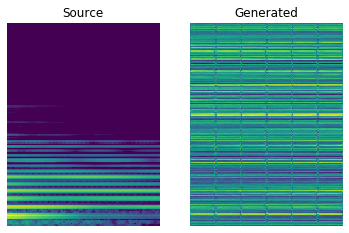

Mean D loss: 0.0 Mean G loss: 1.7752858400344849 Mean ID loss: 0.4710932672023773
[Epoch 1/5000] [Batch 0] [D loss f: 0.0 r: 0.0] [G loss: 1.7523225545883179] [ID loss: 0.4747678339481354] [LR: 0.0002]
Time/Batch 0.04280576705932617
Mean D loss: 0.0 Mean G loss: 1.61199152469635 Mean ID loss: 0.4647958278656006
[Epoch 2/5000] [Batch 0] [D loss f: 0.0 r: 0.0] [G loss: 1.5982604026794434] [ID loss: 0.47197452187538147] [LR: 0.0002]
Time/Batch 0.03691730499267578
Mean D loss: 0.0 Mean G loss: 1.5702147483825684 Mean ID loss: 0.47701287269592285
[Epoch 3/5000] [Batch 0] [D loss f: 0.0 r: 0.0] [G loss: 1.5606708526611328] [ID loss: 0.47437286376953125] [LR: 0.0002]
Time/Batch 0.03738703727722168
Mean D loss: 0.0 Mean G loss: 1.4774004220962524 Mean ID loss: 0.476065069437027
[Epoch 4/5000] [Batch 0] [D loss f: 0.0 r: 0.0] [G loss: 1.4752130508422852] [ID loss: 0.46976396441459656] [LR: 0.0002]
Time/Batch 0.03738903999328613
Mean D loss: 0.0 Mean G loss: 1.4649089574813843 Mean ID loss: 0.47

  2%|▏         | 40/2000 [00:00<00:03, 648.62it/s, loss=0.0149, spectral_convergence=-.322] 

Time/Batch 0.03659920692443848
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 810.32it/s, loss=3.11e-5, spectral_convergence=-33.4]


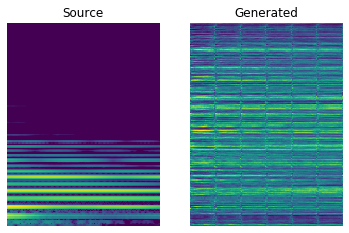

Mean D loss: 0.02998650074005127 Mean G loss: 1.7292522192001343 Mean ID loss: 0.3063448965549469
[Epoch 51/5000] [Batch 0] [D loss f: 0.02998650074005127 r: 0.00276888906955719] [G loss: 1.7545208930969238] [ID loss: 0.30410513281822205] [LR: 0.0002]
Time/Batch 0.043496227264404295
Mean D loss: 0.0042673456482589245 Mean G loss: 2.0817785263061523 Mean ID loss: 0.31123605370521545
[Epoch 52/5000] [Batch 0] [D loss f: 0.0042673456482589245 r: 0.00033765845000743866] [G loss: 1.9617687463760376] [ID loss: 0.31789034605026245] [LR: 0.0002]
Time/Batch 0.03646340370178223
Mean D loss: 0.4373825490474701 Mean G loss: 1.826163411140442 Mean ID loss: 0.294456422328949
[Epoch 53/5000] [Batch 0] [D loss f: 0.4541577100753784 r: 0.061647091060876846] [G loss: 1.8766989707946777] [ID loss: 0.28866639733314514] [LR: 0.0002]
Time/Batch 0.036589527130126955
Mean D loss: 0.02639148384332657 Mean G loss: 1.7705825567245483 Mean ID loss: 0.2934975326061249
[Epoch 54/5000] [Batch 0] [D loss f: 0.0096163

  2%|▏         | 40/2000 [00:00<00:02, 658.32it/s, loss=0.00404, spectral_convergence=-3.65]

Time/Batch 0.03653907775878906
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 739.50it/s, loss=5.17e-5, spectral_convergence=-19.8]


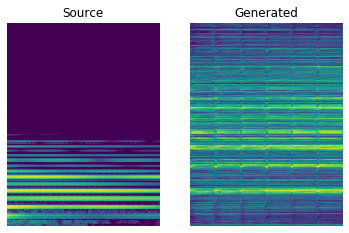

Mean D loss: 0.02921930141746998 Mean G loss: 1.848746657371521 Mean ID loss: 0.2227316051721573
[Epoch 101/5000] [Batch 0] [D loss f: 0.19890277087688446 r: 0.1537647247314453] [G loss: 1.5014010667800903] [ID loss: 0.222306489944458] [LR: 0.0002]
Time/Batch 0.04291443824768067
Mean D loss: 0.4111032783985138 Mean G loss: 0.46794524788856506 Mean ID loss: 0.23869366943836212
[Epoch 102/5000] [Batch 0] [D loss f: 0.24141980707645416 r: 0.17331284284591675] [G loss: 0.8178792595863342] [ID loss: 0.23592545092105865] [LR: 0.0002]
Time/Batch 0.03936305046081543
Mean D loss: 0.23714083433151245 Mean G loss: 2.3399059772491455 Mean ID loss: 0.22226476669311523
[Epoch 103/5000] [Batch 0] [D loss f: 0.23714083433151245 r: 0.1314045935869217] [G loss: 2.3958425521850586] [ID loss: 0.22028474509716034] [LR: 0.0002]
Time/Batch 0.0393918514251709
Mean D loss: 0.03659648075699806 Mean G loss: 2.1543796062469482 Mean ID loss: 0.20167969167232513
[Epoch 104/5000] [Batch 0] [D loss f: 0.0365964807569

  2%|▏         | 40/2000 [00:00<00:03, 612.11it/s, loss=0.0176, spectral_convergence=-.867]

Time/Batch 0.03681478500366211
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 816.60it/s, loss=0.000923, spectral_convergence=-29.1]


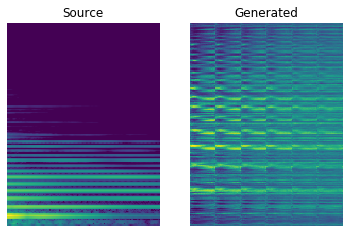

Mean D loss: 0.057406891137361526 Mean G loss: 1.873021125793457 Mean ID loss: 0.25666120648384094
[Epoch 151/5000] [Batch 0] [D loss f: 0.04754667356610298 r: 0.02447410114109516] [G loss: 1.9917550086975098] [ID loss: 0.25766387581825256] [LR: 0.0002]
Time/Batch 0.04343547821044922
Mean D loss: 0.04727066680788994 Mean G loss: 1.552437424659729 Mean ID loss: 0.2739073634147644
[Epoch 152/5000] [Batch 0] [D loss f: 0.04727066680788994 r: 0.018406933173537254] [G loss: 1.4854871034622192] [ID loss: 0.2712192237377167] [LR: 0.0002]
Time/Batch 0.037801265716552734
Mean D loss: 0.10402978211641312 Mean G loss: 0.9867684245109558 Mean ID loss: 0.23806756734848022
[Epoch 153/5000] [Batch 0] [D loss f: 0.10402978211641312 r: 0.063027523458004] [G loss: 1.056735634803772] [ID loss: 0.2385186403989792] [LR: 0.0002]
Time/Batch 0.037015867233276364
Mean D loss: 0.003912323620170355 Mean G loss: 2.307931423187256 Mean ID loss: 0.24165470898151398
[Epoch 154/5000] [Batch 0] [D loss f: 0.0039643500

  2%|▏         | 40/2000 [00:00<00:03, 612.41it/s, loss=0.000339, spectral_convergence=-8.27]

Time/Batch 0.03782486915588379
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 853.38it/s, loss=4.51e-5, spectral_convergence=-27.5]


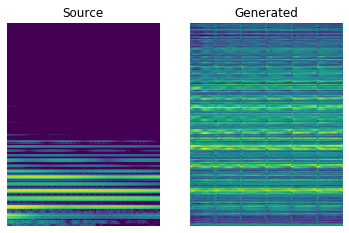

Mean D loss: 0.05181080102920532 Mean G loss: 1.6089588403701782 Mean ID loss: 0.2441994696855545
[Epoch 201/5000] [Batch 0] [D loss f: 0.06711000949144363 r: 0.022809959948062897] [G loss: 1.4686131477355957] [ID loss: 0.2433588057756424] [LR: 0.0002]
Time/Batch 0.042263364791870116
Mean D loss: 0.36725035309791565 Mean G loss: 0.5223575234413147 Mean ID loss: 0.23538227379322052
[Epoch 202/5000] [Batch 0] [D loss f: 0.35195115208625793 r: 0.20252007246017456] [G loss: 0.6985991597175598] [ID loss: 0.23225624859333038] [LR: 0.0002]
Time/Batch 0.03685851097106933
Mean D loss: 0.171825110912323 Mean G loss: 1.8033132553100586 Mean ID loss: 0.2082739919424057
[Epoch 203/5000] [Batch 0] [D loss f: 0.20315861701965332 r: 0.061012256890535355] [G loss: 1.6490215063095093] [ID loss: 0.2147553414106369] [LR: 0.0002]
Time/Batch 0.03713512420654297
Mean D loss: 0.11354925483465195 Mean G loss: 1.2521216869354248 Mean ID loss: 0.2709134519100189
[Epoch 204/5000] [Batch 0] [D loss f: 0.1016696393

  2%|▏         | 40/2000 [00:00<00:03, 637.85it/s, loss=0.0103, spectral_convergence=-1.37] 

Time/Batch 0.037047719955444335
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 859.63it/s, loss=3.63e-5, spectral_convergence=-14.5]


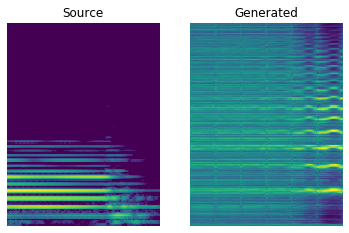

Mean D loss: 0.4653882086277008 Mean G loss: 0.7631930708885193 Mean ID loss: 0.2810758650302887
[Epoch 251/5000] [Batch 0] [D loss f: 0.32958292961120605 r: 0.11979040503501892] [G loss: 1.0058220624923706] [ID loss: 0.27456000447273254] [LR: 0.0002]
Time/Batch 0.04046363830566406
Mean D loss: 0.18507450819015503 Mean G loss: 1.2717286348342896 Mean ID loss: 0.25298675894737244
[Epoch 252/5000] [Batch 0] [D loss f: 0.18847380578517914 r: 0.0670342817902565] [G loss: 1.244677186012268] [ID loss: 0.25887802243232727] [LR: 0.0002]
Time/Batch 0.03675165176391602
Mean D loss: 0.3048642575740814 Mean G loss: 1.2349566221237183 Mean ID loss: 0.2968813478946686
[Epoch 253/5000] [Batch 0] [D loss f: 0.39746928215026855 r: 0.12353399395942688] [G loss: 1.0599052906036377] [ID loss: 0.2937430441379547] [LR: 0.0002]
Time/Batch 0.036796188354492186
Mean D loss: 0.24744564294815063 Mean G loss: 0.7179193496704102 Mean ID loss: 0.2641838788986206
[Epoch 254/5000] [Batch 0] [D loss f: 0.1537759751081

  2%|▏         | 30/2000 [00:00<00:03, 586.14it/s, loss=0.000261, spectral_convergence=-7.01]

Time/Batch 0.036913156509399414
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 766.80it/s, loss=1.98e-5, spectral_convergence=-30.7]


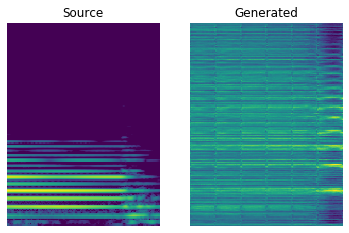

Mean D loss: 0.15089726448059082 Mean G loss: 1.008362889289856 Mean ID loss: 0.27494531869888306
[Epoch 301/5000] [Batch 0] [D loss f: 0.1077672466635704 r: 0.04929795861244202] [G loss: 1.0799392461776733] [ID loss: 0.2785402238368988] [LR: 0.0002]
Time/Batch 0.043256187438964845
Mean D loss: 0.17679186165332794 Mean G loss: 0.9909817576408386 Mean ID loss: 0.2884500324726105
[Epoch 302/5000] [Batch 0] [D loss f: 0.22977302968502045 r: 0.09758470207452774] [G loss: 0.901694118976593] [ID loss: 0.2854480445384979] [LR: 0.0002]
Time/Batch 0.03850951194763184
Mean D loss: 0.2734846770763397 Mean G loss: 1.0938361883163452 Mean ID loss: 0.2882098853588104
[Epoch 303/5000] [Batch 0] [D loss f: 0.2676350176334381 r: 0.14271575212478638] [G loss: 1.1103978157043457] [ID loss: 0.28938040137290955] [LR: 0.0002]
Time/Batch 0.03783702850341797
Mean D loss: 0.26923155784606934 Mean G loss: 0.7179436087608337 Mean ID loss: 0.3100215494632721
[Epoch 304/5000] [Batch 0] [D loss f: 0.224426984786987

  0%|          | 10/2000 [00:00<00:06, 291.42it/s, loss=0.00204, spectral_convergence=-.968]

Time/Batch 0.0372525691986084
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 837.30it/s, loss=8.83e-6, spectral_convergence=-35.7]


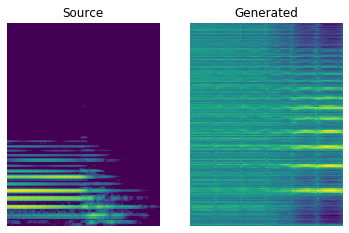

Mean D loss: 0.30157041549682617 Mean G loss: 1.1280454397201538 Mean ID loss: 0.27651000022888184
[Epoch 351/5000] [Batch 0] [D loss f: 0.44184088706970215 r: 0.11625150591135025] [G loss: 0.951894223690033] [ID loss: 0.27363625168800354] [LR: 0.0002]
Time/Batch 0.04250445365905762
Mean D loss: 0.5667043924331665 Mean G loss: 0.5727211833000183 Mean ID loss: 0.28484782576560974
[Epoch 352/5000] [Batch 0] [D loss f: 0.47310855984687805 r: 0.1273004710674286] [G loss: 0.6663169860839844] [ID loss: 0.29119446873664856] [LR: 0.0002]
Time/Batch 0.03699140548706055
Mean D loss: 0.16806256771087646 Mean G loss: 0.8584408760070801 Mean ID loss: 0.2833903729915619
[Epoch 353/5000] [Batch 0] [D loss f: 0.19131000339984894 r: 0.13446657359600067] [G loss: 0.8513098359107971] [ID loss: 0.28016743063926697] [LR: 0.0002]
Time/Batch 0.03651866912841797
Mean D loss: 0.28627809882164 Mean G loss: 0.6564265489578247 Mean ID loss: 0.28923672437667847
[Epoch 354/5000] [Batch 0] [D loss f: 0.3126925528049

  2%|▏         | 30/2000 [00:00<00:03, 567.53it/s, loss=0.000172, spectral_convergence=-7.21]

Time/Batch 0.037027597427368164
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 833.15it/s, loss=2.4e-5, spectral_convergence=-18.3] 


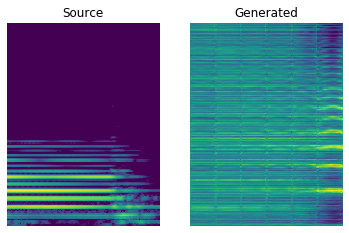

Mean D loss: 0.47621846199035645 Mean G loss: 0.44367489218711853 Mean ID loss: 0.31952810287475586
[Epoch 401/5000] [Batch 0] [D loss f: 0.48290860652923584 r: 0.15637578070163727] [G loss: 0.4506780803203583] [ID loss: 0.3235767185688019] [LR: 0.0002]
Time/Batch 0.042882251739501956
Mean D loss: 0.3148821294307709 Mean G loss: 0.661508321762085 Mean ID loss: 0.3096015155315399
[Epoch 402/5000] [Batch 0] [D loss f: 0.24932296574115753 r: 0.10344672203063965] [G loss: 0.7233861088752747] [ID loss: 0.3030429780483246] [LR: 0.0002]
Time/Batch 0.03664383888244629
Mean D loss: 0.17995776236057281 Mean G loss: 0.9124307632446289 Mean ID loss: 0.320814847946167
[Epoch 403/5000] [Batch 0] [D loss f: 0.18147949874401093 r: 0.04431753233075142] [G loss: 0.9295061230659485] [ID loss: 0.3192569315433502] [LR: 0.0002]
Time/Batch 0.03668026924133301
Mean D loss: 0.18932116031646729 Mean G loss: 0.9085164070129395 Mean ID loss: 0.2867668569087982
[Epoch 404/5000] [Batch 0] [D loss f: 0.2040058821439

  2%|▏         | 40/2000 [00:00<00:03, 645.97it/s, loss=0.000132, spectral_convergence=-11.5]

Time/Batch 0.03678445816040039
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 853.57it/s, loss=3.14e-5, spectral_convergence=-15.5]


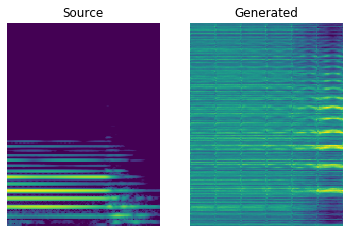

Mean D loss: 0.29502636194229126 Mean G loss: 0.82631915807724 Mean ID loss: 0.2666448652744293
[Epoch 451/5000] [Batch 0] [D loss f: 0.29852020740509033 r: 0.14326786994934082] [G loss: 0.8268736004829407] [ID loss: 0.2698693573474884] [LR: 0.0002]
Time/Batch 0.04224720001220703
Mean D loss: 0.2647309899330139 Mean G loss: 0.7444046139717102 Mean ID loss: 0.28186142444610596
[Epoch 452/5000] [Batch 0] [D loss f: 0.24193328619003296 r: 0.1043916642665863] [G loss: 0.7662692070007324] [ID loss: 0.27960073947906494] [LR: 0.0002]
Time/Batch 0.036862421035766604
Mean D loss: 0.22081218659877777 Mean G loss: 0.8133630752563477 Mean ID loss: 0.28166279196739197
[Epoch 453/5000] [Batch 0] [D loss f: 0.24427099525928497 r: 0.059617217630147934] [G loss: 0.8015058040618896] [ID loss: 0.27872195839881897] [LR: 0.0002]
Time/Batch 0.036653995513916016
Mean D loss: 0.3880256414413452 Mean G loss: 0.6245743632316589 Mean ID loss: 0.2654089033603668
[Epoch 454/5000] [Batch 0] [D loss f: 0.37073865532

  2%|▏         | 40/2000 [00:00<00:02, 673.18it/s, loss=4.36e-5, spectral_convergence=-11.4]

Time/Batch 0.03695988655090332
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 872.40it/s, loss=8.46e-5, spectral_convergence=-21.9] 


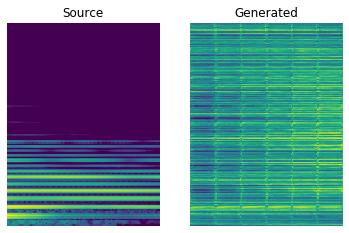

Mean D loss: 0.7656815052032471 Mean G loss: 0.28990408778190613 Mean ID loss: 0.2547667622566223
[Epoch 501/5000] [Batch 0] [D loss f: 0.7923501133918762 r: 0.13019923865795135] [G loss: 0.2663637399673462] [ID loss: 0.26089951395988464] [LR: 0.0002]
Time/Batch 0.04217429161071777
Mean D loss: 0.48561692237854004 Mean G loss: 0.6932559609413147 Mean ID loss: 0.2804535925388336
[Epoch 502/5000] [Batch 0] [D loss f: 0.43702974915504456 r: 0.148561492562294] [G loss: 0.7616521716117859] [ID loss: 0.2745479345321655] [LR: 0.0002]
Time/Batch 0.036559534072875974
Mean D loss: 0.6049814820289612 Mean G loss: 0.6271939873695374 Mean ID loss: 0.2805652916431427
[Epoch 503/5000] [Batch 0] [D loss f: 0.6736555695533752 r: 0.07221139222383499] [G loss: 0.5355826020240784] [ID loss: 0.28209659457206726] [LR: 0.0002]
Time/Batch 0.036883306503295896
Mean D loss: 0.4088186025619507 Mean G loss: 0.5830326080322266 Mean ID loss: 0.267120361328125
[Epoch 504/5000] [Batch 0] [D loss f: 0.4178276956081390

  2%|▏         | 40/2000 [00:00<00:02, 661.58it/s, loss=2.41e-5, spectral_convergence=-11.3]

Time/Batch 0.03682260513305664
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 848.90it/s, loss=0.000953, spectral_convergence=-37]  


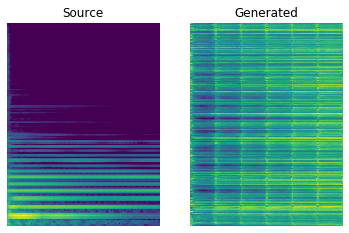

Mean D loss: 0.31964007019996643 Mean G loss: 1.019791841506958 Mean ID loss: 0.25120022892951965
[Epoch 551/5000] [Batch 0] [D loss f: 0.31939026713371277 r: 0.22243404388427734] [G loss: 1.1192694902420044] [ID loss: 0.25070828199386597] [LR: 0.0002]
Time/Batch 0.040722894668579104
Mean D loss: 0.7004626393318176 Mean G loss: 1.0158528089523315 Mean ID loss: 0.24720565974712372
[Epoch 552/5000] [Batch 0] [D loss f: 0.8138133883476257 r: 0.06794092804193497] [G loss: 0.7537881731987] [ID loss: 0.25093743205070496] [LR: 0.0002]
Time/Batch 0.036938953399658206
Mean D loss: 0.6715316772460938 Mean G loss: 0.8867972493171692 Mean ID loss: 0.2790355980396271
[Epoch 553/5000] [Batch 0] [D loss f: 0.7222972512245178 r: 0.1317259967327118] [G loss: 0.8360317349433899] [ID loss: 0.27899250388145447] [LR: 0.0002]
Time/Batch 0.03664321899414062
Mean D loss: 0.7666316628456116 Mean G loss: 0.18452072143554688 Mean ID loss: 0.2460176795721054
[Epoch 554/5000] [Batch 0] [D loss f: 0.690037727355957

  2%|▏         | 40/2000 [00:00<00:02, 671.96it/s, loss=2.35e-5, spectral_convergence=-11.2]

Time/Batch 0.03687915802001953
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 866.81it/s, loss=0.000567, spectral_convergence=-14.1]


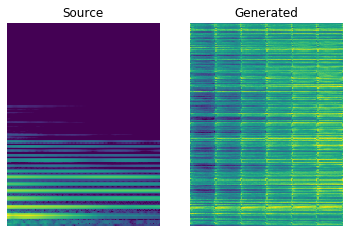

Mean D loss: 0.551832914352417 Mean G loss: 0.746891975402832 Mean ID loss: 0.21924395859241486
[Epoch 601/5000] [Batch 0] [D loss f: 0.5014472007751465 r: 0.16619250178337097] [G loss: 0.7972775101661682] [ID loss: 0.22036243975162506] [LR: 0.0002]
Time/Batch 0.042617416381835936
Mean D loss: 0.428002268075943 Mean G loss: 0.5144146084785461 Mean ID loss: 0.23949585855007172
[Epoch 602/5000] [Batch 0] [D loss f: 0.35247281193733215 r: 0.22879981994628906] [G loss: 0.6043745279312134] [ID loss: 0.23542828857898712] [LR: 0.0002]
Time/Batch 0.03706603050231934
Mean D loss: 0.3759060800075531 Mean G loss: 1.3016371726989746 Mean ID loss: 0.2202565222978592
[Epoch 603/5000] [Batch 0] [D loss f: 0.4509906768798828 r: 0.13043342530727386] [G loss: 1.2121220827102661] [ID loss: 0.2214030623435974] [LR: 0.0002]
Time/Batch 0.03668222427368164
Mean D loss: 0.38747164607048035 Mean G loss: 0.6720192432403564 Mean ID loss: 0.2216508388519287
[Epoch 604/5000] [Batch 0] [D loss f: 0.3154123723506927

  2%|▎         | 50/2000 [00:00<00:02, 702.60it/s, loss=2.63e-5, spectral_convergence=-11.9]

Time/Batch 0.03676185607910156
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 850.97it/s, loss=0.000144, spectral_convergence=-15.4]


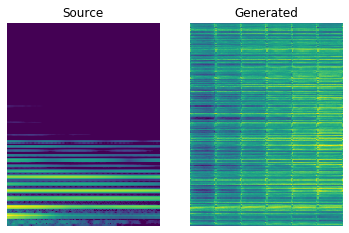

Mean D loss: 0.23254622519016266 Mean G loss: 1.0490151643753052 Mean ID loss: 0.22943060100078583
[Epoch 651/5000] [Batch 0] [D loss f: 0.22096161544322968 r: 0.06805874407291412] [G loss: 1.0876957178115845] [ID loss: 0.23278816044330597] [LR: 0.0002]
Time/Batch 0.040852594375610354
Mean D loss: 0.4616208076477051 Mean G loss: 1.2021855115890503 Mean ID loss: 0.22335290908813477
[Epoch 652/5000] [Batch 0] [D loss f: 0.5648016929626465 r: 0.13909514248371124] [G loss: 1.0641356706619263] [ID loss: 0.22488440573215485] [LR: 0.0002]
Time/Batch 0.03678064346313477
Mean D loss: 0.40508344769477844 Mean G loss: 0.43527570366859436 Mean ID loss: 0.2250739187002182
[Epoch 653/5000] [Batch 0] [D loss f: 0.3245610296726227 r: 0.1358126550912857] [G loss: 0.5185839533805847] [ID loss: 0.22226683795452118] [LR: 0.0002]
Time/Batch 0.0366973876953125
Mean D loss: 0.3644193708896637 Mean G loss: 0.9766612648963928 Mean ID loss: 0.21233201026916504
[Epoch 654/5000] [Batch 0] [D loss f: 0.39469245076

  2%|▏         | 30/2000 [00:00<00:03, 610.04it/s, loss=1.28e-5, spectral_convergence=-11.3]

Time/Batch 0.03703322410583496
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 862.06it/s, loss=0.00091, spectral_convergence=-37.4] 


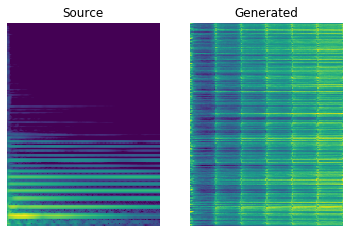

Mean D loss: 0.3698151111602783 Mean G loss: 0.5319631099700928 Mean ID loss: 0.22172461450099945
[Epoch 701/5000] [Batch 0] [D loss f: 0.31444844603538513 r: 0.166939377784729] [G loss: 0.5882551074028015] [ID loss: 0.22146785259246826] [LR: 0.0002]
Time/Batch 0.0423790454864502
Mean D loss: 0.4069240391254425 Mean G loss: 0.9280806183815002 Mean ID loss: 0.20731645822525024
[Epoch 702/5000] [Batch 0] [D loss f: 0.4005871117115021 r: 0.1912440061569214] [G loss: 0.9563953876495361] [ID loss: 0.21098756790161133] [LR: 0.0002]
Time/Batch 0.03705639839172363
Mean D loss: 0.3270885646343231 Mean G loss: 1.1572643518447876 Mean ID loss: 0.22161896526813507
[Epoch 703/5000] [Batch 0] [D loss f: 0.3808344602584839 r: 0.1111060157418251] [G loss: 1.0809516906738281] [ID loss: 0.21986402571201324] [LR: 0.0002]
Time/Batch 0.03674325942993164
Mean D loss: 0.218659445643425 Mean G loss: 0.8050915598869324 Mean ID loss: 0.21494698524475098
[Epoch 704/5000] [Batch 0] [D loss f: 0.15110920369625092 

  2%|▎         | 50/2000 [00:00<00:02, 696.20it/s, loss=1e-5, spectral_convergence=-11.9]   

Time/Batch 0.03679437637329101
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 855.91it/s, loss=0.000776, spectral_convergence=-33.7]


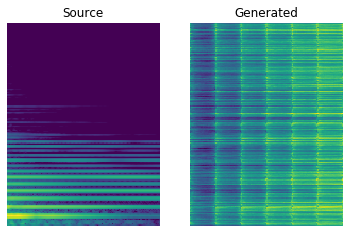

Mean D loss: 0.30595386028289795 Mean G loss: 0.5390786528587341 Mean ID loss: 0.21486319601535797
[Epoch 751/5000] [Batch 0] [D loss f: 0.2505594789981842 r: 0.12577800452709198] [G loss: 0.6047435402870178] [ID loss: 0.2148827314376831] [LR: 0.0002]
Time/Batch 0.04260034561157226
Mean D loss: 0.3306705355644226 Mean G loss: 0.7403892874717712 Mean ID loss: 0.21822942793369293
[Epoch 752/5000] [Batch 0] [D loss f: 0.34503817558288574 r: 0.10639431327581406] [G loss: 0.7170600891113281] [ID loss: 0.21841101348400116] [LR: 0.0002]
Time/Batch 0.03686800003051758
Mean D loss: 0.18812888860702515 Mean G loss: 0.8724524974822998 Mean ID loss: 0.21933989226818085
[Epoch 753/5000] [Batch 0] [D loss f: 0.18780331313610077 r: 0.17672497034072876] [G loss: 0.8714690208435059] [ID loss: 0.22618591785430908] [LR: 0.0002]
Time/Batch 0.03668179512023926
Mean D loss: 0.19281943142414093 Mean G loss: 0.8219959139823914 Mean ID loss: 0.2487267702817917
[Epoch 754/5000] [Batch 0] [D loss f: 0.1500485539

  2%|▏         | 40/2000 [00:00<00:02, 657.21it/s, loss=2.15e-5, spectral_convergence=-12.4]

Time/Batch 0.03701467514038086
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 843.76it/s, loss=3.46e-5, spectral_convergence=-34.1]


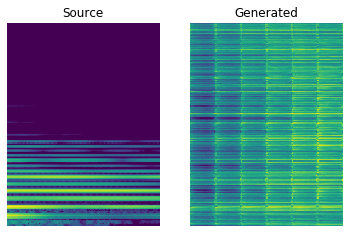

Mean D loss: 0.16315576434135437 Mean G loss: 0.8438482880592346 Mean ID loss: 0.21983863413333893
[Epoch 801/5000] [Batch 0] [D loss f: 0.22231505811214447 r: 0.11927022784948349] [G loss: 0.7809260487556458] [ID loss: 0.21720518171787262] [LR: 0.0002]
Time/Batch 0.041540002822875975
Mean D loss: 0.4134353697299957 Mean G loss: 0.5121293663978577 Mean ID loss: 0.21200640499591827
[Epoch 802/5000] [Batch 0] [D loss f: 0.3743605613708496 r: 0.10751444101333618] [G loss: 0.5512053966522217] [ID loss: 0.21277345716953278] [LR: 0.0002]
Time/Batch 0.03736791610717773
Mean D loss: 0.25222471356391907 Mean G loss: 0.7792972922325134 Mean ID loss: 0.20757867395877838
[Epoch 803/5000] [Batch 0] [D loss f: 0.24676282703876495 r: 0.20267248153686523] [G loss: 0.7870014309883118] [ID loss: 0.20903201401233673] [LR: 0.0002]
Time/Batch 0.037205076217651366
Mean D loss: 0.24130327999591827 Mean G loss: 0.8736600279808044 Mean ID loss: 0.21479465067386627
[Epoch 804/5000] [Batch 0] [D loss f: 0.216915

  2%|▏         | 40/2000 [00:00<00:03, 618.80it/s, loss=2.13e-5, spectral_convergence=-12.2]

Time/Batch 0.03707413673400879
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 859.08it/s, loss=3.74e-5, spectral_convergence=-20.1]


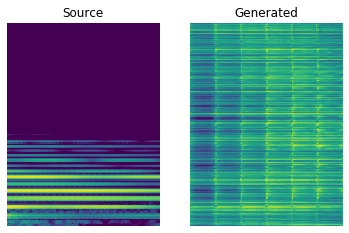

Mean D loss: 0.23755402863025665 Mean G loss: 0.6771213412284851 Mean ID loss: 0.23153071105480194
[Epoch 851/5000] [Batch 0] [D loss f: 0.27476397156715393 r: 0.23235847055912018] [G loss: 0.6399113535881042] [ID loss: 0.22552929818630219] [LR: 0.0002]
Time/Batch 0.04258718490600586
Mean D loss: 0.33031395077705383 Mean G loss: 0.7790717482566833 Mean ID loss: 0.21126528084278107
[Epoch 852/5000] [Batch 0] [D loss f: 0.3021189570426941 r: 0.12978214025497437] [G loss: 0.8073621392250061] [ID loss: 0.2113959938287735] [LR: 0.0002]
Time/Batch 0.03744630813598633
Mean D loss: 0.1950855255126953 Mean G loss: 0.8363944888114929 Mean ID loss: 0.2123579978942871
[Epoch 853/5000] [Batch 0] [D loss f: 0.1820007711648941 r: 0.08019473403692245] [G loss: 0.8503892421722412] [ID loss: 0.21059739589691162] [LR: 0.0002]
Time/Batch 0.037199544906616214
Mean D loss: 0.2921699583530426 Mean G loss: 0.6941946148872375 Mean ID loss: 0.20103318989276886
[Epoch 854/5000] [Batch 0] [D loss f: 0.29676482081

  2%|▏         | 40/2000 [00:00<00:03, 635.50it/s, loss=2.45e-5, spectral_convergence=-11.9]

Time/Batch 0.03705000877380371
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 853.52it/s, loss=2.57e-5, spectral_convergence=-33.1]


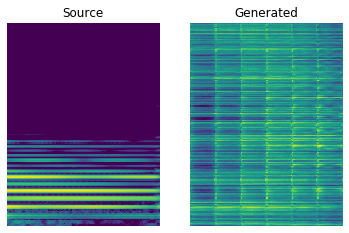

Mean D loss: 0.21481232345104218 Mean G loss: 1.1590256690979004 Mean ID loss: 0.22927068173885345
[Epoch 901/5000] [Batch 0] [D loss f: 0.2227528691291809 r: 0.07608625292778015] [G loss: 1.151402235031128] [ID loss: 0.22371643781661987] [LR: 0.0002]
Time/Batch 0.04261517524719238
Mean D loss: 0.3555796444416046 Mean G loss: 0.7181534767150879 Mean ID loss: 0.22228014469146729
[Epoch 902/5000] [Batch 0] [D loss f: 0.37785086035728455 r: 0.15311314165592194] [G loss: 0.6717273592948914] [ID loss: 0.2202613353729248] [LR: 0.0002]
Time/Batch 0.037061452865600586
Mean D loss: 0.23125994205474854 Mean G loss: 0.8033257126808167 Mean ID loss: 0.21295303106307983
[Epoch 903/5000] [Batch 0] [D loss f: 0.24488668143749237 r: 0.07874932140111923] [G loss: 0.7885856032371521] [ID loss: 0.2132449895143509] [LR: 0.0002]
Time/Batch 0.03685693740844727
Mean D loss: 0.24465321004390717 Mean G loss: 0.6644352674484253 Mean ID loss: 0.20699866116046906
[Epoch 904/5000] [Batch 0] [D loss f: 0.2309724092

  2%|▏         | 40/2000 [00:00<00:03, 614.65it/s, loss=1.03e-5, spectral_convergence=-11.9]

Time/Batch 0.03706135749816895
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 856.82it/s, loss=0.000216, spectral_convergence=-23.8]


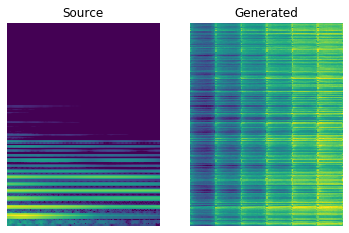

Mean D loss: 0.22994981706142426 Mean G loss: 0.9013707041740417 Mean ID loss: 0.21704261004924774
[Epoch 951/5000] [Batch 0] [D loss f: 0.21441447734832764 r: 0.05198587849736214] [G loss: 0.9145305752754211] [ID loss: 0.21341289579868317] [LR: 0.0002]
Time/Batch 0.04274301528930664
Mean D loss: 0.2906886041164398 Mean G loss: 0.7274906635284424 Mean ID loss: 0.199299156665802
[Epoch 952/5000] [Batch 0] [D loss f: 0.30142003297805786 r: 0.12857291102409363] [G loss: 0.7351949214935303] [ID loss: 0.1995658427476883] [LR: 0.0002]
Time/Batch 0.03727235794067383
Mean D loss: 0.2368670105934143 Mean G loss: 1.046676754951477 Mean ID loss: 0.19915235042572021
[Epoch 953/5000] [Batch 0] [D loss f: 0.22371326386928558 r: 0.09037142992019653] [G loss: 1.0784344673156738] [ID loss: 0.19935864210128784] [LR: 0.0002]
Time/Batch 0.037135887145996097
Mean D loss: 0.20777614414691925 Mean G loss: 1.192954421043396 Mean ID loss: 0.2049068808555603
[Epoch 954/5000] [Batch 0] [D loss f: 0.2250234037637

  2%|▏         | 40/2000 [00:00<00:02, 689.06it/s, loss=1.64e-5, spectral_convergence=-12.1]

Time/Batch 0.03698673248291016
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 849.18it/s, loss=8.08e-5, spectral_convergence=-15.5] 


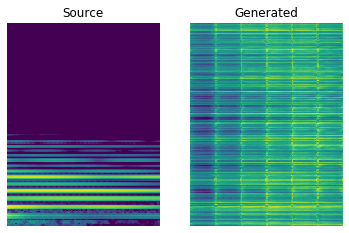

Mean D loss: 0.14587174355983734 Mean G loss: 1.0011976957321167 Mean ID loss: 0.2002958506345749
[Epoch 1001/5000] [Batch 0] [D loss f: 0.13348376750946045 r: 0.1354517936706543] [G loss: 1.0042141675949097] [ID loss: 0.20212960243225098] [LR: 0.0002]
Time/Batch 0.04287075996398926
Mean D loss: 0.19330553710460663 Mean G loss: 0.8024740815162659 Mean ID loss: 0.20155401527881622
[Epoch 1002/5000] [Batch 0] [D loss f: 0.22832535207271576 r: 0.10635673254728317] [G loss: 0.7619597911834717] [ID loss: 0.20310378074645996] [LR: 0.0002]
Time/Batch 0.03717021942138672
Mean D loss: 0.20744208991527557 Mean G loss: 0.787552535533905 Mean ID loss: 0.21145589649677277
[Epoch 1003/5000] [Batch 0] [D loss f: 0.176222026348114 r: 0.08299959450960159] [G loss: 0.8268015384674072] [ID loss: 0.20733016729354858] [LR: 0.0002]
Time/Batch 0.03684840202331543
Mean D loss: 0.16882793605327606 Mean G loss: 1.0074177980422974 Mean ID loss: 0.1975879818201065
[Epoch 1004/5000] [Batch 0] [D loss f: 0.16945169

  2%|▎         | 50/2000 [00:00<00:02, 701.95it/s, loss=2.16e-5, spectral_convergence=-12.9]

Time/Batch 0.03681960105895996
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 858.56it/s, loss=5.86e-5, spectral_convergence=-15]  


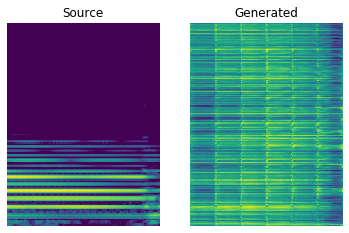

Mean D loss: 0.1988443285226822 Mean G loss: 1.045976161956787 Mean ID loss: 0.19415117800235748
[Epoch 1051/5000] [Batch 0] [D loss f: 0.23876692354679108 r: 0.07534679025411606] [G loss: 0.9674704670906067] [ID loss: 0.19444651901721954] [LR: 0.0002]
Time/Batch 0.042896270751953125
Mean D loss: 0.12304139882326126 Mean G loss: 0.8616805076599121 Mean ID loss: 0.19669492542743683
[Epoch 1052/5000] [Batch 0] [D loss f: 0.12174346297979355 r: 0.09090068191289902] [G loss: 0.862978458404541] [ID loss: 0.1958618015050888] [LR: 0.0002]
Time/Batch 0.03703398704528808
Mean D loss: 0.09982430934906006 Mean G loss: 0.8879179954528809 Mean ID loss: 0.1997540146112442
[Epoch 1053/5000] [Batch 0] [D loss f: 0.06351948529481888 r: 0.09534299373626709] [G loss: 0.93916255235672] [ID loss: 0.19987636804580688] [LR: 0.0002]
Time/Batch 0.036640501022338866
Mean D loss: 0.15124720335006714 Mean G loss: 0.9517150521278381 Mean ID loss: 0.19750039279460907
[Epoch 1054/5000] [Batch 0] [D loss f: 0.1798065

  2%|▏         | 40/2000 [00:00<00:03, 632.76it/s, loss=0.000195, spectral_convergence=-10.1]

Time/Batch 0.036872577667236325
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 843.97it/s, loss=1.02e-5, spectral_convergence=-33.7]


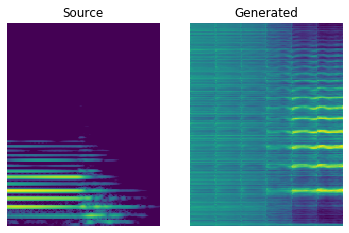

Mean D loss: 0.13775292038917542 Mean G loss: 1.174682378768921 Mean ID loss: 0.18606887757778168
[Epoch 1101/5000] [Batch 0] [D loss f: 0.14106862246990204 r: 0.09269833564758301] [G loss: 1.1738346815109253] [ID loss: 0.18673835694789886] [LR: 0.0002]
Time/Batch 0.04160938262939453
Mean D loss: 0.12854275107383728 Mean G loss: 0.977076530456543 Mean ID loss: 0.1872190237045288
[Epoch 1102/5000] [Batch 0] [D loss f: 0.12686695158481598 r: 0.10982046276330948] [G loss: 0.9597644209861755] [ID loss: 0.185773566365242] [LR: 0.0002]
Time/Batch 0.03679423332214356
Mean D loss: 0.20412087440490723 Mean G loss: 0.9806174635887146 Mean ID loss: 0.18689359724521637
[Epoch 1103/5000] [Batch 0] [D loss f: 0.25852730870246887 r: 0.11105378717184067] [G loss: 0.90162593126297] [ID loss: 0.1883508563041687] [LR: 0.0002]
Time/Batch 0.03687949180603027
Mean D loss: 0.19683010876178741 Mean G loss: 0.8709793090820312 Mean ID loss: 0.19033508002758026
[Epoch 1104/5000] [Batch 0] [D loss f: 0.1592787504

  2%|▏         | 40/2000 [00:00<00:03, 650.47it/s, loss=1.41e-5, spectral_convergence=-11]  

Time/Batch 0.037042760848999025
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 864.86it/s, loss=3.2e-5, spectral_convergence=-20]   


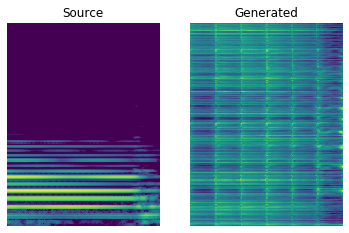

Mean D loss: 0.11263620108366013 Mean G loss: 1.0550469160079956 Mean ID loss: 0.18840955197811127
[Epoch 1151/5000] [Batch 0] [D loss f: 0.10558006912469864 r: 0.055622417479753494] [G loss: 1.083614468574524] [ID loss: 0.18882258236408234] [LR: 0.0002]
Time/Batch 0.04320368766784668
Mean D loss: 0.07017230242490768 Mean G loss: 1.0977445840835571 Mean ID loss: 0.18455380201339722
[Epoch 1152/5000] [Batch 0] [D loss f: 0.08858656883239746 r: 0.10238764435052872] [G loss: 1.0535348653793335] [ID loss: 0.18486547470092773] [LR: 0.0002]
Time/Batch 0.03711080551147461
Mean D loss: 0.11173934489488602 Mean G loss: 1.001207709312439 Mean ID loss: 0.18272912502288818
[Epoch 1153/5000] [Batch 0] [D loss f: 0.10307168960571289 r: 0.03555357828736305] [G loss: 1.0041230916976929] [ID loss: 0.1817568689584732] [LR: 0.0002]
Time/Batch 0.03693675994873047
Mean D loss: 0.062089189887046814 Mean G loss: 0.9372201561927795 Mean ID loss: 0.20171333849430084
[Epoch 1154/5000] [Batch 0] [D loss f: 0.130

  2%|▏         | 40/2000 [00:00<00:02, 656.57it/s, loss=1.21e-5, spectral_convergence=-12]  

Time/Batch 0.03698439598083496
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 853.58it/s, loss=9.95e-5, spectral_convergence=-25.7] 


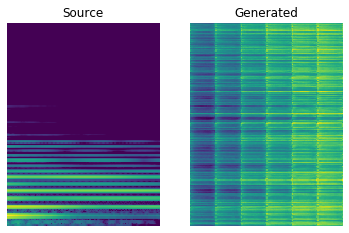

Mean D loss: 0.17273329198360443 Mean G loss: 0.8199014663696289 Mean ID loss: 0.16922758519649506
[Epoch 1201/5000] [Batch 0] [D loss f: 0.17748375236988068 r: 0.1335584968328476] [G loss: 0.834951639175415] [ID loss: 0.1680445820093155] [LR: 0.0002]
Time/Batch 0.040574169158935545
Mean D loss: 0.2087165117263794 Mean G loss: 0.9860842823982239 Mean ID loss: 0.16314597427845
[Epoch 1202/5000] [Batch 0] [D loss f: 0.223336860537529 r: 0.09918425232172012] [G loss: 0.9485630989074707] [ID loss: 0.16590356826782227] [LR: 0.0002]
Time/Batch 0.03698272705078125
Mean D loss: 0.13978813588619232 Mean G loss: 0.7941848635673523 Mean ID loss: 0.17234565317630768
[Epoch 1203/5000] [Batch 0] [D loss f: 0.17086465656757355 r: 0.11204922944307327] [G loss: 0.7566551566123962] [ID loss: 0.17127805948257446] [LR: 0.0002]
Time/Batch 0.036562633514404294
Mean D loss: 0.14764076471328735 Mean G loss: 0.8765080571174622 Mean ID loss: 0.17125262320041656
[Epoch 1204/5000] [Batch 0] [D loss f: 0.104887507

  2%|▏         | 40/2000 [00:00<00:02, 686.83it/s, loss=2.12e-5, spectral_convergence=-11.9]

Time/Batch 0.03690524101257324
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 845.69it/s, loss=2.35e-5, spectral_convergence=-29.6]


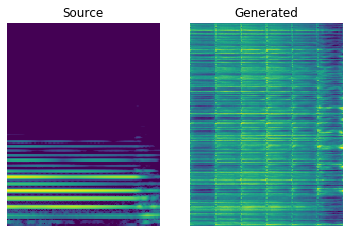

Mean D loss: 0.12321235984563828 Mean G loss: 0.7779118418693542 Mean ID loss: 0.16321872174739838
[Epoch 1251/5000] [Batch 0] [D loss f: 0.06591279059648514 r: 0.10784446448087692] [G loss: 0.8539696335792542] [ID loss: 0.16419224441051483] [LR: 0.0002]
Time/Batch 0.04223628044128418
Mean D loss: 0.10356027632951736 Mean G loss: 1.0428444147109985 Mean ID loss: 0.1666594296693802
[Epoch 1252/5000] [Batch 0] [D loss f: 0.14301879703998566 r: 0.07834801822900772] [G loss: 0.9897541403770447] [ID loss: 0.17051781713962555] [LR: 0.0002]
Time/Batch 0.0371342658996582
Mean D loss: 0.24869932234287262 Mean G loss: 1.0354552268981934 Mean ID loss: 0.17754079401493073
[Epoch 1253/5000] [Batch 0] [D loss f: 0.22132717072963715 r: 0.16851449012756348] [G loss: 1.0645302534103394] [ID loss: 0.17258302867412567] [LR: 0.0002]
Time/Batch 0.036775064468383786
Mean D loss: 0.22516292333602905 Mean G loss: 0.9475118517875671 Mean ID loss: 0.17076118290424347
[Epoch 1254/5000] [Batch 0] [D loss f: 0.229

  2%|▏         | 40/2000 [00:00<00:03, 623.96it/s, loss=4.52e-6, spectral_convergence=-9.96]

Time/Batch 0.03692750930786133
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 840.68it/s, loss=0.000573, spectral_convergence=-33.3]


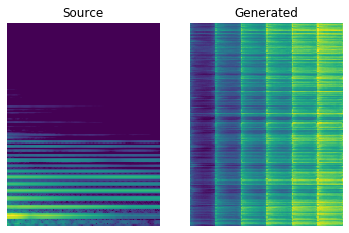

Mean D loss: 0.08177022635936737 Mean G loss: 1.0361348390579224 Mean ID loss: 0.15527494251728058
[Epoch 1301/5000] [Batch 0] [D loss f: 0.08794042468070984 r: 0.07108668237924576] [G loss: 1.0221079587936401] [ID loss: 0.15703625977039337] [LR: 0.0002]
Time/Batch 0.04232401847839355
Mean D loss: 0.11783155798912048 Mean G loss: 0.93402099609375 Mean ID loss: 0.16249334812164307
[Epoch 1302/5000] [Batch 0] [D loss f: 0.10473193973302841 r: 0.1316855400800705] [G loss: 0.9627673625946045] [ID loss: 0.16286851465702057] [LR: 0.0002]
Time/Batch 0.036916065216064456
Mean D loss: 0.13294771313667297 Mean G loss: 0.863835871219635 Mean ID loss: 0.16297726333141327
[Epoch 1303/5000] [Batch 0] [D loss f: 0.11174032092094421 r: 0.08401862531900406] [G loss: 0.9262251853942871] [ID loss: 0.1610548049211502] [LR: 0.0002]
Time/Batch 0.03683414459228516
Mean D loss: 0.19093453884124756 Mean G loss: 1.1642683744430542 Mean ID loss: 0.15249930322170258
[Epoch 1304/5000] [Batch 0] [D loss f: 0.196547

  2%|▏         | 40/2000 [00:00<00:02, 661.43it/s, loss=1.34e-5, spectral_convergence=-11.7]

Time/Batch 0.03657660484313965
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 740.71it/s, loss=5.69e-5, spectral_convergence=-21.1] 


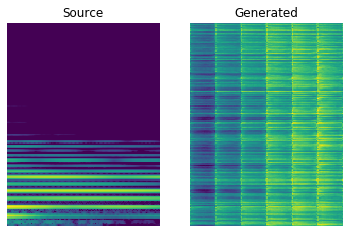

Mean D loss: 0.1738504022359848 Mean G loss: 0.8244884610176086 Mean ID loss: 0.1565275937318802
[Epoch 1351/5000] [Batch 0] [D loss f: 0.14251083135604858 r: 0.22603239119052887] [G loss: 0.8841919898986816] [ID loss: 0.1568770557641983] [LR: 0.0002]
Time/Batch 0.046488618850708006
Mean D loss: 0.1849358230829239 Mean G loss: 1.0726335048675537 Mean ID loss: 0.1489170640707016
[Epoch 1352/5000] [Batch 0] [D loss f: 0.20236165821552277 r: 0.09443512558937073] [G loss: 1.0283191204071045] [ID loss: 0.149513840675354] [LR: 0.0002]
Time/Batch 0.037428998947143556
Mean D loss: 0.08035522699356079 Mean G loss: 0.8929477334022522 Mean ID loss: 0.14779478311538696
[Epoch 1353/5000] [Batch 0] [D loss f: 0.061938513070344925 r: 0.13767236471176147] [G loss: 0.9788482785224915] [ID loss: 0.14666302502155304] [LR: 0.0002]
Time/Batch 0.03794050216674805
Mean D loss: 0.03705771639943123 Mean G loss: 1.2590926885604858 Mean ID loss: 0.14579157531261444
[Epoch 1354/5000] [Batch 0] [D loss f: 0.043353

  0%|          | 10/2000 [00:00<00:06, 300.75it/s, loss=2.03e-5, spectral_convergence=-9.11]

Time/Batch 0.03697147369384766
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 808.81it/s, loss=6.95e-5, spectral_convergence=-18.9]


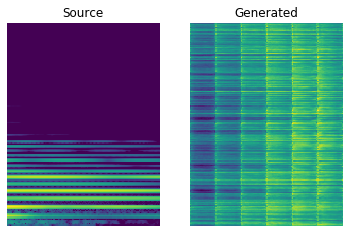

Mean D loss: 0.0871819481253624 Mean G loss: 1.0236659049987793 Mean ID loss: 0.13594655692577362
[Epoch 1401/5000] [Batch 0] [D loss f: 0.09470000118017197 r: 0.09854504466056824] [G loss: 1.0258033275604248] [ID loss: 0.1362125724554062] [LR: 0.0002]
Time/Batch 0.0440162181854248
Mean D loss: 0.06526438146829605 Mean G loss: 1.018679141998291 Mean ID loss: 0.13175493478775024
[Epoch 1402/5000] [Batch 0] [D loss f: 0.0462215393781662 r: 0.09954211115837097] [G loss: 1.0427411794662476] [ID loss: 0.13246895372867584] [LR: 0.0002]
Time/Batch 0.037369489669799805
Mean D loss: 0.1600249707698822 Mean G loss: 1.2395685911178589 Mean ID loss: 0.13103871047496796
[Epoch 1403/5000] [Batch 0] [D loss f: 0.19214807450771332 r: 0.11883097887039185] [G loss: 1.190348505973816] [ID loss: 0.13152648508548737] [LR: 0.0002]
Time/Batch 0.037204742431640625
Mean D loss: 0.1586780846118927 Mean G loss: 0.7913274765014648 Mean ID loss: 0.13442258536815643
[Epoch 1404/5000] [Batch 0] [D loss f: 0.13464830

  2%|▏         | 40/2000 [00:00<00:03, 603.68it/s, loss=2.55e-5, spectral_convergence=-12.9]

Time/Batch 0.03694405555725098
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 862.44it/s, loss=2.46e-5, spectral_convergence=-26]  


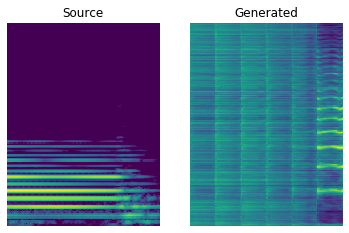

Mean D loss: 0.10259431600570679 Mean G loss: 1.263687014579773 Mean ID loss: 0.12018948793411255
[Epoch 1451/5000] [Batch 0] [D loss f: 0.11768736690282822 r: 0.11468031257390976] [G loss: 1.1965614557266235] [ID loss: 0.11873233318328857] [LR: 0.0002]
Time/Batch 0.04123940467834473
Mean D loss: 0.06607676297426224 Mean G loss: 1.09011971950531 Mean ID loss: 0.11596769094467163
[Epoch 1452/5000] [Batch 0] [D loss f: 0.06729593873023987 r: 0.10524526983499527] [G loss: 1.091619849205017] [ID loss: 0.11655499786138535] [LR: 0.0002]
Time/Batch 0.03722810745239258
Mean D loss: 0.18631137907505035 Mean G loss: 0.9678056240081787 Mean ID loss: 0.13566182553768158
[Epoch 1453/5000] [Batch 0] [D loss f: 0.24110905826091766 r: 0.1908266693353653] [G loss: 0.9003358483314514] [ID loss: 0.13626757264137268] [LR: 0.0002]
Time/Batch 0.03651442527770996
Mean D loss: 0.25059938430786133 Mean G loss: 0.5835545659065247 Mean ID loss: 0.12984125316143036
[Epoch 1454/5000] [Batch 0] [D loss f: 0.2060199

  2%|▏         | 40/2000 [00:00<00:03, 622.86it/s, loss=2.66e-6, spectral_convergence=-8.82]

Time/Batch 0.036884737014770505
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 852.03it/s, loss=0.000161, spectral_convergence=-19.3]


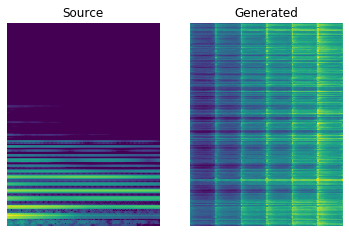

Mean D loss: 0.02394684962928295 Mean G loss: 1.1097028255462646 Mean ID loss: 0.12094394117593765
[Epoch 1501/5000] [Batch 0] [D loss f: 0.023589184507727623 r: 0.025769906118512154] [G loss: 1.1207576990127563] [ID loss: 0.12215115875005722] [LR: 0.0002]
Time/Batch 0.042711734771728516
Mean D loss: 0.009409523569047451 Mean G loss: 1.2756929397583008 Mean ID loss: 0.1184755191206932
[Epoch 1502/5000] [Batch 0] [D loss f: 0.021139100193977356 r: 0.0349920392036438] [G loss: 1.2961784601211548] [ID loss: 0.1189667209982872] [LR: 0.0002]
Time/Batch 0.03673868179321289
Mean D loss: 0.02124299854040146 Mean G loss: 1.4236845970153809 Mean ID loss: 0.13089250028133392
[Epoch 1503/5000] [Batch 0] [D loss f: 0.009513420052826405 r: 0.01706673763692379] [G loss: 1.4463046789169312] [ID loss: 0.1306183785200119] [LR: 0.0002]
Time/Batch 0.036535024642944336
Mean D loss: 0.011412066407501698 Mean G loss: 1.4021662473678589 Mean ID loss: 0.13409501314163208
[Epoch 1504/5000] [Batch 0] [D loss f: 

  2%|▏         | 40/2000 [00:00<00:02, 663.17it/s, loss=1.99e-5, spectral_convergence=-11.7]

Time/Batch 0.03703527450561524
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 857.53it/s, loss=5.3e-5, spectral_convergence=-16.6] 


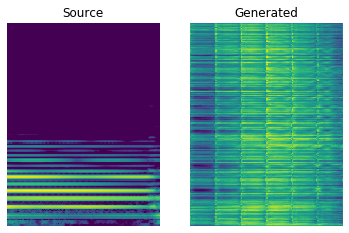

Mean D loss: 0.07448983937501907 Mean G loss: 1.2953733205795288 Mean ID loss: 0.1293073296546936
[Epoch 1551/5000] [Batch 0] [D loss f: 0.08208253234624863 r: 0.07460924983024597] [G loss: 1.2968863248825073] [ID loss: 0.12950904667377472] [LR: 0.0002]
Time/Batch 0.04233741760253906
Mean D loss: 0.017794743180274963 Mean G loss: 1.214110016822815 Mean ID loss: 0.1307755708694458
[Epoch 1552/5000] [Batch 0] [D loss f: 0.008962872438132763 r: 0.030205896124243736] [G loss: 1.2376432418823242] [ID loss: 0.13075818121433258] [LR: 0.0002]
Time/Batch 0.037059688568115236
Mean D loss: 0.01624508760869503 Mean G loss: 1.3768237829208374 Mean ID loss: 0.12641967833042145
[Epoch 1553/5000] [Batch 0] [D loss f: 0.021140292286872864 r: 0.05598623678088188] [G loss: 1.357985019683838] [ID loss: 0.1278889924287796] [LR: 0.0002]
Time/Batch 0.036560440063476564
Mean D loss: 0.02621261589229107 Mean G loss: 1.2144261598587036 Mean ID loss: 0.13459140062332153
[Epoch 1554/5000] [Batch 0] [D loss f: 0.0

  2%|▏         | 40/2000 [00:00<00:03, 637.32it/s, loss=1.24e-5, spectral_convergence=-11.7]

Time/Batch 0.03694620132446289
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 865.48it/s, loss=3.5e-5, spectral_convergence=-35.1] 


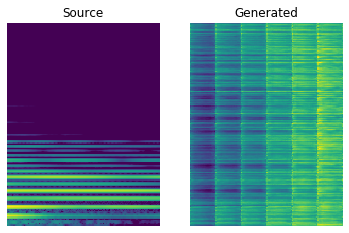

Mean D loss: 0.10079165548086166 Mean G loss: 1.0918501615524292 Mean ID loss: 0.14469613134860992
[Epoch 1601/5000] [Batch 0] [D loss f: 0.10276782512664795 r: 0.11683586984872818] [G loss: 1.0694199800491333] [ID loss: 0.13701817393302917] [LR: 0.0002]
Time/Batch 0.041868972778320315
Mean D loss: 0.11963031440973282 Mean G loss: 0.8945310711860657 Mean ID loss: 0.12313171476125717
[Epoch 1602/5000] [Batch 0] [D loss f: 0.17253607511520386 r: 0.10957378149032593] [G loss: 0.806541919708252] [ID loss: 0.12331105023622513] [LR: 0.0002]
Time/Batch 0.036706066131591795
Mean D loss: 0.15121465921401978 Mean G loss: 0.7743541598320007 Mean ID loss: 0.11841332167387009
[Epoch 1603/5000] [Batch 0] [D loss f: 0.13259702920913696 r: 0.20272032916545868] [G loss: 0.7950053215026855] [ID loss: 0.11871624737977982] [LR: 0.0002]
Time/Batch 0.03673696517944336
Mean D loss: 0.13228370249271393 Mean G loss: 0.843809187412262 Mean ID loss: 0.1212528869509697
[Epoch 1604/5000] [Batch 0] [D loss f: 0.103

  0%|          | 10/2000 [00:00<00:06, 317.39it/s, loss=2.06e-5, spectral_convergence=-8.91]

Time/Batch 0.04032788276672363
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 803.35it/s, loss=2.17e-5, spectral_convergence=-34]  


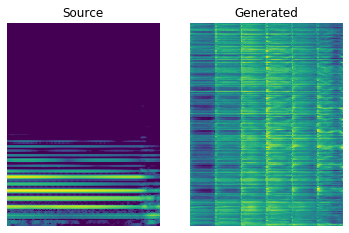

Mean D loss: 0.1272287219762802 Mean G loss: 1.0592701435089111 Mean ID loss: 0.111275814473629
[Epoch 1651/5000] [Batch 0] [D loss f: 0.11925327777862549 r: 0.1536029875278473] [G loss: 1.0463415384292603] [ID loss: 0.11127325892448425] [LR: 0.0002]
Time/Batch 0.04459013938903809
Mean D loss: 0.06375134736299515 Mean G loss: 0.9849206805229187 Mean ID loss: 0.10838419944047928
[Epoch 1652/5000] [Batch 0] [D loss f: 0.04973417520523071 r: 0.1473160982131958] [G loss: 1.0076161623001099] [ID loss: 0.10486646741628647] [LR: 0.0002]
Time/Batch 0.03792438507080078
Mean D loss: 0.1051185354590416 Mean G loss: 1.1836062669754028 Mean ID loss: 0.0987953320145607
[Epoch 1653/5000] [Batch 0] [D loss f: 0.10873270034790039 r: 0.16580837965011597] [G loss: 1.2451519966125488] [ID loss: 0.10159260034561157] [LR: 0.0002]
Time/Batch 0.03671255111694336
Mean D loss: 0.09406129270792007 Mean G loss: 1.3169933557510376 Mean ID loss: 0.10574501752853394
[Epoch 1654/5000] [Batch 0] [D loss f: 0.091457761

  2%|▎         | 50/2000 [00:00<00:02, 734.03it/s, loss=1.54e-6, spectral_convergence=-9.19]

Time/Batch 0.036722755432128905
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 861.00it/s, loss=0.000688, spectral_convergence=-18.5]


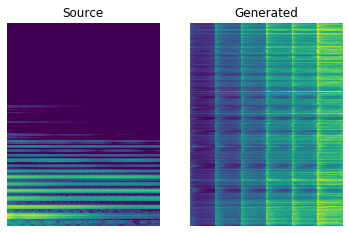

Mean D loss: 0.12539547681808472 Mean G loss: 1.261215090751648 Mean ID loss: 0.10385935753583908
[Epoch 1701/5000] [Batch 0] [D loss f: 0.11890191584825516 r: 0.1376635879278183] [G loss: 1.257827639579773] [ID loss: 0.10638511180877686] [LR: 0.0002]
Time/Batch 0.04227256774902344
Mean D loss: 0.1789720505475998 Mean G loss: 0.7962769865989685 Mean ID loss: 0.10516331344842911
[Epoch 1702/5000] [Batch 0] [D loss f: 0.22748611867427826 r: 0.2322465032339096] [G loss: 0.7294896245002747] [ID loss: 0.10340746492147446] [LR: 0.0002]
Time/Batch 0.03674497604370117
Mean D loss: 0.16950029134750366 Mean G loss: 0.8176670074462891 Mean ID loss: 0.09489518404006958
[Epoch 1703/5000] [Batch 0] [D loss f: 0.15359358489513397 r: 0.1783834844827652] [G loss: 0.8398663997650146] [ID loss: 0.0945383608341217] [LR: 0.0002]
Time/Batch 0.03656558990478516
Mean D loss: 0.09089799970388412 Mean G loss: 1.0922486782073975 Mean ID loss: 0.0936959758400917
[Epoch 1704/5000] [Batch 0] [D loss f: 0.0985516086

  4%|▍         | 80/2000 [00:00<00:02, 744.59it/s, loss=1.2e-5, spectral_convergence=-9.96] 

Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 743.84it/s, loss=6.56e-5, spectral_convergence=-16.4]


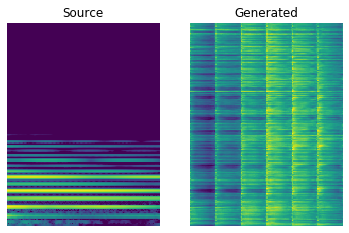

Mean D loss: 0.1319054663181305 Mean G loss: 1.2731493711471558 Mean ID loss: 0.08747956901788712
[Epoch 1751/5000] [Batch 0] [D loss f: 0.12341000884771347 r: 0.19629181921482086] [G loss: 1.3335367441177368] [ID loss: 0.08663857728242874] [LR: 0.0002]
Time/Batch 0.04298267364501953
Mean D loss: 0.18654608726501465 Mean G loss: 1.357779622077942 Mean ID loss: 0.08866716176271439
[Epoch 1752/5000] [Batch 0] [D loss f: 0.18571466207504272 r: 0.14315165579319] [G loss: 1.3695610761642456] [ID loss: 0.0924232229590416] [LR: 0.0002]
Time/Batch 0.0374547004699707
Mean D loss: 0.0630817711353302 Mean G loss: 1.5396146774291992 Mean ID loss: 0.10102655738592148
[Epoch 1753/5000] [Batch 0] [D loss f: 0.06322655826807022 r: 0.08769723027944565] [G loss: 1.4764407873153687] [ID loss: 0.10056803375482559] [LR: 0.0002]
Time/Batch 0.036991310119628903
Mean D loss: 0.0913057029247284 Mean G loss: 1.4201627969741821 Mean ID loss: 0.10058393329381943
[Epoch 1754/5000] [Batch 0] [D loss f: 0.1157759428

  2%|▏         | 40/2000 [00:00<00:02, 686.87it/s, loss=4.16e-5, spectral_convergence=-11.9]

Time/Batch 0.037136077880859375
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 866.53it/s, loss=2.66e-5, spectral_convergence=-24.5]


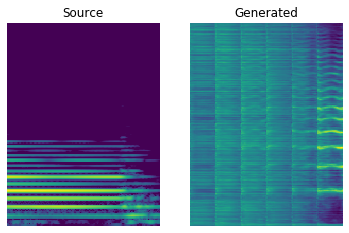

Mean D loss: 0.09741949290037155 Mean G loss: 0.9539647102355957 Mean ID loss: 0.09076573699712753
[Epoch 1801/5000] [Batch 0] [D loss f: 0.08848285675048828 r: 0.18074817955493927] [G loss: 0.9711335301399231] [ID loss: 0.09402533620595932] [LR: 0.0002]
Time/Batch 0.042195796966552734
Mean D loss: 0.05513631924986839 Mean G loss: 1.109164834022522 Mean ID loss: 0.10088012367486954
[Epoch 1802/5000] [Batch 0] [D loss f: 0.0923415794968605 r: 0.10749468952417374] [G loss: 1.0539162158966064] [ID loss: 0.09689861536026001] [LR: 0.0002]
Time/Batch 0.03706073760986328
Mean D loss: 0.16946150362491608 Mean G loss: 0.7529035210609436 Mean ID loss: 0.0857495665550232
[Epoch 1803/5000] [Batch 0] [D loss f: 0.15868763625621796 r: 0.2005104422569275] [G loss: 0.7845914959907532] [ID loss: 0.08605796843767166] [LR: 0.0002]
Time/Batch 0.03690810203552246
Mean D loss: 0.11902765184640884 Mean G loss: 0.931581974029541 Mean ID loss: 0.09122387319803238
[Epoch 1804/5000] [Batch 0] [D loss f: 0.109081

  2%|▏         | 30/2000 [00:00<00:03, 568.41it/s, loss=2.73e-6, spectral_convergence=-9.31]

Time/Batch 0.0377354621887207
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 812.19it/s, loss=0.000423, spectral_convergence=-20.6]


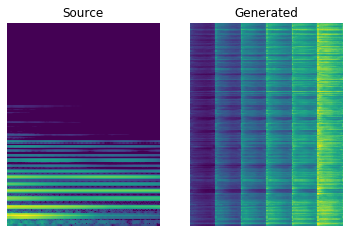

Mean D loss: 0.10847803950309753 Mean G loss: 1.261067509651184 Mean ID loss: 0.08374655246734619
[Epoch 1851/5000] [Batch 0] [D loss f: 0.14827682077884674 r: 0.12154478579759598] [G loss: 1.1809768676757812] [ID loss: 0.08253153413534164] [LR: 0.0002]
Time/Batch 0.04324016571044922
Mean D loss: 0.16023851931095123 Mean G loss: 0.8817277550697327 Mean ID loss: 0.0752691701054573
[Epoch 1852/5000] [Batch 0] [D loss f: 0.1856875866651535 r: 0.17127710580825806] [G loss: 0.84576016664505] [ID loss: 0.07416176050901413] [LR: 0.0002]
Time/Batch 0.037140846252441406
Mean D loss: 0.23157091438770294 Mean G loss: 0.6128149628639221 Mean ID loss: 0.08277115225791931
[Epoch 1853/5000] [Batch 0] [D loss f: 0.27691560983657837 r: 0.3742719888687134] [G loss: 0.5630790591239929] [ID loss: 0.08295583724975586] [LR: 0.0002]
Time/Batch 0.03824796676635742
Mean D loss: 0.3671972453594208 Mean G loss: 0.9492518305778503 Mean ID loss: 0.08298193663358688
[Epoch 1854/5000] [Batch 0] [D loss f: 0.24926979

  2%|▏         | 30/2000 [00:00<00:03, 599.85it/s, loss=1.29e-5, spectral_convergence=-9.48]

Time/Batch 0.037802267074584964
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 835.43it/s, loss=3.19e-5, spectral_convergence=-36.6]


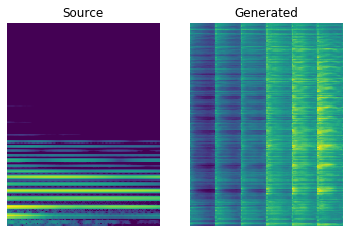

Mean D loss: 0.11568606644868851 Mean G loss: 1.4576934576034546 Mean ID loss: 0.08859097212553024
[Epoch 1901/5000] [Batch 0] [D loss f: 0.13096527755260468 r: 0.20282377302646637] [G loss: 1.4143539667129517] [ID loss: 0.08754237741231918] [LR: 0.0002]
Time/Batch 0.042722892761230466
Mean D loss: 0.11013218760490417 Mean G loss: 0.9572688937187195 Mean ID loss: 0.07788985222578049
[Epoch 1902/5000] [Batch 0] [D loss f: 0.094852976500988 r: 0.12711969017982483] [G loss: 1.0172539949417114] [ID loss: 0.07767800241708755] [LR: 0.0002]
Time/Batch 0.037310314178466794
Mean D loss: 0.1375008076429367 Mean G loss: 1.3149758577346802 Mean ID loss: 0.08034215122461319
[Epoch 1903/5000] [Batch 0] [D loss f: 0.14690420031547546 r: 0.1791563630104065] [G loss: 1.2591572999954224] [ID loss: 0.07822582870721817] [LR: 0.0002]
Time/Batch 0.03837652206420898
Mean D loss: 0.14549818634986877 Mean G loss: 0.8254701495170593 Mean ID loss: 0.0794660821557045
[Epoch 1904/5000] [Batch 0] [D loss f: 0.15432

  2%|▎         | 50/2000 [00:00<00:02, 721.73it/s, loss=1.59e-5, spectral_convergence=-11.3]

Time/Batch 0.03722696304321289
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 875.90it/s, loss=6.27e-5, spectral_convergence=-18.8]


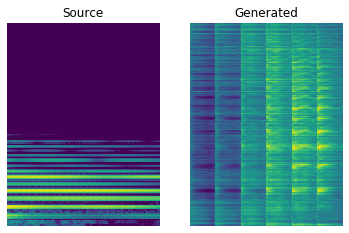

Mean D loss: 0.2650604248046875 Mean G loss: 0.5873464941978455 Mean ID loss: 0.07691092789173126
[Epoch 1951/5000] [Batch 0] [D loss f: 0.23566429316997528 r: 0.24230746924877167] [G loss: 0.6135864853858948] [ID loss: 0.07485983520746231] [LR: 0.0002]
Time/Batch 0.04141497611999512
Mean D loss: 0.16164806485176086 Mean G loss: 1.078178882598877 Mean ID loss: 0.07370270043611526
[Epoch 1952/5000] [Batch 0] [D loss f: 0.18039904534816742 r: 0.2256506085395813] [G loss: 1.0506550073623657] [ID loss: 0.07601543515920639] [LR: 0.0002]
Time/Batch 0.03740992546081543
Mean D loss: 0.11970404535531998 Mean G loss: 0.8320178389549255 Mean ID loss: 0.08380589634180069
[Epoch 1953/5000] [Batch 0] [D loss f: 0.09828431159257889 r: 0.17301957309246063] [G loss: 0.8606507778167725] [ID loss: 0.08051139861345291] [LR: 0.0002]
Time/Batch 0.037083673477172854
Mean D loss: 0.10475806146860123 Mean G loss: 0.9857504963874817 Mean ID loss: 0.07425395399332047
[Epoch 1954/5000] [Batch 0] [D loss f: 0.0878

  2%|▏         | 40/2000 [00:00<00:02, 688.42it/s, loss=1.44e-6, spectral_convergence=-8.27]

Time/Batch 0.03723287582397461
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 858.81it/s, loss=0.000531, spectral_convergence=-10.8]


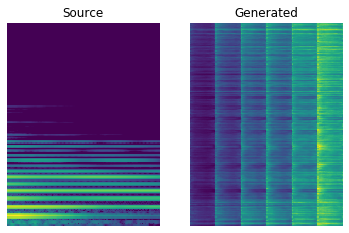

Mean D loss: 0.1463351994752884 Mean G loss: 1.0125128030776978 Mean ID loss: 0.06707651913166046
[Epoch 2001/5000] [Batch 0] [D loss f: 0.13468076288700104 r: 0.17900033295154572] [G loss: 1.0375006198883057] [ID loss: 0.06726738065481186] [LR: 0.0002]
Time/Batch 0.04267029762268067
Mean D loss: 0.13553665578365326 Mean G loss: 1.2345259189605713 Mean ID loss: 0.06881778687238693
[Epoch 2002/5000] [Batch 0] [D loss f: 0.1325691193342209 r: 0.14476743340492249] [G loss: 1.220673680305481] [ID loss: 0.06986285746097565] [LR: 0.0002]
Time/Batch 0.03737187385559082
Mean D loss: 0.08379895240068436 Mean G loss: 1.0553616285324097 Mean ID loss: 0.07211162149906158
[Epoch 2003/5000] [Batch 0] [D loss f: 0.1211358979344368 r: 0.21823005378246307] [G loss: 1.008190631866455] [ID loss: 0.07078184932470322] [LR: 0.0002]
Time/Batch 0.0373077392578125
Mean D loss: 0.13491736352443695 Mean G loss: 1.125187873840332 Mean ID loss: 0.06854186207056046
[Epoch 2004/5000] [Batch 0] [D loss f: 0.107565313

  2%|▏         | 40/2000 [00:00<00:02, 728.75it/s, loss=1.02e-5, spectral_convergence=-8]   

Time/Batch 0.03728675842285156
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 807.87it/s, loss=6.39e-5, spectral_convergence=-22.5]


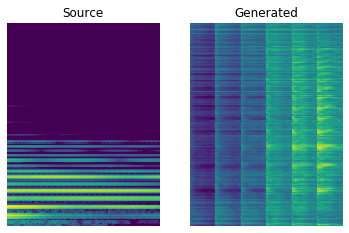

Mean D loss: 0.17851097881793976 Mean G loss: 0.9638360142707825 Mean ID loss: 0.06768446415662766
[Epoch 2051/5000] [Batch 0] [D loss f: 0.1708620935678482 r: 0.2727583348751068] [G loss: 0.9835922122001648] [ID loss: 0.07281533628702164] [LR: 0.0002]
Time/Batch 0.043715906143188474
Mean D loss: 0.08718782663345337 Mean G loss: 1.130000352859497 Mean ID loss: 0.08200568705797195
[Epoch 2052/5000] [Batch 0] [D loss f: 0.15214599668979645 r: 0.22104263305664062] [G loss: 1.0589004755020142] [ID loss: 0.07654010504484177] [LR: 0.0002]
Time/Batch 0.03732333183288574
Mean D loss: 0.19769783318042755 Mean G loss: 0.9103507399559021 Mean ID loss: 0.06179327890276909
[Epoch 2053/5000] [Batch 0] [D loss f: 0.13678844273090363 r: 0.26564428210258484] [G loss: 1.0208888053894043] [ID loss: 0.06166622415184975] [LR: 0.0002]
Time/Batch 0.03787074089050293
Mean D loss: 0.11491008847951889 Mean G loss: 1.2997093200683594 Mean ID loss: 0.06335973739624023
[Epoch 2054/5000] [Batch 0] [D loss f: 0.1508

  2%|▏         | 40/2000 [00:00<00:02, 684.34it/s, loss=1.53e-6, spectral_convergence=-9.29]

Time/Batch 0.039418935775756836
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 859.95it/s, loss=0.000389, spectral_convergence=-18.8]


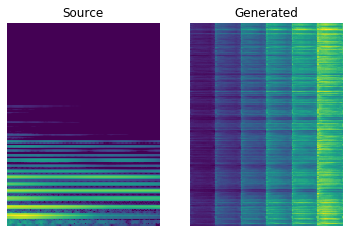

Mean D loss: 0.13715745508670807 Mean G loss: 0.9993532299995422 Mean ID loss: 0.07691396772861481
[Epoch 2101/5000] [Batch 0] [D loss f: 0.11526200920343399 r: 0.08237819373607635] [G loss: 1.0970466136932373] [ID loss: 0.07757671922445297] [LR: 0.0002]
Time/Batch 0.04286327362060547
Mean D loss: 0.023104330524802208 Mean G loss: 1.348978042602539 Mean ID loss: 0.06887099146842957
[Epoch 2102/5000] [Batch 0] [D loss f: 0.025670373812317848 r: 0.047958552837371826] [G loss: 1.3317891359329224] [ID loss: 0.07046250253915787] [LR: 0.0002]
Time/Batch 0.03726625442504883
Mean D loss: 0.049855560064315796 Mean G loss: 1.2061291933059692 Mean ID loss: 0.07238829135894775
[Epoch 2103/5000] [Batch 0] [D loss f: 0.05147574841976166 r: 0.1126500591635704] [G loss: 1.162869930267334] [ID loss: 0.06957582384347916] [LR: 0.0002]
Time/Batch 0.03687949180603027
Mean D loss: 0.04389773681759834 Mean G loss: 1.0503484010696411 Mean ID loss: 0.064555324614048
[Epoch 2104/5000] [Batch 0] [D loss f: 0.068

  2%|▏         | 40/2000 [00:00<00:02, 702.20it/s, loss=0.00203, spectral_convergence=-4.2] 

Time/Batch 0.03763036727905274
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 869.00it/s, loss=1.62e-5, spectral_convergence=-30.4]


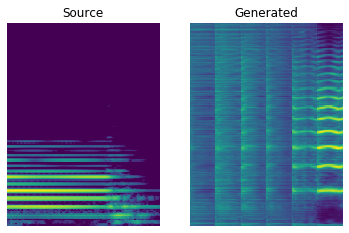

Mean D loss: 0.11533953994512558 Mean G loss: 1.3076988458633423 Mean ID loss: 0.06506186723709106
[Epoch 2151/5000] [Batch 0] [D loss f: 0.13417641818523407 r: 0.109727643430233] [G loss: 1.2664521932601929] [ID loss: 0.06632331013679504] [LR: 0.0002]
Time/Batch 0.04236516952514648
Mean D loss: 0.11851585656404495 Mean G loss: 1.0632048845291138 Mean ID loss: 0.06674890965223312
[Epoch 2152/5000] [Batch 0] [D loss f: 0.096046082675457 r: 0.2032652646303177] [G loss: 1.1148818731307983] [ID loss: 0.06614989787340164] [LR: 0.0002]
Time/Batch 0.03681225776672363
Mean D loss: 0.10155490040779114 Mean G loss: 1.0939397811889648 Mean ID loss: 0.06745585054159164
[Epoch 2153/5000] [Batch 0] [D loss f: 0.11535241454839706 r: 0.14210574328899384] [G loss: 1.05632483959198] [ID loss: 0.06957016885280609] [LR: 0.0002]
Time/Batch 0.03697662353515625
Mean D loss: 0.12189700454473495 Mean G loss: 1.086573600769043 Mean ID loss: 0.07823795080184937
[Epoch 2154/5000] [Batch 0] [D loss f: 0.1080994978

  2%|▎         | 50/2000 [00:00<00:02, 721.70it/s, loss=2.09e-7, spectral_convergence=-6.66]

Time/Batch 0.03704233169555664
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 869.41it/s, loss=0.000495, spectral_convergence=-21.7]


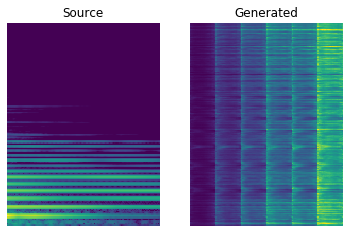

Mean D loss: 0.3487137258052826 Mean G loss: 1.4028801918029785 Mean ID loss: 0.07638448476791382
[Epoch 2201/5000] [Batch 0] [D loss f: 0.3453234136104584 r: 0.3251093924045563] [G loss: 1.3546024560928345] [ID loss: 0.07670190930366516] [LR: 0.0002]
Time/Batch 0.041301631927490236
Mean D loss: 0.10173976421356201 Mean G loss: 0.978553295135498 Mean ID loss: 0.0757797434926033
[Epoch 2202/5000] [Batch 0] [D loss f: 0.12929153442382812 r: 0.3030835688114166] [G loss: 0.9384942650794983] [ID loss: 0.07368054240942001] [LR: 0.0002]
Time/Batch 0.037499284744262694
Mean D loss: 0.15648576617240906 Mean G loss: 0.7294721007347107 Mean ID loss: 0.062489479780197144
[Epoch 2203/5000] [Batch 0] [D loss f: 0.13891039788722992 r: 0.27622249722480774] [G loss: 0.7540304064750671] [ID loss: 0.06403432041406631] [LR: 0.0002]
Time/Batch 0.03692760467529297
Mean D loss: 0.07500815391540527 Mean G loss: 0.9961584210395813 Mean ID loss: 0.07300249487161636
[Epoch 2204/5000] [Batch 0] [D loss f: 0.13259

  2%|▏         | 40/2000 [00:00<00:02, 699.09it/s, loss=0.000317, spectral_convergence=-6.08]

Time/Batch 0.037522506713867185
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 851.78it/s, loss=1.85e-5, spectral_convergence=-31.4]


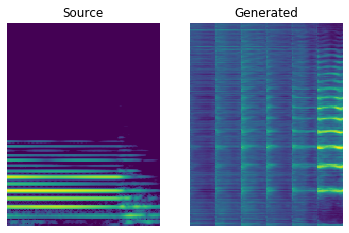

Mean D loss: 0.1739218682050705 Mean G loss: 0.9372598528862 Mean ID loss: 0.06388715654611588
[Epoch 2251/5000] [Batch 0] [D loss f: 0.12186361104249954 r: 0.2676834166049957] [G loss: 1.0124746561050415] [ID loss: 0.0640362873673439] [LR: 0.0002]
Time/Batch 0.04225587844848633
Mean D loss: 0.11034632474184036 Mean G loss: 1.2168364524841309 Mean ID loss: 0.06045112386345863
[Epoch 2252/5000] [Batch 0] [D loss f: 0.14595724642276764 r: 0.25019824504852295] [G loss: 1.161625862121582] [ID loss: 0.06033013388514519] [LR: 0.0002]
Time/Batch 0.03694791793823242
Mean D loss: 0.17035792768001556 Mean G loss: 0.9340643882751465 Mean ID loss: 0.05750912427902222
[Epoch 2253/5000] [Batch 0] [D loss f: 0.131734237074852 r: 0.1492525041103363] [G loss: 0.9931972026824951] [ID loss: 0.05935147777199745] [LR: 0.0002]
Time/Batch 0.037011003494262694
Mean D loss: 0.12405898422002792 Mean G loss: 1.0827388763427734 Mean ID loss: 0.06819925457239151
[Epoch 2254/5000] [Batch 0] [D loss f: 0.12453935295

  2%|▏         | 40/2000 [00:00<00:02, 655.43it/s, loss=0.00375, spectral_convergence=-2.75]

Time/Batch 0.03696942329406738
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 840.07it/s, loss=2.4e-5, spectral_convergence=-17.8] 


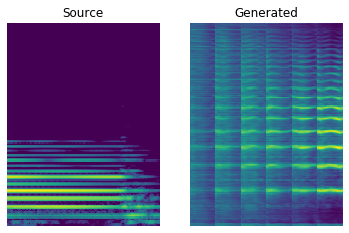

Mean D loss: 0.09585661441087723 Mean G loss: 1.286085605621338 Mean ID loss: 0.0642034187912941
[Epoch 2301/5000] [Batch 0] [D loss f: 0.10184363275766373 r: 0.15406323969364166] [G loss: 1.2325255870819092] [ID loss: 0.06327728182077408] [LR: 0.0002]
Time/Batch 0.04159221649169922
Mean D loss: 0.0935884490609169 Mean G loss: 1.2501211166381836 Mean ID loss: 0.06660023331642151
[Epoch 2302/5000] [Batch 0] [D loss f: 0.0876014307141304 r: 0.13532863557338715] [G loss: 1.3213468790054321] [ID loss: 0.06841760873794556] [LR: 0.0002]
Time/Batch 0.03732004165649414
Mean D loss: 0.07748472690582275 Mean G loss: 1.4892206192016602 Mean ID loss: 0.06597316265106201
[Epoch 2303/5000] [Batch 0] [D loss f: 0.09209540486335754 r: 0.13934649527072906] [G loss: 1.448023796081543] [ID loss: 0.06343105435371399] [LR: 0.0002]
Time/Batch 0.03696541786193848
Mean D loss: 0.13187117874622345 Mean G loss: 1.2363392114639282 Mean ID loss: 0.05698905512690544
[Epoch 2304/5000] [Batch 0] [D loss f: 0.1219335

  2%|▏         | 40/2000 [00:00<00:02, 690.62it/s, loss=4.99e-6, spectral_convergence=-11.3]

Time/Batch 0.03701086044311523
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 846.86it/s, loss=0.000168, spectral_convergence=-24.8]


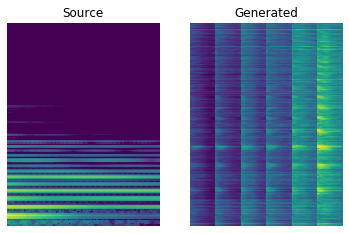

Mean D loss: 0.13451401889324188 Mean G loss: 0.8237211108207703 Mean ID loss: 0.06006752327084541
[Epoch 2351/5000] [Batch 0] [D loss f: 0.11003267765045166 r: 0.23359036445617676] [G loss: 0.8542919754981995] [ID loss: 0.059528931975364685] [LR: 0.0002]
Time/Batch 0.04265341758728027
Mean D loss: 0.17912109196186066 Mean G loss: 1.1513354778289795 Mean ID loss: 0.0601830780506134
[Epoch 2352/5000] [Batch 0] [D loss f: 0.2080785483121872 r: 0.25430575013160706] [G loss: 1.1106617450714111] [ID loss: 0.06005098298192024] [LR: 0.0002]
Time/Batch 0.037136077880859375
Mean D loss: 0.1778634935617447 Mean G loss: 0.6687830090522766 Mean ID loss: 0.05815298482775688
[Epoch 2353/5000] [Batch 0] [D loss f: 0.13066330552101135 r: 0.20211921632289886] [G loss: 0.7294340133666992] [ID loss: 0.058846939355134964] [LR: 0.0002]
Time/Batch 0.037651777267456055
Mean D loss: 0.12246334552764893 Mean G loss: 1.1280983686447144 Mean ID loss: 0.06459792703390121
[Epoch 2354/5000] [Batch 0] [D loss f: 0.1

  0%|          | 10/2000 [00:00<00:04, 406.24it/s, loss=0.000388, spectral_convergence=-3.48]

Time/Batch 0.03865756988525391
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 845.02it/s, loss=6.46e-5, spectral_convergence=-13.9]


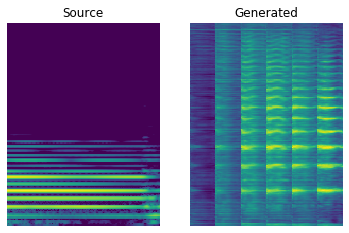

Mean D loss: 0.24496257305145264 Mean G loss: 0.6776337027549744 Mean ID loss: 0.05732354521751404
[Epoch 2401/5000] [Batch 0] [D loss f: 0.16953666508197784 r: 0.24359919130802155] [G loss: 0.8231935501098633] [ID loss: 0.05932475998997688] [LR: 0.0002]
Time/Batch 0.0430849552154541
Mean D loss: 0.15420840680599213 Mean G loss: 1.4002819061279297 Mean ID loss: 0.0707731619477272
[Epoch 2402/5000] [Batch 0] [D loss f: 0.1993158608675003 r: 0.23528391122817993] [G loss: 1.2908718585968018] [ID loss: 0.0685713067650795] [LR: 0.0002]
Time/Batch 0.03831229209899902
Mean D loss: 0.25983133912086487 Mean G loss: 0.8268638253211975 Mean ID loss: 0.05498581752181053
[Epoch 2403/5000] [Batch 0] [D loss f: 0.27781161665916443 r: 0.3982337415218353] [G loss: 0.8008024096488953] [ID loss: 0.054406240582466125] [LR: 0.0002]
Time/Batch 0.0367825984954834
Mean D loss: 0.19333414733409882 Mean G loss: 0.8195497393608093 Mean ID loss: 0.055328186601400375
[Epoch 2404/5000] [Batch 0] [D loss f: 0.132568

  1%|          | 20/2000 [00:00<00:04, 478.77it/s, loss=0.00384, spectral_convergence=-1.85]

Time/Batch 0.0376676082611084
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 773.60it/s, loss=2.35e-5, spectral_convergence=-15.1]


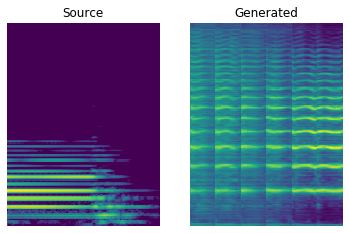

Mean D loss: 0.2083832025527954 Mean G loss: 0.9229633212089539 Mean ID loss: 0.05792594328522682
[Epoch 2451/5000] [Batch 0] [D loss f: 0.18146352469921112 r: 0.3312477171421051] [G loss: 0.9406344294548035] [ID loss: 0.057905301451683044] [LR: 0.0002]
Time/Batch 0.042891311645507815
Mean D loss: 0.17643363773822784 Mean G loss: 0.9285216331481934 Mean ID loss: 0.05861964821815491
[Epoch 2452/5000] [Batch 0] [D loss f: 0.14811968803405762 r: 0.23300229012966156] [G loss: 0.9798367619514465] [ID loss: 0.05929805338382721] [LR: 0.0002]
Time/Batch 0.03732428550720215
Mean D loss: 0.13868208229541779 Mean G loss: 1.091677188873291 Mean ID loss: 0.05878187343478203
[Epoch 2453/5000] [Batch 0] [D loss f: 0.11832048743963242 r: 0.3207927644252777] [G loss: 1.142445683479309] [ID loss: 0.05944417417049408] [LR: 0.0002]
Time/Batch 0.037201452255249026
Mean D loss: 0.2256147861480713 Mean G loss: 1.085408091545105 Mean ID loss: 0.05875491723418236
[Epoch 2454/5000] [Batch 0] [D loss f: 0.287410

  2%|▏         | 40/2000 [00:00<00:02, 677.88it/s, loss=0.000107, spectral_convergence=-11.7]

Time/Batch 0.0373720645904541
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 748.72it/s, loss=2.8e-5, spectral_convergence=-21.9] 


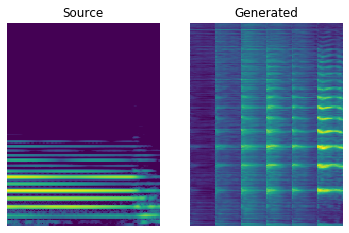

Mean D loss: 0.21946780383586884 Mean G loss: 0.7717954516410828 Mean ID loss: 0.05486172065138817
[Epoch 2501/5000] [Batch 0] [D loss f: 0.1958196610212326 r: 0.19762246310710907] [G loss: 0.7952492237091064] [ID loss: 0.05796937271952629] [LR: 0.0002]
Time/Batch 0.04334335327148438
Mean D loss: 0.24696962535381317 Mean G loss: 1.0656200647354126 Mean ID loss: 0.06490040570497513
[Epoch 2502/5000] [Batch 0] [D loss f: 0.23692993819713593 r: 0.335566908121109] [G loss: 1.1259262561798096] [ID loss: 0.06184031069278717] [LR: 0.0002]
Time/Batch 0.03752202987670898
Mean D loss: 0.10297977179288864 Mean G loss: 1.254355549812317 Mean ID loss: 0.05613800883293152
[Epoch 2503/5000] [Batch 0] [D loss f: 0.11961004883050919 r: 0.2712136507034302] [G loss: 1.2028956413269043] [ID loss: 0.05568406358361244] [LR: 0.0002]
Time/Batch 0.03692116737365723
Mean D loss: 0.10702665895223618 Mean G loss: 1.2182668447494507 Mean ID loss: 0.05795589089393616
[Epoch 2504/5000] [Batch 0] [D loss f: 0.1144998

  2%|▏         | 40/2000 [00:00<00:02, 665.16it/s, loss=2.81e-5, spectral_convergence=-8.29]

Time/Batch 0.036993217468261716
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 846.87it/s, loss=5.35e-5, spectral_convergence=-17.6]


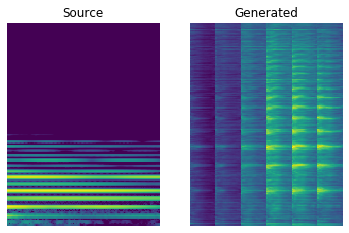

Mean D loss: 0.40351128578186035 Mean G loss: 0.7560312151908875 Mean ID loss: 0.054078876972198486
[Epoch 2551/5000] [Batch 0] [D loss f: 0.33883190155029297 r: 0.4185810983181] [G loss: 0.8394104838371277] [ID loss: 0.0538465790450573] [LR: 0.0002]
Time/Batch 0.04165205955505371
Mean D loss: 0.1682833582162857 Mean G loss: 0.9789912104606628 Mean ID loss: 0.053015727549791336
[Epoch 2552/5000] [Batch 0] [D loss f: 0.16630809009075165 r: 0.3466179072856903] [G loss: 0.9870761036872864] [ID loss: 0.055039290338754654] [LR: 0.0002]
Time/Batch 0.037289762496948244
Mean D loss: 0.1535705327987671 Mean G loss: 1.0648785829544067 Mean ID loss: 0.06026133894920349
[Epoch 2553/5000] [Batch 0] [D loss f: 0.15386687219142914 r: 0.2887166738510132] [G loss: 1.048811435699463] [ID loss: 0.06307520717382431] [LR: 0.0002]
Time/Batch 0.03705563545227051
Mean D loss: 0.22193364799022675 Mean G loss: 1.2385040521621704 Mean ID loss: 0.07066978514194489
[Epoch 2554/5000] [Batch 0] [D loss f: 0.19132284

  2%|▏         | 40/2000 [00:00<00:02, 672.37it/s, loss=0.000333, spectral_convergence=-8.25]

Time/Batch 0.0370389461517334
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 813.41it/s, loss=2.94e-5, spectral_convergence=-17.2]


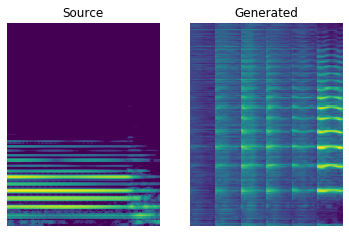

Mean D loss: 0.2759879231452942 Mean G loss: 0.9471731185913086 Mean ID loss: 0.05489926412701607
[Epoch 2601/5000] [Batch 0] [D loss f: 0.2600088119506836 r: 0.3361666202545166] [G loss: 0.9468872547149658] [ID loss: 0.05600901320576668] [LR: 0.0002]
Time/Batch 0.0410367488861084
Mean D loss: 0.22236023843288422 Mean G loss: 1.2425556182861328 Mean ID loss: 0.05705558881163597
[Epoch 2602/5000] [Batch 0] [D loss f: 0.2788154184818268 r: 0.2488371580839157] [G loss: 1.1521100997924805] [ID loss: 0.055467087775468826] [LR: 0.0002]
Time/Batch 0.037653875350952146
Mean D loss: 0.2469445914030075 Mean G loss: 1.1941837072372437 Mean ID loss: 0.06416638940572739
[Epoch 2603/5000] [Batch 0] [D loss f: 0.18073789775371552 r: 0.3848470151424408] [G loss: 1.3321354389190674] [ID loss: 0.06444934010505676] [LR: 0.0002]
Time/Batch 0.037184715270996094
Mean D loss: 0.31665799021720886 Mean G loss: 1.567060112953186 Mean ID loss: 0.055604610592126846
[Epoch 2604/5000] [Batch 0] [D loss f: 0.3110029

  2%|▏         | 30/2000 [00:00<00:03, 597.45it/s, loss=7.42e-7, spectral_convergence=-10.3]

Time/Batch 0.037081670761108396
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 790.14it/s, loss=0.000117, spectral_convergence=-33.9]


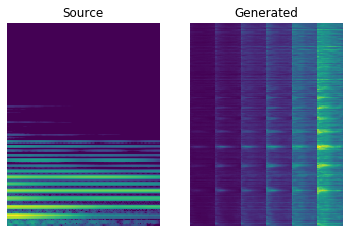

Mean D loss: 0.21834103763103485 Mean G loss: 0.7889397740364075 Mean ID loss: 0.057361360639333725
[Epoch 2651/5000] [Batch 0] [D loss f: 0.14183096587657928 r: 0.26352062821388245] [G loss: 0.9016662240028381] [ID loss: 0.05608028173446655] [LR: 0.0002]
Time/Batch 0.04116015434265137
Mean D loss: 0.14437653124332428 Mean G loss: 1.1881961822509766 Mean ID loss: 0.055678386241197586
[Epoch 2652/5000] [Batch 0] [D loss f: 0.14607107639312744 r: 0.34316906332969666] [G loss: 1.2013907432556152] [ID loss: 0.05607928708195686] [LR: 0.0002]
Time/Batch 0.03808751106262207
Mean D loss: 0.20371384918689728 Mean G loss: 1.2307617664337158 Mean ID loss: 0.05995894595980644
[Epoch 2653/5000] [Batch 0] [D loss f: 0.238473579287529 r: 0.3388468027114868] [G loss: 1.1462033987045288] [ID loss: 0.062295347452163696] [LR: 0.0002]
Time/Batch 0.037259149551391604
Mean D loss: 0.1792037934064865 Mean G loss: 0.7640138268470764 Mean ID loss: 0.06156124547123909
[Epoch 2654/5000] [Batch 0] [D loss f: 0.22

  1%|          | 20/2000 [00:00<00:03, 510.03it/s, loss=0.0533, spectral_convergence=-.0894]

Time/Batch 0.037817764282226565
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 797.13it/s, loss=3.06e-5, spectral_convergence=-16.1]


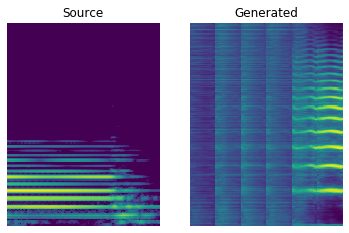

Mean D loss: 0.14193488657474518 Mean G loss: 1.5195196866989136 Mean ID loss: 0.0685403123497963
[Epoch 2701/5000] [Batch 0] [D loss f: 0.1557067632675171 r: 0.22261770069599152] [G loss: 1.4072165489196777] [ID loss: 0.068732850253582] [LR: 0.0002]
Time/Batch 0.04275269508361816
Mean D loss: 0.05109592154622078 Mean G loss: 0.9857528805732727 Mean ID loss: 0.0639185979962349
[Epoch 2702/5000] [Batch 0] [D loss f: 0.037324052304029465 r: 0.1313789188861847] [G loss: 1.267802119255066] [ID loss: 0.0660010352730751] [LR: 0.0002]
Time/Batch 0.03719477653503418
Mean D loss: 0.0 Mean G loss: 2.7071399688720703 Mean ID loss: 0.0905408039689064
[Epoch 2703/5000] [Batch 0] [D loss f: 0.0 r: 0.00042136883712373674] [G loss: 2.8617336750030518] [ID loss: 0.09369012713432312] [LR: 0.0002]
Time/Batch 0.03714170455932617
Mean D loss: 0.0 Mean G loss: 3.5323054790496826 Mean ID loss: 0.11278793215751648
[Epoch 2704/5000] [Batch 0] [D loss f: 0.0 r: 0.0] [G loss: 3.468520402908325] [ID loss: 0.11943

  1%|          | 20/2000 [00:00<00:03, 502.72it/s, loss=0.401, spectral_convergence=-.0219] 

Time/Batch 0.0375877857208252
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 818.87it/s, loss=2.42e-5, spectral_convergence=-15]  


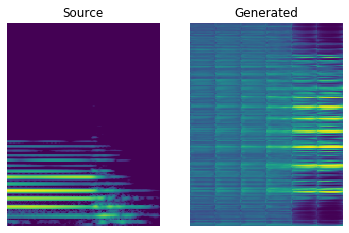

Mean D loss: 0.02513408102095127 Mean G loss: 1.8221378326416016 Mean ID loss: 0.09229627996683121
[Epoch 2751/5000] [Batch 0] [D loss f: 0.02513408102095127 r: 0.04302395507693291] [G loss: 1.90911066532135] [ID loss: 0.09311435371637344] [LR: 0.0002]
Time/Batch 0.04264044761657715
Mean D loss: 0.0027758863288909197 Mean G loss: 1.9276012182235718 Mean ID loss: 0.0971672311425209
[Epoch 2752/5000] [Batch 0] [D loss f: 0.0027758863288909197 r: 0.05050581693649292] [G loss: 1.8723732233047485] [ID loss: 0.09520077705383301] [LR: 0.0002]
Time/Batch 0.037360620498657224
Mean D loss: 0.021083524450659752 Mean G loss: 1.7562098503112793 Mean ID loss: 0.09070536494255066
[Epoch 2753/5000] [Batch 0] [D loss f: 0.021083524450659752 r: 0.0030253317672759295] [G loss: 1.7527704238891602] [ID loss: 0.0927116870880127] [LR: 0.0002]
Time/Batch 0.03742032051086426
Mean D loss: 0.003342893673107028 Mean G loss: 1.624458909034729 Mean ID loss: 0.10479772090911865
[Epoch 2754/5000] [Batch 0] [D loss f:

  1%|          | 20/2000 [00:00<00:04, 494.66it/s, loss=0.0201, spectral_convergence=-.255] 

Time/Batch 0.0373140811920166
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 791.62it/s, loss=1.28e-5, spectral_convergence=-36.5]


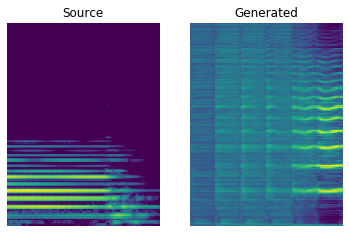

Mean D loss: 0.0015698975184932351 Mean G loss: 1.7741607427597046 Mean ID loss: 0.09592226892709732
[Epoch 2801/5000] [Batch 0] [D loss f: 0.0015698975184932351 r: 0.0463111586868763] [G loss: 1.7053829431533813] [ID loss: 0.0926041305065155] [LR: 0.0002]
Time/Batch 0.04124617576599121
Mean D loss: 0.004438824951648712 Mean G loss: 1.7589731216430664 Mean ID loss: 0.08385661244392395
[Epoch 2802/5000] [Batch 0] [D loss f: 0.021888429298996925 r: 0.1164902076125145] [G loss: 1.7403740882873535] [ID loss: 0.09001544117927551] [LR: 0.0002]
Time/Batch 0.03703198432922363
Mean D loss: 0.05036301910877228 Mean G loss: 1.6646500825881958 Mean ID loss: 0.09632030129432678
[Epoch 2803/5000] [Batch 0] [D loss f: 0.042223650962114334 r: 0.0856720581650734] [G loss: 1.6184664964675903] [ID loss: 0.09080705791711807] [LR: 0.0002]
Time/Batch 0.03791232109069824
Mean D loss: 0.009643123485147953 Mean G loss: 1.4577749967575073 Mean ID loss: 0.10297585278749466
[Epoch 2804/5000] [Batch 0] [D loss f: 

  2%|▏         | 30/2000 [00:00<00:03, 566.23it/s, loss=1.59e-6, spectral_convergence=-11.1]

Time/Batch 0.03813557624816895
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 835.60it/s, loss=0.00065, spectral_convergence=-19.9] 


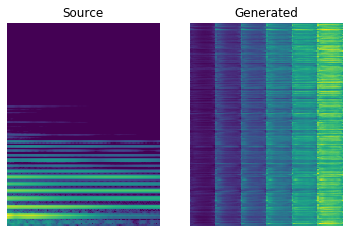

Mean D loss: 0.020761672407388687 Mean G loss: 1.2502366304397583 Mean ID loss: 0.0881795659661293
[Epoch 2851/5000] [Batch 0] [D loss f: 0.02046559378504753 r: 0.053534310311079025] [G loss: 1.2477532625198364] [ID loss: 0.08755996823310852] [LR: 0.0002]
Time/Batch 0.04262351989746094
Mean D loss: 0.02652590535581112 Mean G loss: 1.1468490362167358 Mean ID loss: 0.08863580226898193
[Epoch 2852/5000] [Batch 0] [D loss f: 0.009692957624793053 r: 0.06240992620587349] [G loss: 1.1729679107666016] [ID loss: 0.08821386098861694] [LR: 0.0002]
Time/Batch 0.03669123649597168
Mean D loss: 0.005670791491866112 Mean G loss: 1.247323989868164 Mean ID loss: 0.08449529856443405
[Epoch 2853/5000] [Batch 0] [D loss f: 0.005670791491866112 r: 0.06100684031844139] [G loss: 1.2802790403366089] [ID loss: 0.08539845794439316] [LR: 0.0002]
Time/Batch 0.03664703369140625
Mean D loss: 0.040150757879018784 Mean G loss: 1.4653981924057007 Mean ID loss: 0.1042049303650856
[Epoch 2854/5000] [Batch 0] [D loss f: 0

  2%|▏         | 40/2000 [00:00<00:02, 712.70it/s, loss=1.87e-6, spectral_convergence=-11.2]

Time/Batch 0.03730311393737793
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 725.72it/s, loss=7.57e-5, spectral_convergence=-31.6]


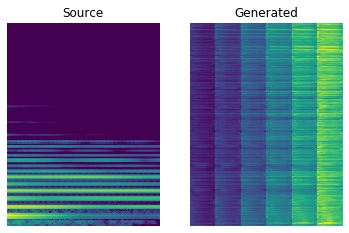

Mean D loss: 0.01089971512556076 Mean G loss: 1.3804303407669067 Mean ID loss: 0.08500178903341293
[Epoch 2901/5000] [Batch 0] [D loss f: 0.009144081734120846 r: 0.07502203434705734] [G loss: 1.4146575927734375] [ID loss: 0.08325312286615372] [LR: 0.0002]
Time/Batch 0.04264588356018066
Mean D loss: 0.011905166320502758 Mean G loss: 1.350122094154358 Mean ID loss: 0.07912164181470871
[Epoch 2902/5000] [Batch 0] [D loss f: 0.019207485020160675 r: 0.056583862751722336] [G loss: 1.3169304132461548] [ID loss: 0.07910063862800598] [LR: 0.0002]
Time/Batch 0.03947591781616211
Mean D loss: 0.009199942462146282 Mean G loss: 1.2310422658920288 Mean ID loss: 0.08237100392580032
[Epoch 2903/5000] [Batch 0] [D loss f: 0.0018976243445649743 r: 0.07051181048154831] [G loss: 1.2536760568618774] [ID loss: 0.08083342760801315] [LR: 0.0002]
Time/Batch 0.037755393981933595
Mean D loss: 0.014818725176155567 Mean G loss: 1.3263474702835083 Mean ID loss: 0.07776319235563278
[Epoch 2904/5000] [Batch 0] [D loss

  2%|▏         | 40/2000 [00:00<00:03, 578.38it/s, loss=7.8e-6, spectral_convergence=-12.1] 

Time/Batch 0.03681106567382812
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 852.28it/s, loss=3.3e-5, spectral_convergence=-21.3] 


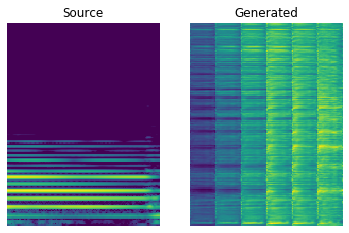

Mean D loss: 0.018920540809631348 Mean G loss: 1.4363256692886353 Mean ID loss: 0.07600972056388855
[Epoch 2951/5000] [Batch 0] [D loss f: 0.010654035955667496 r: 0.05167430639266968] [G loss: 1.4696568250656128] [ID loss: 0.0800156518816948] [LR: 0.0002]
Time/Batch 0.04111490249633789
Mean D loss: 0.061453595757484436 Mean G loss: 1.2439194917678833 Mean ID loss: 0.08365055173635483
[Epoch 2952/5000] [Batch 0] [D loss f: 0.061453595757484436 r: 0.0824693813920021] [G loss: 1.2408004999160767] [ID loss: 0.08060862869024277] [LR: 0.0002]
Time/Batch 0.03687076568603516
Mean D loss: 0.007456731051206589 Mean G loss: 1.3479195833206177 Mean ID loss: 0.07706890255212784
[Epoch 2953/5000] [Batch 0] [D loss f: 0.007456731051206589 r: 0.084206722676754] [G loss: 1.3237571716308594] [ID loss: 0.07614646106958389] [LR: 0.0002]
Time/Batch 0.036822175979614256
Mean D loss: 0.01822175271809101 Mean G loss: 1.4503682851791382 Mean ID loss: 0.0750955119729042
[Epoch 2954/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:03, 630.81it/s, loss=1.07e-5, spectral_convergence=-11.5]

Time/Batch 0.036913728713989256
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 849.66it/s, loss=5.69e-5, spectral_convergence=-16.5]


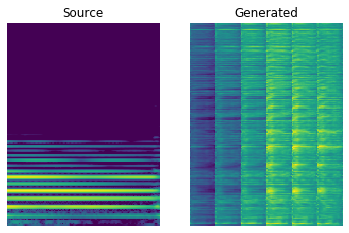

Mean D loss: 0.02257886715233326 Mean G loss: 1.2568334341049194 Mean ID loss: 0.07108989357948303
[Epoch 3001/5000] [Batch 0] [D loss f: 0.013446825556457043 r: 0.051842350512742996] [G loss: 1.2928193807601929] [ID loss: 0.07203426212072372] [LR: 0.0002]
Time/Batch 0.041828489303588866
Mean D loss: 0.009999463334679604 Mean G loss: 1.3791122436523438 Mean ID loss: 0.07682066410779953
[Epoch 3002/5000] [Batch 0] [D loss f: 0.009999463334679604 r: 0.08021760731935501] [G loss: 1.3691716194152832] [ID loss: 0.07790248841047287] [LR: 0.0002]
Time/Batch 0.03689751625061035
Mean D loss: 0.01516201626509428 Mean G loss: 1.299700140953064 Mean ID loss: 0.08659413456916809
[Epoch 3003/5000] [Batch 0] [D loss f: 0.01516201626509428 r: 0.04204866290092468] [G loss: 1.3337196111679077] [ID loss: 0.0881081148982048] [LR: 0.0002]
Time/Batch 0.03682260513305664
Mean D loss: 0.03157222270965576 Mean G loss: 1.397957682609558 Mean ID loss: 0.08077957481145859
[Epoch 3004/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:02, 690.80it/s, loss=4.84e-6, spectral_convergence=-11.4]

Time/Batch 0.036910200119018556
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 849.92it/s, loss=3.03e-5, spectral_convergence=-27.3]


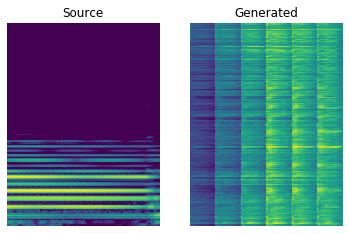

Mean D loss: 0.15015234053134918 Mean G loss: 0.7769134640693665 Mean ID loss: 0.07999381422996521
[Epoch 3051/5000] [Batch 0] [D loss f: 0.1078844666481018 r: 0.26706188917160034] [G loss: 0.8582191467285156] [ID loss: 0.08039919286966324] [LR: 0.0002]
Time/Batch 0.04228501319885254
Mean D loss: 0.107188381254673 Mean G loss: 1.406577706336975 Mean ID loss: 0.07500788569450378
[Epoch 3052/5000] [Batch 0] [D loss f: 0.09027820080518723 r: 0.16113553941249847] [G loss: 1.4326320886611938] [ID loss: 0.07176221162080765] [LR: 0.0002]
Time/Batch 0.036761236190795896
Mean D loss: 0.028810331597924232 Mean G loss: 1.2282899618148804 Mean ID loss: 0.06242275610566139
[Epoch 3053/5000] [Batch 0] [D loss f: 0.022717028856277466 r: 0.06130558252334595] [G loss: 1.3178478479385376] [ID loss: 0.06800577044487] [LR: 0.0002]
Time/Batch 0.03688869476318359
Mean D loss: 0.0287387166172266 Mean G loss: 1.5638278722763062 Mean ID loss: 0.078526072204113
[Epoch 3054/5000] [Batch 0] [D loss f: 0.028738716

  2%|▏         | 40/2000 [00:00<00:02, 676.75it/s, loss=1.36e-6, spectral_convergence=-10.6]

Time/Batch 0.03714971542358399
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 841.78it/s, loss=0.000304, spectral_convergence=-15.4]


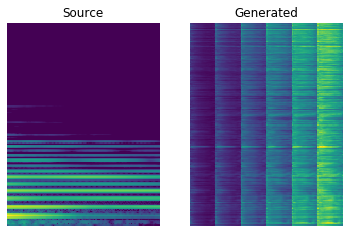

Mean D loss: 0.0286294873803854 Mean G loss: 1.1122455596923828 Mean ID loss: 0.06662200391292572
[Epoch 3101/5000] [Batch 0] [D loss f: 0.027302267029881477 r: 0.10503688454627991] [G loss: 1.0952028036117554] [ID loss: 0.06778430938720703] [LR: 0.0002]
Time/Batch 0.04299249649047852
Mean D loss: 0.01679462008178234 Mean G loss: 1.150327205657959 Mean ID loss: 0.06846146285533905
[Epoch 3102/5000] [Batch 0] [D loss f: 0.013970446772873402 r: 0.0798724964261055] [G loss: 1.2635031938552856] [ID loss: 0.06747688353061676] [LR: 0.0002]
Time/Batch 0.03758716583251953
Mean D loss: 0.03428497165441513 Mean G loss: 1.636351466178894 Mean ID loss: 0.061782319098711014
[Epoch 3103/5000] [Batch 0] [D loss f: 0.056721050292253494 r: 0.13288749754428864] [G loss: 1.5215710401535034] [ID loss: 0.0651077851653099] [LR: 0.0002]
Time/Batch 0.037469005584716795
Mean D loss: 0.05615806579589844 Mean G loss: 1.2761189937591553 Mean ID loss: 0.07845094054937363
[Epoch 3104/5000] [Batch 0] [D loss f: 0.03

  2%|▏         | 40/2000 [00:00<00:02, 677.07it/s, loss=0.000133, spectral_convergence=-10.7]

Time/Batch 0.037430858612060545
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 832.03it/s, loss=2.47e-5, spectral_convergence=-27.2]


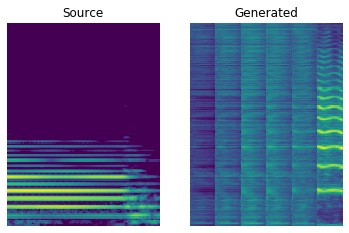

Mean D loss: 0.06369498372077942 Mean G loss: 1.6510292291641235 Mean ID loss: 0.07264647632837296
[Epoch 3151/5000] [Batch 0] [D loss f: 0.07490190118551254 r: 0.0750681683421135] [G loss: 1.5281003713607788] [ID loss: 0.07391956448554993] [LR: 0.0002]
Time/Batch 0.04123644828796387
Mean D loss: 0.03836507722735405 Mean G loss: 1.2254310846328735 Mean ID loss: 0.06507431715726852
[Epoch 3152/5000] [Batch 0] [D loss f: 0.027506321668624878 r: 0.13561014831066132] [G loss: 1.2494579553604126] [ID loss: 0.06436864286661148] [LR: 0.0002]
Time/Batch 0.03735685348510742
Mean D loss: 0.03362711891531944 Mean G loss: 1.1398804187774658 Mean ID loss: 0.07811471819877625
[Epoch 3153/5000] [Batch 0] [D loss f: 0.04621922969818115 r: 0.09333627671003342] [G loss: 1.109429955482483] [ID loss: 0.07752121239900589] [LR: 0.0002]
Time/Batch 0.03722395896911621
Mean D loss: 0.0461815781891346 Mean G loss: 1.134278655052185 Mean ID loss: 0.07151084393262863
[Epoch 3154/5000] [Batch 0] [D loss f: 0.03324

  2%|▏         | 40/2000 [00:00<00:02, 660.54it/s, loss=3.25e-5, spectral_convergence=-12.4]

Time/Batch 0.037550735473632815
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 848.94it/s, loss=1.98e-5, spectral_convergence=-33.9]


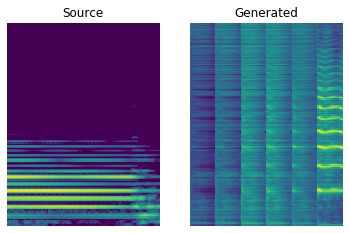

Mean D loss: 0.06372467428445816 Mean G loss: 1.2177419662475586 Mean ID loss: 0.08288287371397018
[Epoch 3201/5000] [Batch 0] [D loss f: 0.051971230655908585 r: 0.08707886934280396] [G loss: 1.2382265329360962] [ID loss: 0.07591726630926132] [LR: 0.0002]
Time/Batch 0.043212366104125974
Mean D loss: 0.058458808809518814 Mean G loss: 1.4378145933151245 Mean ID loss: 0.06295225769281387
[Epoch 3202/5000] [Batch 0] [D loss f: 0.05856749042868614 r: 0.04918816685676575] [G loss: 1.4547256231307983] [ID loss: 0.06400910764932632] [LR: 0.0002]
Time/Batch 0.03742084503173828
Mean D loss: 0.046483684331178665 Mean G loss: 1.260213017463684 Mean ID loss: 0.05999389663338661
[Epoch 3203/5000] [Batch 0] [D loss f: 0.04058419167995453 r: 0.10472941398620605] [G loss: 1.2867039442062378] [ID loss: 0.059810977429151535] [LR: 0.0002]
Time/Batch 0.03739490509033203
Mean D loss: 0.011097515933215618 Mean G loss: 1.5337361097335815 Mean ID loss: 0.06564266234636307
[Epoch 3204/5000] [Batch 0] [D loss f:

  2%|▏         | 40/2000 [00:00<00:02, 657.46it/s, loss=0.000356, spectral_convergence=-8.62]

Time/Batch 0.03731980323791504
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 836.05it/s, loss=4.27e-5, spectral_convergence=-14.9]


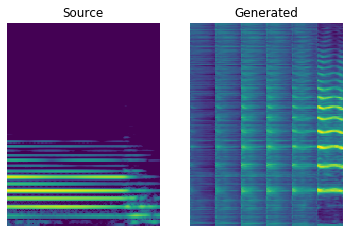

Mean D loss: 0.035019613802433014 Mean G loss: 1.30764639377594 Mean ID loss: 0.05716295167803764
[Epoch 3251/5000] [Batch 0] [D loss f: 0.07346069812774658 r: 0.07936569303274155] [G loss: 1.1891883611679077] [ID loss: 0.05809145048260689] [LR: 0.0002]
Time/Batch 0.04137949943542481
Mean D loss: 0.06551041454076767 Mean G loss: 1.0057075023651123 Mean ID loss: 0.058165859431028366
[Epoch 3252/5000] [Batch 0] [D loss f: 0.027069324627518654 r: 0.1267908364534378] [G loss: 1.1189101934432983] [ID loss: 0.05780348181724548] [LR: 0.0002]
Time/Batch 0.03750166893005371
Mean D loss: 0.05639615282416344 Mean G loss: 1.3534120321273804 Mean ID loss: 0.057143256068229675
[Epoch 3253/5000] [Batch 0] [D loss f: 0.05639615282416344 r: 0.0915982648730278] [G loss: 1.3479377031326294] [ID loss: 0.059843551367521286] [LR: 0.0002]
Time/Batch 0.03725457191467285
Mean D loss: 0.028513489291071892 Mean G loss: 1.1624723672866821 Mean ID loss: 0.06653380393981934
[Epoch 3254/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:03, 618.81it/s, loss=8.69e-6, spectral_convergence=-11.5]

Time/Batch 0.03728218078613281
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 835.16it/s, loss=2.27e-5, spectral_convergence=-33]  


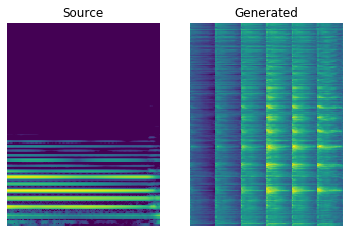

Mean D loss: 0.05367477610707283 Mean G loss: 1.1070653200149536 Mean ID loss: 0.06267670542001724
[Epoch 3301/5000] [Batch 0] [D loss f: 0.054448604583740234 r: 0.1281590610742569] [G loss: 1.1505762338638306] [ID loss: 0.06036863848567009] [LR: 0.0002]
Time/Batch 0.0431941032409668
Mean D loss: 0.080759696662426 Mean G loss: 1.1822491884231567 Mean ID loss: 0.05958421900868416
[Epoch 3302/5000] [Batch 0] [D loss f: 0.0638754740357399 r: 0.06312232464551926] [G loss: 1.2226499319076538] [ID loss: 0.06816483289003372] [LR: 0.0002]
Time/Batch 0.03733682632446289
Mean D loss: 0.08588167279958725 Mean G loss: 1.3791559934616089 Mean ID loss: 0.08068082481622696
[Epoch 3303/5000] [Batch 0] [D loss f: 0.10946550965309143 r: 0.20360030233860016] [G loss: 1.287354826927185] [ID loss: 0.07353181391954422] [LR: 0.0002]
Time/Batch 0.03724055290222168
Mean D loss: 0.053704094141721725 Mean G loss: 0.9586939215660095 Mean ID loss: 0.06083151325583458
[Epoch 3304/5000] [Batch 0] [D loss f: 0.035585

  2%|▎         | 50/2000 [00:00<00:02, 714.10it/s, loss=0.00123, spectral_convergence=-6.34]

Time/Batch 0.037346601486206055
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 847.64it/s, loss=4.37e-5, spectral_convergence=-14.5]


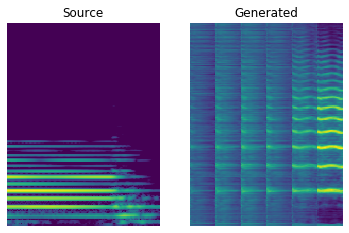

Mean D loss: 0.0508815236389637 Mean G loss: 1.2435373067855835 Mean ID loss: 0.052062202244997025
[Epoch 3351/5000] [Batch 0] [D loss f: 0.07071030884981155 r: 0.1806064397096634] [G loss: 1.1565245389938354] [ID loss: 0.05289895460009575] [LR: 0.0002]
Time/Batch 0.042210721969604494
Mean D loss: 0.04491277039051056 Mean G loss: 1.0259357690811157 Mean ID loss: 0.05477238819003105
[Epoch 3352/5000] [Batch 0] [D loss f: 0.030380720272660255 r: 0.16008354723453522] [G loss: 1.0633089542388916] [ID loss: 0.053992658853530884] [LR: 0.0002]
Time/Batch 0.03740935325622559
Mean D loss: 0.04101186990737915 Mean G loss: 1.5107382535934448 Mean ID loss: 0.052320364862680435
[Epoch 3353/5000] [Batch 0] [D loss f: 0.03624230995774269 r: 0.1942574381828308] [G loss: 1.4922829866409302] [ID loss: 0.05528418347239494] [LR: 0.0002]
Time/Batch 0.03705892562866211
Mean D loss: 0.02708272822201252 Mean G loss: 1.2192611694335938 Mean ID loss: 0.06629905849695206
[Epoch 3354/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:02, 671.03it/s, loss=0.0235, spectral_convergence=-1.08]

Time/Batch 0.037034225463867185
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 859.31it/s, loss=9.35e-6, spectral_convergence=-36.4]


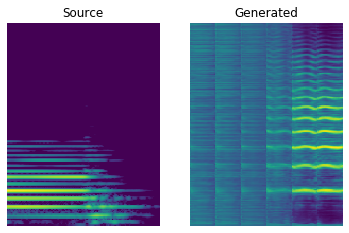

Mean D loss: 0.03605096787214279 Mean G loss: 1.414677619934082 Mean ID loss: 0.06392509490251541
[Epoch 3401/5000] [Batch 0] [D loss f: 0.04277564585208893 r: 0.10945534706115723] [G loss: 1.3378634452819824] [ID loss: 0.06363055109977722] [LR: 0.0002]
Time/Batch 0.04200997352600098
Mean D loss: 0.05186377838253975 Mean G loss: 1.3675984144210815 Mean ID loss: 0.07467629015445709
[Epoch 3402/5000] [Batch 0] [D loss f: 0.04513910040259361 r: 0.07121410965919495] [G loss: 1.4299918413162231] [ID loss: 0.07529565691947937] [LR: 0.0002]
Time/Batch 0.03761677742004395
Mean D loss: 0.013260387815535069 Mean G loss: 1.4826455116271973 Mean ID loss: 0.06559961289167404
[Epoch 3403/5000] [Batch 0] [D loss f: 0.02810053527355194 r: 0.057355839759111404] [G loss: 1.4248796701431274] [ID loss: 0.0658363625407219] [LR: 0.0002]
Time/Batch 0.03707399368286133
Mean D loss: 0.03616036847233772 Mean G loss: 1.4287506341934204 Mean ID loss: 0.05986820533871651
[Epoch 3404/5000] [Batch 0] [D loss f: 0.02

  2%|▏         | 40/2000 [00:00<00:02, 694.99it/s, loss=0.00707, spectral_convergence=-3.17]

Time/Batch 0.037213373184204104
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 847.47it/s, loss=1.05e-5, spectral_convergence=-31.7]


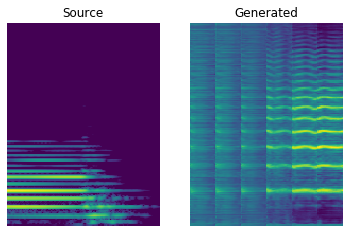

Mean D loss: 0.06703805923461914 Mean G loss: 1.4502121210098267 Mean ID loss: 0.0525570847094059
[Epoch 3451/5000] [Batch 0] [D loss f: 0.07258725166320801 r: 0.09246597439050674] [G loss: 1.4806751012802124] [ID loss: 0.05315960571169853] [LR: 0.0002]
Time/Batch 0.04112124443054199
Mean D loss: 0.019169451668858528 Mean G loss: 1.5121835470199585 Mean ID loss: 0.06246750056743622
[Epoch 3452/5000] [Batch 0] [D loss f: 0.07811746746301651 r: 0.08878761529922485] [G loss: 1.3520561456680298] [ID loss: 0.061163559556007385] [LR: 0.0002]
Time/Batch 0.03729920387268067
Mean D loss: 0.1266246885061264 Mean G loss: 0.8711668848991394 Mean ID loss: 0.0590880922973156
[Epoch 3453/5000] [Batch 0] [D loss f: 0.09285932779312134 r: 0.14327871799468994] [G loss: 0.9186975359916687] [ID loss: 0.06063561141490936] [LR: 0.0002]
Time/Batch 0.03695988655090332
Mean D loss: 0.14216959476470947 Mean G loss: 1.3267062902450562 Mean ID loss: 0.06105981394648552
[Epoch 3454/5000] [Batch 0] [D loss f: 0.141

  2%|▏         | 30/2000 [00:00<00:03, 566.45it/s, loss=8.51e-5, spectral_convergence=-8.84] 

Time/Batch 0.037096500396728516
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 824.14it/s, loss=1.65e-5, spectral_convergence=-36.7]


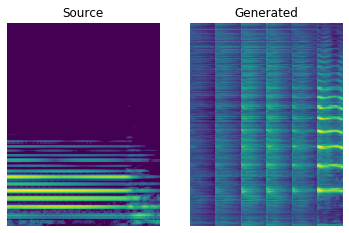

Mean D loss: 0.055441197007894516 Mean G loss: 1.1796579360961914 Mean ID loss: 0.05012943968176842
[Epoch 3501/5000] [Batch 0] [D loss f: 0.05947953090071678 r: 0.12392815202474594] [G loss: 1.1538152694702148] [ID loss: 0.05045405030250549] [LR: 0.0002]
Time/Batch 0.04287848472595215
Mean D loss: 0.060908328741788864 Mean G loss: 1.3715500831604004 Mean ID loss: 0.05652192607522011
[Epoch 3502/5000] [Batch 0] [D loss f: 0.06403219699859619 r: 0.12421635538339615] [G loss: 1.3710309267044067] [ID loss: 0.05665530264377594] [LR: 0.0002]
Time/Batch 0.03725447654724121
Mean D loss: 0.04789939895272255 Mean G loss: 1.071179986000061 Mean ID loss: 0.05432906374335289
[Epoch 3503/5000] [Batch 0] [D loss f: 0.04062116518616676 r: 0.150634303689003] [G loss: 1.067226529121399] [ID loss: 0.05347687378525734] [LR: 0.0002]
Time/Batch 0.036768770217895506
Mean D loss: 0.05012119933962822 Mean G loss: 1.2972668409347534 Mean ID loss: 0.05247832462191582
[Epoch 3504/5000] [Batch 0] [D loss f: 0.064

  2%|▏         | 40/2000 [00:00<00:02, 665.71it/s, loss=2.55e-5, spectral_convergence=-10.1]

Time/Batch 0.03719110488891601
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 836.88it/s, loss=3.37e-5, spectral_convergence=-25.6]


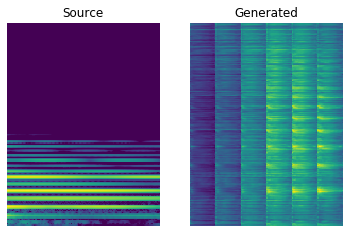

Mean D loss: 0.026720857247710228 Mean G loss: 1.4840134382247925 Mean ID loss: 0.05202921852469444
[Epoch 3551/5000] [Batch 0] [D loss f: 0.031258441507816315 r: 0.18659472465515137] [G loss: 1.4622831344604492] [ID loss: 0.05528867244720459] [LR: 0.0002]
Time/Batch 0.04246745109558105
Mean D loss: 0.15700365602970123 Mean G loss: 1.4336090087890625 Mean ID loss: 0.0584208182990551
[Epoch 3552/5000] [Batch 0] [D loss f: 0.16152498126029968 r: 0.10590672492980957] [G loss: 1.4117778539657593] [ID loss: 0.057644981890916824] [LR: 0.0002]
Time/Batch 0.03704566955566406
Mean D loss: 0.03760739788413048 Mean G loss: 1.1723623275756836 Mean ID loss: 0.05932179465889931
[Epoch 3553/5000] [Batch 0] [D loss f: 0.037858545780181885 r: 0.07969339936971664] [G loss: 1.1906580924987793] [ID loss: 0.05974018573760986] [LR: 0.0002]
Time/Batch 0.03694930076599121
Mean D loss: 0.04380961135029793 Mean G loss: 1.297589659690857 Mean ID loss: 0.05860134959220886
[Epoch 3554/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:02, 670.21it/s, loss=2.14e-5, spectral_convergence=-10.9]

Time/Batch 0.03697848320007324
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 846.62it/s, loss=5.3e-5, spectral_convergence=-14.7] 


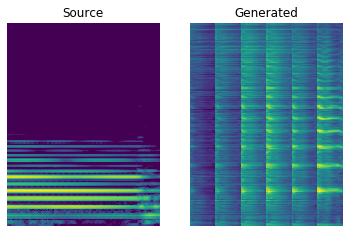

Mean D loss: 0.05760394409298897 Mean G loss: 1.3435258865356445 Mean ID loss: 0.05234009400010109
[Epoch 3601/5000] [Batch 0] [D loss f: 0.05760394409298897 r: 0.13639988005161285] [G loss: 1.3142799139022827] [ID loss: 0.05646541714668274] [LR: 0.0002]
Time/Batch 0.04278984069824219
Mean D loss: 0.05773157998919487 Mean G loss: 1.4389381408691406 Mean ID loss: 0.06385212391614914
[Epoch 3602/5000] [Batch 0] [D loss f: 0.06661143898963928 r: 0.0800786092877388] [G loss: 1.4462246894836426] [ID loss: 0.059561699628829956] [LR: 0.0002]
Time/Batch 0.03686809539794922
Mean D loss: 0.05199088528752327 Mean G loss: 1.294978380203247 Mean ID loss: 0.0610337071120739
[Epoch 3603/5000] [Batch 0] [D loss f: 0.04311102256178856 r: 0.15165893733501434] [G loss: 1.361037254333496] [ID loss: 0.06080106273293495] [LR: 0.0002]
Time/Batch 0.03690314292907715
Mean D loss: 0.010205424390733242 Mean G loss: 1.4056111574172974 Mean ID loss: 0.06949793547391891
[Epoch 3604/5000] [Batch 0] [D loss f: 0.0615

  2%|▎         | 50/2000 [00:00<00:02, 709.41it/s, loss=4.15e-6, spectral_convergence=-11.5]

Time/Batch 0.03694610595703125
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 837.97it/s, loss=7.18e-5, spectral_convergence=-34.1] 


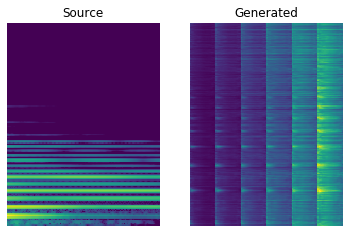

Mean D loss: 0.08832181245088577 Mean G loss: 0.9840211868286133 Mean ID loss: 0.0575256310403347
[Epoch 3651/5000] [Batch 0] [D loss f: 0.11119524389505386 r: 0.1678580641746521] [G loss: 0.9258249402046204] [ID loss: 0.0565757192671299] [LR: 0.0002]
Time/Batch 0.04256381988525391
Mean D loss: 0.11281368881464005 Mean G loss: 0.8597097396850586 Mean ID loss: 0.06935149431228638
[Epoch 3652/5000] [Batch 0] [D loss f: 0.08154501765966415 r: 0.1424492597579956] [G loss: 0.9749245643615723] [ID loss: 0.070685975253582] [LR: 0.0002]
Time/Batch 0.03735990524291992
Mean D loss: 0.05121772363781929 Mean G loss: 1.4351658821105957 Mean ID loss: 0.05740747228264809
[Epoch 3653/5000] [Batch 0] [D loss f: 0.0548265315592289 r: 0.208799347281456] [G loss: 1.3710966110229492] [ID loss: 0.05520167574286461] [LR: 0.0002]
Time/Batch 0.0368438720703125
Mean D loss: 0.028608985245227814 Mean G loss: 1.3353047370910645 Mean ID loss: 0.05089862272143364
[Epoch 3654/5000] [Batch 0] [D loss f: 0.03852286934

  2%|▏         | 40/2000 [00:00<00:02, 668.66it/s, loss=7.75e-6, spectral_convergence=-11.9]

Time/Batch 0.03720593452453613
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 849.04it/s, loss=0.000255, spectral_convergence=-20.7]


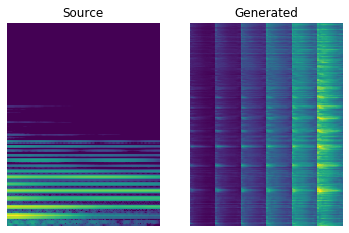

Mean D loss: 0.04773249104619026 Mean G loss: 1.4699010848999023 Mean ID loss: 0.05435184761881828
[Epoch 3701/5000] [Batch 0] [D loss f: 0.04258078336715698 r: 0.14024467766284943] [G loss: 1.4549061059951782] [ID loss: 0.05312195047736168] [LR: 0.0002]
Time/Batch 0.04239974021911621
Mean D loss: 0.08844756335020065 Mean G loss: 1.4361411333084106 Mean ID loss: 0.054543282836675644
[Epoch 3702/5000] [Batch 0] [D loss f: 0.10316681861877441 r: 0.08048979192972183] [G loss: 1.3571611642837524] [ID loss: 0.05722283199429512] [LR: 0.0002]
Time/Batch 0.036836099624633786
Mean D loss: 0.05605117604136467 Mean G loss: 1.3574882745742798 Mean ID loss: 0.05912447348237038
[Epoch 3703/5000] [Batch 0] [D loss f: 0.04758036136627197 r: 0.18303199112415314] [G loss: 1.3941092491149902] [ID loss: 0.05694030597805977] [LR: 0.0002]
Time/Batch 0.03663721084594727
Mean D loss: 0.0276501327753067 Mean G loss: 1.3834155797958374 Mean ID loss: 0.05912288650870323
[Epoch 3704/5000] [Batch 0] [D loss f: 0.0

  2%|▏         | 40/2000 [00:00<00:03, 611.85it/s, loss=0.00207, spectral_convergence=-5.83]

Time/Batch 0.03713488578796387
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 837.12it/s, loss=2.13e-5, spectral_convergence=-27.8]


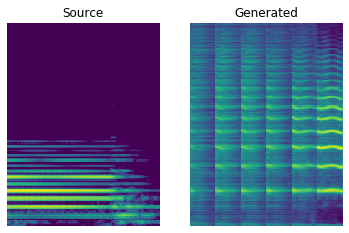

Mean D loss: 0.09217411279678345 Mean G loss: 1.4645391702651978 Mean ID loss: 0.051490943878889084
[Epoch 3751/5000] [Batch 0] [D loss f: 0.08566969633102417 r: 0.15144483745098114] [G loss: 1.523065447807312] [ID loss: 0.05439434573054314] [LR: 0.0002]
Time/Batch 0.04196290969848633
Mean D loss: 0.11006676405668259 Mean G loss: 1.6913162469863892 Mean ID loss: 0.059216275811195374
[Epoch 3752/5000] [Batch 0] [D loss f: 0.129886656999588 r: 0.1620684713125229] [G loss: 1.6479719877243042] [ID loss: 0.057917241007089615] [LR: 0.0002]
Time/Batch 0.03766989707946777
Mean D loss: 0.29351213574409485 Mean G loss: 1.1410821676254272 Mean ID loss: 0.06193782761693001
[Epoch 3753/5000] [Batch 0] [D loss f: 0.30875396728515625 r: 0.3395054042339325] [G loss: 1.112845778465271] [ID loss: 0.0610610656440258] [LR: 0.0002]
Time/Batch 0.0367070198059082
Mean D loss: 0.10527047514915466 Mean G loss: 1.1038700342178345 Mean ID loss: 0.0517156720161438
[Epoch 3754/5000] [Batch 0] [D loss f: 0.08922227

  2%|▏         | 40/2000 [00:00<00:02, 677.57it/s, loss=3.9e-6, spectral_convergence=-12.3] 

Time/Batch 0.03683185577392578
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 848.51it/s, loss=0.00018, spectral_convergence=-22.9] 


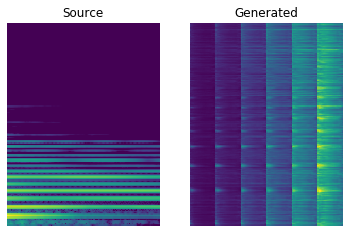

Mean D loss: 0.18189547955989838 Mean G loss: 1.5878404378890991 Mean ID loss: 0.05703473091125488
[Epoch 3801/5000] [Batch 0] [D loss f: 0.18189547955989838 r: 0.2708953619003296] [G loss: 1.6224637031555176] [ID loss: 0.05902906879782677] [LR: 0.0002]
Time/Batch 0.041549968719482425
Mean D loss: 0.3275375962257385 Mean G loss: 1.6898225545883179 Mean ID loss: 0.0600152425467968
[Epoch 3802/5000] [Batch 0] [D loss f: 0.3480958640575409 r: 0.323764830827713] [G loss: 1.5922231674194336] [ID loss: 0.060392413288354874] [LR: 0.0002]
Time/Batch 0.03694438934326172
Mean D loss: 0.13879847526550293 Mean G loss: 1.2032246589660645 Mean ID loss: 0.05636405944824219
[Epoch 3803/5000] [Batch 0] [D loss f: 0.17872701585292816 r: 0.21632754802703857] [G loss: 1.159258246421814] [ID loss: 0.053743358701467514] [LR: 0.0002]
Time/Batch 0.03685088157653808
Mean D loss: 0.13656222820281982 Mean G loss: 0.9854960441589355 Mean ID loss: 0.049331407994031906
[Epoch 3804/5000] [Batch 0] [D loss f: 0.07607

  2%|▏         | 40/2000 [00:00<00:03, 631.28it/s, loss=1.93e-7, spectral_convergence=-7.67]

Time/Batch 0.03764152526855469
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 833.97it/s, loss=0.000484, spectral_convergence=-25.1]


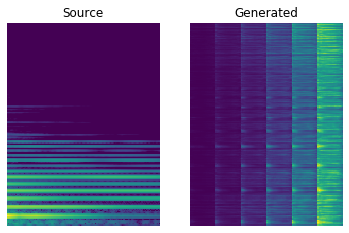

Mean D loss: 0.040230412036180496 Mean G loss: 1.17391836643219 Mean ID loss: 0.055960070341825485
[Epoch 3851/5000] [Batch 0] [D loss f: 0.03203533962368965 r: 0.13951903581619263] [G loss: 1.1529184579849243] [ID loss: 0.05362788960337639] [LR: 0.0002]
Time/Batch 0.04257059097290039
Mean D loss: 0.0742378830909729 Mean G loss: 1.3324919939041138 Mean ID loss: 0.04696178808808327
[Epoch 3852/5000] [Batch 0] [D loss f: 0.07813572138547897 r: 0.11875296384096146] [G loss: 1.3705765008926392] [ID loss: 0.050081897526979446] [LR: 0.0002]
Time/Batch 0.03686685562133789
Mean D loss: 0.0579088032245636 Mean G loss: 1.2681193351745605 Mean ID loss: 0.06385117769241333
[Epoch 3853/5000] [Batch 0] [D loss f: 0.046723708510398865 r: 0.16720068454742432] [G loss: 1.2708741426467896] [ID loss: 0.06037718057632446] [LR: 0.0002]
Time/Batch 0.0367772102355957
Mean D loss: 0.06104566529393196 Mean G loss: 1.480044960975647 Mean ID loss: 0.05612057074904442
[Epoch 3854/5000] [Batch 0] [D loss f: 0.0723

  2%|▏         | 40/2000 [00:00<00:02, 675.48it/s, loss=0.000164, spectral_convergence=-8.05]

Time/Batch 0.03688821792602539
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 835.67it/s, loss=4.93e-5, spectral_convergence=-16.2]


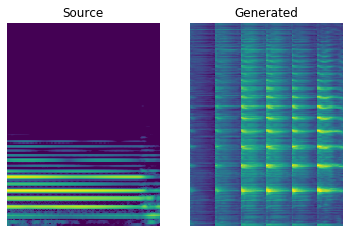

Mean D loss: 0.16607332229614258 Mean G loss: 1.3071597814559937 Mean ID loss: 0.04555240646004677
[Epoch 3901/5000] [Batch 0] [D loss f: 0.13041475415229797 r: 0.21830137073993683] [G loss: 1.4237403869628906] [ID loss: 0.045276034623384476] [LR: 0.0002]
Time/Batch 0.04225058555603027
Mean D loss: 0.09875641018152237 Mean G loss: 1.6506789922714233 Mean ID loss: 0.04842807725071907
[Epoch 3902/5000] [Batch 0] [D loss f: 0.09875641018152237 r: 0.18879497051239014] [G loss: 1.6410919427871704] [ID loss: 0.04837670549750328] [LR: 0.0002]
Time/Batch 0.03673052787780762
Mean D loss: 0.08677369356155396 Mean G loss: 1.4789901971817017 Mean ID loss: 0.05561204254627228
[Epoch 3903/5000] [Batch 0] [D loss f: 0.09420343488454819 r: 0.23404674232006073] [G loss: 1.4355039596557617] [ID loss: 0.05612797662615776] [LR: 0.0002]
Time/Batch 0.03687410354614258
Mean D loss: 0.08511867374181747 Mean G loss: 1.1841998100280762 Mean ID loss: 0.05265050008893013
[Epoch 3904/5000] [Batch 0] [D loss f: 0.0

  2%|▏         | 30/2000 [00:00<00:03, 625.77it/s, loss=0.00131, spectral_convergence=-4.98]

Time/Batch 0.03747382164001465
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 846.82it/s, loss=3.3e-5, spectral_convergence=-17.1] 


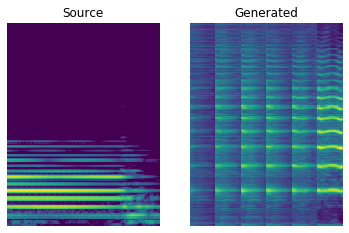

Mean D loss: 0.075833760201931 Mean G loss: 1.150253176689148 Mean ID loss: 0.05138238146901131
[Epoch 3951/5000] [Batch 0] [D loss f: 0.061907678842544556 r: 0.17286765575408936] [G loss: 1.2066868543624878] [ID loss: 0.050764624029397964] [LR: 0.0002]
Time/Batch 0.042413187026977536
Mean D loss: 0.0423738919198513 Mean G loss: 1.2161003351211548 Mean ID loss: 0.047765690833330154
[Epoch 3952/5000] [Batch 0] [D loss f: 0.06573092937469482 r: 0.16827602684497833] [G loss: 1.146480679512024] [ID loss: 0.04825848340988159] [LR: 0.0002]
Time/Batch 0.03683638572692871
Mean D loss: 0.06946320086717606 Mean G loss: 1.1437653303146362 Mean ID loss: 0.05174954608082771
[Epoch 3953/5000] [Batch 0] [D loss f: 0.04749506711959839 r: 0.22239606082439423] [G loss: 1.2359404563903809] [ID loss: 0.05077013373374939] [LR: 0.0002]
Time/Batch 0.03705716133117676
Mean D loss: 0.1431112438440323 Mean G loss: 1.1233422756195068 Mean ID loss: 0.0463939905166626
[Epoch 3954/5000] [Batch 0] [D loss f: 0.17847

  2%|▏         | 40/2000 [00:00<00:03, 646.84it/s, loss=1.14e-5, spectral_convergence=-11.8]

Time/Batch 0.03690333366394043
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 862.83it/s, loss=6.67e-5, spectral_convergence=-40.9] 


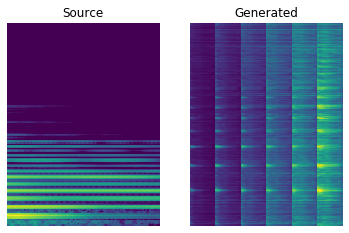

Mean D loss: 0.06293550878763199 Mean G loss: 1.5629724264144897 Mean ID loss: 0.04642980173230171
[Epoch 4001/5000] [Batch 0] [D loss f: 0.07481943070888519 r: 0.14005650579929352] [G loss: 1.5421372652053833] [ID loss: 0.046858493238687515] [LR: 0.0002]
Time/Batch 0.042396926879882814
Mean D loss: 0.08350365608930588 Mean G loss: 1.2822505235671997 Mean ID loss: 0.05335800722241402
[Epoch 4002/5000] [Batch 0] [D loss f: 0.07115131616592407 r: 0.15869414806365967] [G loss: 1.2826086282730103] [ID loss: 0.05473428964614868] [LR: 0.0002]
Time/Batch 0.036947441101074216
Mean D loss: 0.05196208134293556 Mean G loss: 1.2196946144104004 Mean ID loss: 0.05427807196974754
[Epoch 4003/5000] [Batch 0] [D loss f: 0.05196208134293556 r: 0.15845529735088348] [G loss: 1.222946047782898] [ID loss: 0.05550890043377876] [LR: 0.0002]
Time/Batch 0.03696308135986328
Mean D loss: 0.058152537792921066 Mean G loss: 1.2846099138259888 Mean ID loss: 0.05494280532002449
[Epoch 4004/5000] [Batch 0] [D loss f: 0

  2%|▏         | 40/2000 [00:00<00:02, 686.26it/s, loss=0.00145, spectral_convergence=-5.28]

Time/Batch 0.03681502342224121
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 854.37it/s, loss=4.04e-5, spectral_convergence=-12.5]


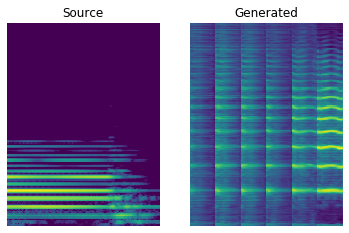

Mean D loss: 0.10570337623357773 Mean G loss: 1.4227089881896973 Mean ID loss: 0.050475966185331345
[Epoch 4051/5000] [Batch 0] [D loss f: 0.10809743404388428 r: 0.21227388083934784] [G loss: 1.4149521589279175] [ID loss: 0.04840366542339325] [LR: 0.0002]
Time/Batch 0.041675901412963866
Mean D loss: 0.07927953451871872 Mean G loss: 1.0876795053482056 Mean ID loss: 0.05652236565947533
[Epoch 4052/5000] [Batch 0] [D loss f: 0.08357283473014832 r: 0.2199159860610962] [G loss: 1.0609716176986694] [ID loss: 0.061177562922239304] [LR: 0.0002]
Time/Batch 0.037346506118774415
Mean D loss: 0.07934848219156265 Mean G loss: 1.0412790775299072 Mean ID loss: 0.06046481803059578
[Epoch 4053/5000] [Batch 0] [D loss f: 0.08018464595079422 r: 0.13487295806407928] [G loss: 1.061484694480896] [ID loss: 0.05607853829860687] [LR: 0.0002]
Time/Batch 0.03684148788452148
Mean D loss: 0.03343554586172104 Mean G loss: 1.1794682741165161 Mean ID loss: 0.04553064703941345
[Epoch 4054/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:03, 627.96it/s, loss=1.57e-7, spectral_convergence=-7.74]

Time/Batch 0.03675751686096192
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 853.20it/s, loss=0.0065, spectral_convergence=-13.6] 


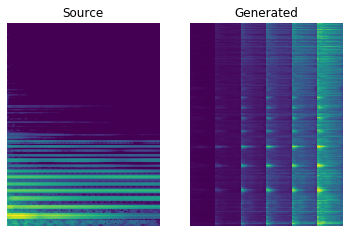

Mean D loss: 0.07835065573453903 Mean G loss: 1.3461565971374512 Mean ID loss: 0.04379250481724739
[Epoch 4101/5000] [Batch 0] [D loss f: 0.09046772867441177 r: 0.17123062908649445] [G loss: 1.3186343908309937] [ID loss: 0.04407070204615593] [LR: 0.0002]
Time/Batch 0.04236249923706055
Mean D loss: 0.042436808347702026 Mean G loss: 1.2396899461746216 Mean ID loss: 0.04809879884123802
[Epoch 4102/5000] [Batch 0] [D loss f: 0.09148707240819931 r: 0.25204217433929443] [G loss: 1.1832705736160278] [ID loss: 0.0483439601957798] [LR: 0.0002]
Time/Batch 0.03702068328857422
Mean D loss: 0.22946560382843018 Mean G loss: 1.2016688585281372 Mean ID loss: 0.045978039503097534
[Epoch 4103/5000] [Batch 0] [D loss f: 0.1678820699453354 r: 0.18965663015842438] [G loss: 1.3270111083984375] [ID loss: 0.045599501579999924] [LR: 0.0002]
Time/Batch 0.03664097785949707
Mean D loss: 0.029710834845900536 Mean G loss: 1.4789501428604126 Mean ID loss: 0.04448916018009186
[Epoch 4104/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:02, 677.78it/s, loss=3.47e-7, spectral_convergence=-10.5]

Time/Batch 0.036953401565551755
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 862.10it/s, loss=0.000557, spectral_convergence=-24.2]


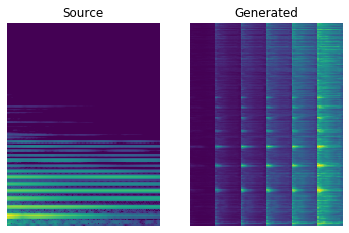

Mean D loss: 0.057339876890182495 Mean G loss: 1.4098048210144043 Mean ID loss: 0.050285276025533676
[Epoch 4151/5000] [Batch 0] [D loss f: 0.07018524408340454 r: 0.22180384397506714] [G loss: 1.3560370206832886] [ID loss: 0.0520634762942791] [LR: 0.0002]
Time/Batch 0.04061989784240723
Mean D loss: 0.05487538501620293 Mean G loss: 1.1459096670150757 Mean ID loss: 0.05248601362109184
[Epoch 4152/5000] [Batch 0] [D loss f: 0.07404922693967819 r: 0.24504242837429047] [G loss: 1.1120500564575195] [ID loss: 0.05182945728302002] [LR: 0.0002]
Time/Batch 0.037018966674804685
Mean D loss: 0.0813554897904396 Mean G loss: 1.0975059270858765 Mean ID loss: 0.049320876598358154
[Epoch 4153/5000] [Batch 0] [D loss f: 0.048344869166612625 r: 0.19774137437343597] [G loss: 1.1778062582015991] [ID loss: 0.04785774648189545] [LR: 0.0002]
Time/Batch 0.03687272071838379
Mean D loss: 0.07181119918823242 Mean G loss: 1.2810169458389282 Mean ID loss: 0.05124801769852638
[Epoch 4154/5000] [Batch 0] [D loss f: 0

  2%|▏         | 40/2000 [00:00<00:02, 660.29it/s, loss=0.000249, spectral_convergence=-10.2]

Time/Batch 0.036902332305908205
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 831.59it/s, loss=2.64e-5, spectral_convergence=-27]  


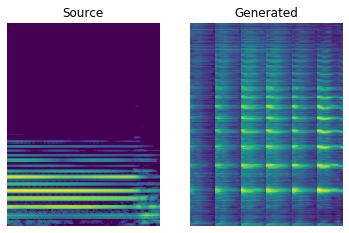

Mean D loss: 0.08219984918832779 Mean G loss: 1.1796211004257202 Mean ID loss: 0.049176979809999466
[Epoch 4201/5000] [Batch 0] [D loss f: 0.06781000643968582 r: 0.28916868567466736] [G loss: 1.2539093494415283] [ID loss: 0.04825020954012871] [LR: 0.0002]
Time/Batch 0.04203224182128906
Mean D loss: 0.05313049629330635 Mean G loss: 1.5090528726577759 Mean ID loss: 0.04808969795703888
[Epoch 4202/5000] [Batch 0] [D loss f: 0.06424690037965775 r: 0.19724814593791962] [G loss: 1.4329339265823364] [ID loss: 0.04787350073456764] [LR: 0.0002]
Time/Batch 0.03672380447387695
Mean D loss: 0.06336069852113724 Mean G loss: 0.9951151013374329 Mean ID loss: 0.045798737555742264
[Epoch 4203/5000] [Batch 0] [D loss f: 0.05396698787808418 r: 0.16982655227184296] [G loss: 1.0355910062789917] [ID loss: 0.04606940224766731] [LR: 0.0002]
Time/Batch 0.03689489364624023
Mean D loss: 0.10735487937927246 Mean G loss: 1.3559411764144897 Mean ID loss: 0.05329667404294014
[Epoch 4204/5000] [Batch 0] [D loss f: 0.

  2%|▎         | 50/2000 [00:00<00:02, 735.38it/s, loss=1.79e-5, spectral_convergence=-8.72]

Time/Batch 0.03683958053588867
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 836.74it/s, loss=0.000195, spectral_convergence=-26.2]


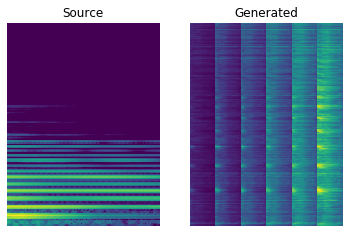

Mean D loss: 0.09131511300802231 Mean G loss: 1.691170334815979 Mean ID loss: 0.05145189166069031
[Epoch 4251/5000] [Batch 0] [D loss f: 0.09939834475517273 r: 0.15796492993831635] [G loss: 1.5818661451339722] [ID loss: 0.05349460616707802] [LR: 0.0002]
Time/Batch 0.04313983917236328
Mean D loss: 0.09342828392982483 Mean G loss: 1.4174224138259888 Mean ID loss: 0.05058827996253967
[Epoch 4252/5000] [Batch 0] [D loss f: 0.09480792284011841 r: 0.1926378756761551] [G loss: 1.4174985885620117] [ID loss: 0.0487830676138401] [LR: 0.0002]
Time/Batch 0.036811017990112306
Mean D loss: 0.0912761315703392 Mean G loss: 1.2045536041259766 Mean ID loss: 0.04419007897377014
[Epoch 4253/5000] [Batch 0] [D loss f: 0.08429362624883652 r: 0.24143706262111664] [G loss: 1.203588604927063] [ID loss: 0.04372793063521385] [LR: 0.0002]
Time/Batch 0.03683838844299316
Mean D loss: 0.09989281743764877 Mean G loss: 1.174208641052246 Mean ID loss: 0.0495680533349514
[Epoch 4254/5000] [Batch 0] [D loss f: 0.13906443

  2%|▏         | 40/2000 [00:00<00:03, 624.32it/s, loss=7.87e-5, spectral_convergence=-10.4] 

Time/Batch 0.03699655532836914
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 844.32it/s, loss=7.27e-5, spectral_convergence=-20.5]


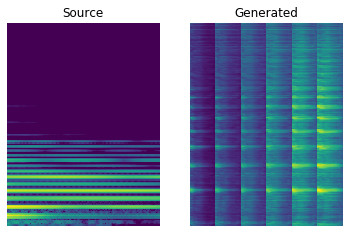

Mean D loss: 0.06103070080280304 Mean G loss: 1.0377490520477295 Mean ID loss: 0.048349201679229736
[Epoch 4301/5000] [Batch 0] [D loss f: 0.047929972410202026 r: 0.24447529017925262] [G loss: 1.0866345167160034] [ID loss: 0.04776163771748543] [LR: 0.0002]
Time/Batch 0.042288351058959964
Mean D loss: 0.12240313738584518 Mean G loss: 0.9063935279846191 Mean ID loss: 0.044505249708890915
[Epoch 4302/5000] [Batch 0] [D loss f: 0.1698642522096634 r: 0.25047141313552856] [G loss: 0.8328695297241211] [ID loss: 0.04789884760975838] [LR: 0.0002]
Time/Batch 0.03702411651611328
Mean D loss: 0.14485548436641693 Mean G loss: 0.9878907799720764 Mean ID loss: 0.05559113621711731
[Epoch 4303/5000] [Batch 0] [D loss f: 0.12358466535806656 r: 0.27528059482574463] [G loss: 0.9983780384063721] [ID loss: 0.05264836922287941] [LR: 0.0002]
Time/Batch 0.036985921859741214
Mean D loss: 0.0903049036860466 Mean G loss: 1.097887396812439 Mean ID loss: 0.045234497636556625
[Epoch 4304/5000] [Batch 0] [D loss f: 0

  2%|▏         | 40/2000 [00:00<00:03, 606.64it/s, loss=1.16e-7, spectral_convergence=-4.78]

Time/Batch 0.036781597137451175
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 846.96it/s, loss=0.00074, spectral_convergence=-37.4] 


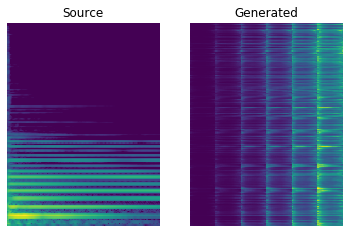

Mean D loss: 0.021976197138428688 Mean G loss: 1.3481694459915161 Mean ID loss: 0.07668914645910263
[Epoch 4351/5000] [Batch 0] [D loss f: 0.007696288172155619 r: 0.012226331047713757] [G loss: 1.3913921117782593] [ID loss: 0.08108624070882797] [LR: 0.0002]
Time/Batch 0.04359822273254395
Mean D loss: 0.008452762849628925 Mean G loss: 1.4036130905151367 Mean ID loss: 0.08356506377458572
[Epoch 4352/5000] [Batch 0] [D loss f: 0.010815312154591084 r: 0.032981026917696] [G loss: 1.3506587743759155] [ID loss: 0.07778248935937881] [LR: 0.0002]
Time/Batch 0.0368654727935791
Mean D loss: 0.013821769505739212 Mean G loss: 1.4993177652359009 Mean ID loss: 0.06969695538282394
[Epoch 4353/5000] [Batch 0] [D loss f: 0.01145921926945448 r: 0.04054933413863182] [G loss: 1.5450571775436401] [ID loss: 0.0704558938741684] [LR: 0.0002]
Time/Batch 0.03683781623840332
Mean D loss: 0.006094479933381081 Mean G loss: 1.321834921836853 Mean ID loss: 0.07841642946004868
[Epoch 4354/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:02, 676.44it/s, loss=1.91e-7, spectral_convergence=-8.53]

Time/Batch 0.03748221397399902
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 825.13it/s, loss=0.00126, spectral_convergence=-31.7]


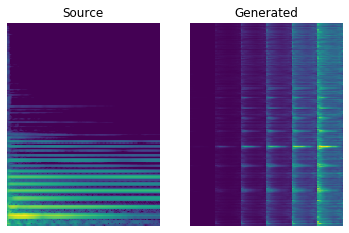

Mean D loss: 0.022782785817980766 Mean G loss: 1.430543303489685 Mean ID loss: 0.07446707040071487
[Epoch 4401/5000] [Batch 0] [D loss f: 0.0012981394538655877 r: 0.0488075315952301] [G loss: 1.4977182149887085] [ID loss: 0.07067123800516129] [LR: 0.0002]
Time/Batch 0.04207620620727539
Mean D loss: 0.002650103298947215 Mean G loss: 1.6209760904312134 Mean ID loss: 0.073089100420475
[Epoch 4402/5000] [Batch 0] [D loss f: 0.002650103298947215 r: 0.026542529463768005] [G loss: 1.585300087928772] [ID loss: 0.07368364930152893] [LR: 0.0002]
Time/Batch 0.03737010955810547
Mean D loss: 0.02196257747709751 Mean G loss: 1.3913451433181763 Mean ID loss: 0.07939238101243973
[Epoch 4403/5000] [Batch 0] [D loss f: 0.025662951171398163 r: 0.08565086126327515] [G loss: 1.3828564882278442] [ID loss: 0.07980097085237503] [LR: 0.0002]
Time/Batch 0.03746809959411621
Mean D loss: 0.008035856299102306 Mean G loss: 1.3509968519210815 Mean ID loss: 0.0650598332285881
[Epoch 4404/5000] [Batch 0] [D loss f: 0.

  2%|▏         | 40/2000 [00:00<00:02, 680.02it/s, loss=0.0126, spectral_convergence=-1.24]

Time/Batch 0.037582921981811526
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 849.25it/s, loss=1.92e-5, spectral_convergence=-14.6]


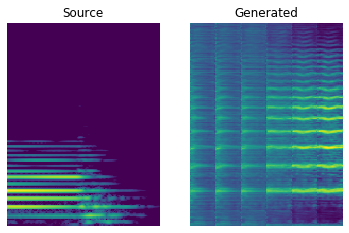

Mean D loss: 0.004111939575523138 Mean G loss: 1.2304660081863403 Mean ID loss: 0.06428104639053345
[Epoch 4451/5000] [Batch 0] [D loss f: 0.0035514843184500933 r: 0.0710894986987114] [G loss: 1.248945713043213] [ID loss: 0.06558335572481155] [LR: 0.0002]
Time/Batch 0.04219975471496582
Mean D loss: 0.006917916238307953 Mean G loss: 1.271746277809143 Mean ID loss: 0.060537707060575485
[Epoch 4452/5000] [Batch 0] [D loss f: 0.006917916238307953 r: 0.06232134997844696] [G loss: 1.2760701179504395] [ID loss: 0.06215767189860344] [LR: 0.0002]
Time/Batch 0.03761448860168457
Mean D loss: 0.014743015170097351 Mean G loss: 1.5491245985031128 Mean ID loss: 0.070223867893219
[Epoch 4453/5000] [Batch 0] [D loss f: 0.014743015170097351 r: 0.034872572869062424] [G loss: 1.5408601760864258] [ID loss: 0.06759827584028244] [LR: 0.0002]
Time/Batch 0.03726649284362793
Mean D loss: 0.01743908040225506 Mean G loss: 1.2082120180130005 Mean ID loss: 0.059429366141557693
[Epoch 4454/5000] [Batch 0] [D loss f:

  2%|▏         | 40/2000 [00:00<00:02, 673.97it/s, loss=4.69e-7, spectral_convergence=-5.4] 

Time/Batch 0.03759822845458984
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 822.23it/s, loss=0.000676, spectral_convergence=-22.7]


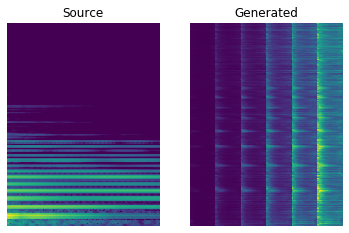

Mean D loss: 0.009781556203961372 Mean G loss: 1.4022539854049683 Mean ID loss: 0.05190348997712135
[Epoch 4501/5000] [Batch 0] [D loss f: 0.008736569434404373 r: 0.07460904866456985] [G loss: 1.410835862159729] [ID loss: 0.05352514982223511] [LR: 0.0002]
Time/Batch 0.04322514533996582
Mean D loss: 0.00727675249800086 Mean G loss: 1.4074535369873047 Mean ID loss: 0.059239644557237625
[Epoch 4502/5000] [Batch 0] [D loss f: 0.014153160154819489 r: 0.04511624574661255] [G loss: 1.4008322954177856] [ID loss: 0.06237664446234703] [LR: 0.0002]
Time/Batch 0.037542295455932614
Mean D loss: 0.014173734933137894 Mean G loss: 1.1988166570663452 Mean ID loss: 0.06730767339468002
[Epoch 4503/5000] [Batch 0] [D loss f: 0.007297327276319265 r: 0.038147035986185074] [G loss: 1.2403545379638672] [ID loss: 0.07255995273590088] [LR: 0.0002]
Time/Batch 0.03726968765258789
Mean D loss: 0.006773957516998053 Mean G loss: 1.7102938890457153 Mean ID loss: 0.0820317268371582
[Epoch 4504/5000] [Batch 0] [D loss 

  2%|▏         | 40/2000 [00:00<00:03, 611.94it/s, loss=3.48e-5, spectral_convergence=-8.59]

Time/Batch 0.03738327026367187
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 825.11it/s, loss=2.61e-5, spectral_convergence=-28]  


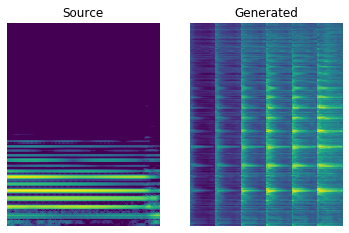

Mean D loss: 0.001015935675241053 Mean G loss: 1.7519675493240356 Mean ID loss: 0.08355018496513367
[Epoch 4551/5000] [Batch 0] [D loss f: 0.0009925849735736847 r: 0.018222598358988762] [G loss: 1.6282001733779907] [ID loss: 0.08302716165781021] [LR: 0.0002]
Time/Batch 0.04236888885498047
Mean D loss: 0.035180289298295975 Mean G loss: 1.373395323753357 Mean ID loss: 0.06834205240011215
[Epoch 4552/5000] [Batch 0] [D loss f: 0.035046450793743134 r: 0.0767824575304985] [G loss: 1.3724699020385742] [ID loss: 0.06538882851600647] [LR: 0.0002]
Time/Batch 0.03748035430908203
Mean D loss: 0.025873227044939995 Mean G loss: 1.194535732269287 Mean ID loss: 0.0689137652516365
[Epoch 4553/5000] [Batch 0] [D loss f: 0.030184976756572723 r: 0.0723310336470604] [G loss: 1.1924034357070923] [ID loss: 0.06853780895471573] [LR: 0.0002]
Time/Batch 0.03747215270996094
Mean D loss: 0.023186666890978813 Mean G loss: 1.633806586265564 Mean ID loss: 0.05922906473278999
[Epoch 4554/5000] [Batch 0] [D loss f: 0

  2%|▏         | 40/2000 [00:00<00:02, 658.78it/s, loss=0.000198, spectral_convergence=-9.07]

Time/Batch 0.03741941452026367
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 847.67it/s, loss=3.09e-5, spectral_convergence=-17.1]


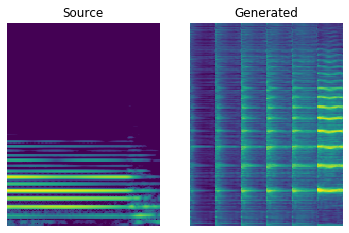

Mean D loss: 0.0951092541217804 Mean G loss: 1.4415454864501953 Mean ID loss: 0.07073879987001419
[Epoch 4601/5000] [Batch 0] [D loss f: 0.08130017668008804 r: 0.2769319415092468] [G loss: 1.4734264612197876] [ID loss: 0.06949038803577423] [LR: 0.0002]
Time/Batch 0.04292302131652832
Mean D loss: 0.08077126741409302 Mean G loss: 1.1365227699279785 Mean ID loss: 0.048521533608436584
[Epoch 4602/5000] [Batch 0] [D loss f: 0.17043523490428925 r: 0.16860632598400116] [G loss: 0.9992373585700989] [ID loss: 0.048636291176080704] [LR: 0.0002]
Time/Batch 0.037234830856323245
Mean D loss: 0.16684888303279877 Mean G loss: 0.8627554774284363 Mean ID loss: 0.04992970451712608
[Epoch 4603/5000] [Batch 0] [D loss f: 0.07083413004875183 r: 0.147719606757164] [G loss: 1.057108998298645] [ID loss: 0.051098763942718506] [LR: 0.0002]
Time/Batch 0.03733901977539063
Mean D loss: 0.024790776893496513 Mean G loss: 1.6220115423202515 Mean ID loss: 0.05566317215561867
[Epoch 4604/5000] [Batch 0] [D loss f: 0.03

  2%|▏         | 40/2000 [00:00<00:03, 626.37it/s, loss=2.32e-7, spectral_convergence=-5.75]

Time/Batch 0.03733162879943848
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 825.05it/s, loss=0.00591, spectral_convergence=-10.8]


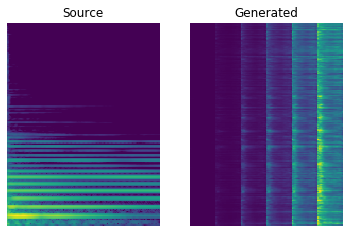

Mean D loss: 0.001064607873558998 Mean G loss: 1.379292607307434 Mean ID loss: 0.062231454998254776
[Epoch 4651/5000] [Batch 0] [D loss f: 0.001064607873558998 r: 0.12485837936401367] [G loss: 1.3782286643981934] [ID loss: 0.05819335952401161] [LR: 0.0002]
Time/Batch 0.042941951751708986
Mean D loss: 0.02953401394188404 Mean G loss: 1.4156275987625122 Mean ID loss: 0.04901996627449989
[Epoch 4652/5000] [Batch 0] [D loss f: 0.02953401394188404 r: 0.05885237827897072] [G loss: 1.3856126070022583] [ID loss: 0.049016986042261124] [LR: 0.0002]
Time/Batch 0.03723549842834473
Mean D loss: 0.024056196212768555 Mean G loss: 1.2162967920303345 Mean ID loss: 0.04892529174685478
[Epoch 4653/5000] [Batch 0] [D loss f: 0.024056196212768555 r: 0.07422720640897751] [G loss: 1.277251124382019] [ID loss: 0.04925322160124779] [LR: 0.0002]
Time/Batch 0.03694615364074707
Mean D loss: 0.0038854379672557116 Mean G loss: 1.522054672241211 Mean ID loss: 0.05035944655537605
[Epoch 4654/5000] [Batch 0] [D loss f

  2%|▏         | 30/2000 [00:00<00:03, 581.46it/s, loss=1.64e-5, spectral_convergence=-10.4]

Time/Batch 0.03717460632324219
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 858.01it/s, loss=7.54e-5, spectral_convergence=-26]   


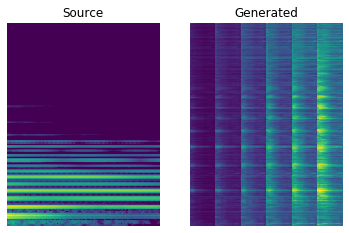

Mean D loss: 0.015562854707241058 Mean G loss: 1.4743739366531372 Mean ID loss: 0.05129489675164223
[Epoch 4701/5000] [Batch 0] [D loss f: 0.02328907698392868 r: 0.08615129441022873] [G loss: 1.4672459363937378] [ID loss: 0.05052727460861206] [LR: 0.0002]
Time/Batch 0.042924022674560545
Mean D loss: 0.08590185642242432 Mean G loss: 1.3916258811950684 Mean ID loss: 0.049321919679641724
[Epoch 4702/5000] [Batch 0] [D loss f: 0.09472053498029709 r: 0.09167373925447464] [G loss: 1.382013201713562] [ID loss: 0.05018802359700203] [LR: 0.0002]
Time/Batch 0.03709511756896973
Mean D loss: 0.07001777738332748 Mean G loss: 1.182932734489441 Mean ID loss: 0.05788697674870491
[Epoch 4703/5000] [Batch 0] [D loss f: 0.0635516345500946 r: 0.10565408319234848] [G loss: 1.153072476387024] [ID loss: 0.05677780881524086] [LR: 0.0002]
Time/Batch 0.037409496307373044
Mean D loss: 0.0607852004468441 Mean G loss: 1.0207425355911255 Mean ID loss: 0.048425476998090744
[Epoch 4704/5000] [Batch 0] [D loss f: 0.06

  2%|▏         | 40/2000 [00:00<00:02, 689.87it/s, loss=0.0052, spectral_convergence=-3.21] 

Time/Batch 0.03729701042175293
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 818.50it/s, loss=1.85e-5, spectral_convergence=-17.6]


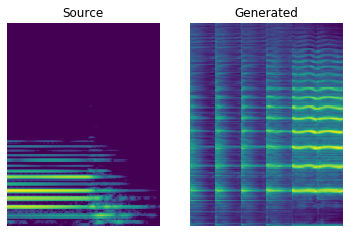

Mean D loss: 0.06567587703466415 Mean G loss: 1.5803184509277344 Mean ID loss: 0.057356562465429306
[Epoch 4751/5000] [Batch 0] [D loss f: 0.06711741536855698 r: 0.08890917897224426] [G loss: 1.5374994277954102] [ID loss: 0.057684678584337234] [LR: 0.0002]
Time/Batch 0.04291243553161621
Mean D loss: 0.03309498727321625 Mean G loss: 1.4915980100631714 Mean ID loss: 0.05489226058125496
[Epoch 4752/5000] [Batch 0] [D loss f: 0.03835110738873482 r: 0.09452245384454727] [G loss: 1.4426409006118774] [ID loss: 0.052680324763059616] [LR: 0.0002]
Time/Batch 0.03712759017944336
Mean D loss: 0.03316087648272514 Mean G loss: 1.4139995574951172 Mean ID loss: 0.04978224262595177
[Epoch 4753/5000] [Batch 0] [D loss f: 0.026463225483894348 r: 0.09436503797769547] [G loss: 1.492419719696045] [ID loss: 0.05312837287783623] [LR: 0.0002]
Time/Batch 0.03761377334594727
Mean D loss: 0.031564921140670776 Mean G loss: 1.7330769300460815 Mean ID loss: 0.06266810745000839
[Epoch 4754/5000] [Batch 0] [D loss f: 

  2%|▏         | 40/2000 [00:00<00:02, 674.01it/s, loss=1.35e-6, spectral_convergence=-8.48]

Time/Batch 0.03731236457824707
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 823.38it/s, loss=8.54e-5, spectral_convergence=-31.1] 


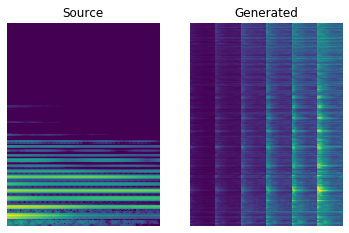

Mean D loss: 0.08021630346775055 Mean G loss: 0.9606785774230957 Mean ID loss: 0.0532674603164196
[Epoch 4801/5000] [Batch 0] [D loss f: 0.061353374272584915 r: 0.15018750727176666] [G loss: 1.0239038467407227] [ID loss: 0.05432447791099548] [LR: 0.0002]
Time/Batch 0.04301023483276367
Mean D loss: 0.05092574283480644 Mean G loss: 1.3963090181350708 Mean ID loss: 0.04826297238469124
[Epoch 4802/5000] [Batch 0] [D loss f: 0.06586310267448425 r: 0.12566262483596802] [G loss: 1.3292614221572876] [ID loss: 0.04702552780508995] [LR: 0.0002]
Time/Batch 0.0378173828125
Mean D loss: 0.07534710317850113 Mean G loss: 1.0091121196746826 Mean ID loss: 0.04464240372180939
[Epoch 4803/5000] [Batch 0] [D loss f: 0.03262488916516304 r: 0.14081057906150818] [G loss: 1.097662091255188] [ID loss: 0.047766488045454025] [LR: 0.0002]
Time/Batch 0.0374753475189209
Mean D loss: 0.06478530168533325 Mean G loss: 1.381095051765442 Mean ID loss: 0.053437620401382446
[Epoch 4804/5000] [Batch 0] [D loss f: 0.0647853

  2%|▏         | 40/2000 [00:00<00:02, 695.80it/s, loss=1.03e-6, spectral_convergence=-10]  

Time/Batch 0.037085771560668945
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 852.91it/s, loss=0.000563, spectral_convergence=-13.8]


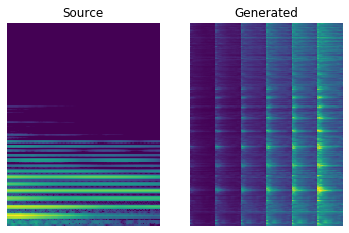

Mean D loss: 0.06466663628816605 Mean G loss: 1.4707227945327759 Mean ID loss: 0.06276290118694305
[Epoch 4851/5000] [Batch 0] [D loss f: 0.05006742104887962 r: 0.13660337030887604] [G loss: 1.5365127325057983] [ID loss: 0.06221237778663635] [LR: 0.0002]
Time/Batch 0.04170150756835937
Mean D loss: 0.04520662501454353 Mean G loss: 1.2906391620635986 Mean ID loss: 0.04791301116347313
[Epoch 4852/5000] [Batch 0] [D loss f: 0.04520662501454353 r: 0.14486131072044373] [G loss: 1.3065106868743896] [ID loss: 0.047529179602861404] [LR: 0.0002]
Time/Batch 0.03741931915283203
Mean D loss: 0.05692286416888237 Mean G loss: 1.3637367486953735 Mean ID loss: 0.0474211759865284
[Epoch 4853/5000] [Batch 0] [D loss f: 0.05692286416888237 r: 0.20323890447616577] [G loss: 1.394948124885559] [ID loss: 0.048040132969617844] [LR: 0.0002]
Time/Batch 0.03709468841552734
Mean D loss: 0.10015978664159775 Mean G loss: 1.4440613985061646 Mean ID loss: 0.04606766626238823
[Epoch 4854/5000] [Batch 0] [D loss f: 0.10

  2%|▏         | 40/2000 [00:00<00:03, 606.58it/s, loss=8.96e-7, spectral_convergence=-12]  

Time/Batch 0.03713655471801758
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 849.18it/s, loss=0.000578, spectral_convergence=-24.5]


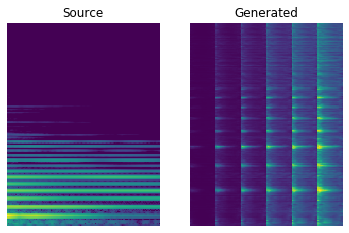

Mean D loss: 0.08232905715703964 Mean G loss: 1.603399634361267 Mean ID loss: 0.04329515993595123
[Epoch 4901/5000] [Batch 0] [D loss f: 0.13988825678825378 r: 0.37347719073295593] [G loss: 1.5150777101516724] [ID loss: 0.04294879361987114] [LR: 0.0002]
Time/Batch 0.04199519157409668
Mean D loss: 0.23624379932880402 Mean G loss: 0.8018893599510193 Mean ID loss: 0.04669387638568878
[Epoch 4902/5000] [Batch 0] [D loss f: 0.19813401997089386 r: 0.3276987373828888] [G loss: 0.8945307731628418] [ID loss: 0.049078602343797684] [LR: 0.0002]
Time/Batch 0.03747634887695313
Mean D loss: 0.23543904721736908 Mean G loss: 1.3400487899780273 Mean ID loss: 0.051823776215314865
[Epoch 4903/5000] [Batch 0] [D loss f: 0.2335066795349121 r: 0.20446932315826416] [G loss: 1.3433566093444824] [ID loss: 0.04978733882308006] [LR: 0.0002]
Time/Batch 0.036798524856567386
Mean D loss: 0.17081284523010254 Mean G loss: 1.5035500526428223 Mean ID loss: 0.047430235892534256
[Epoch 4904/5000] [Batch 0] [D loss f: 0.1

  2%|▏         | 40/2000 [00:00<00:02, 693.85it/s, loss=6.62e-7, spectral_convergence=-9.37]

Time/Batch 0.037000417709350586
Saving...
(6, 192, 24, 1)


100%|██████████| 2000/2000 [00:02<00:00, 805.68it/s, loss=0.000178, spectral_convergence=-22.8]


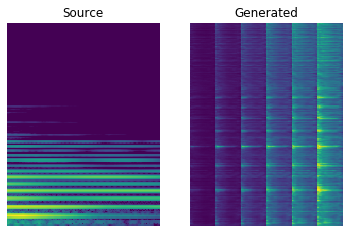

Mean D loss: 0.09045115858316422 Mean G loss: 1.2614091634750366 Mean ID loss: 0.04475245997309685
[Epoch 4951/5000] [Batch 0] [D loss f: 0.08712761849164963 r: 0.16767098009586334] [G loss: 1.2176505327224731] [ID loss: 0.044504594057798386] [LR: 0.0002]
Time/Batch 0.042655134201049806
Mean D loss: 0.06469768285751343 Mean G loss: 1.0237839221954346 Mean ID loss: 0.04749799892306328
[Epoch 4952/5000] [Batch 0] [D loss f: 0.051812540739774704 r: 0.2188139706850052] [G loss: 1.099509596824646] [ID loss: 0.04698503017425537] [LR: 0.0002]
Time/Batch 0.037087869644165036
Mean D loss: 0.117521733045578 Mean G loss: 1.3025566339492798 Mean ID loss: 0.04365866258740425
[Epoch 4953/5000] [Batch 0] [D loss f: 0.117521733045578 r: 0.2278258055448532] [G loss: 1.280483603477478] [ID loss: 0.0441434383392334] [LR: 0.0002]
Time/Batch 0.037013578414916995
Mean D loss: 0.10664726048707962 Mean G loss: 1.2169439792633057 Mean ID loss: 0.045918095856904984
[Epoch 4954/5000] [Batch 0] [D loss f: 0.10893

In [17]:
# Training

# n_save = how many epochs between each saving and displaying of results
# gupt = how many discriminator updates for generator+siamese update
save_path = "../baselines/melganvc/check_single"
os.mkdir(save_path)
train(1000, batch_size=bs, lr=0.0002, n_save=100, gupt=3, save_path=save_path)

In [34]:
# After Training, use these functions to convert data with the generator and save the results

# Assembling generated Spectrogram chunks into final Spectrogram
def specass(a, spec):
    but = False
    con = np.array([])
    nim = a.shape[0]
    for i in range(nim - 1):
        im = a[i]
        im = np.squeeze(im)
        if not but:
            con = im
            but = True
        else:
            con = np.concatenate((con, im), axis=1)
    diff = spec.shape[1] - (nim * shape)
    a = np.squeeze(a)
    con = np.concatenate((con, a[-1, :, -diff:]), axis=1)
    return np.squeeze(con)


# Splitting input spectrogram into different chunks to feed to the generator
def chopspec(spec):
    dsa = []
    for i in range(spec.shape[1] // shape):
        im = spec[:, i * shape : i * shape + shape]
        im = np.reshape(im, (im.shape[0], im.shape[1], 1))
        dsa.append(im)
    imlast = spec[:, -shape:]
    imlast = np.reshape(imlast, (imlast.shape[0], imlast.shape[1], 1))
    dsa.append(imlast)
    return np.array(dsa, dtype=np.float32)


# Converting from source Spectrogram to target Spectrogram
def towave(spec, name, path="../baselines/melganvc/check", show=False):
    specarr = chopspec(spec)
    print(specarr.shape)
    a = specarr
    print("Generating...")
    ab = gen(a, training=False)
    print("Assembling and Converting...")
    a = specass(a, spec)
    ab = specass(ab, spec)
    awv = deprep(a)
    abwv = deprep(ab)
    print("Saving...")
    pathfin = f"{path}/{name}"
    os.mkdir(pathfin)
    sf.write(pathfin + "/AB.wav", abwv, sr)
    sf.write(pathfin + "/A.wav", awv, sr)
    print("Saved WAV!")
    IPython.display.display(IPython.display.Audio(np.squeeze(abwv), rate=sr))
    IPython.display.display(IPython.display.Audio(np.squeeze(awv), rate=sr))
    if show:
        fig, axs = plt.subplots(ncols=2)
        axs[0].imshow(np.flip(a, -2), cmap=None)
        axs[0].axis("off")
        axs[0].set_title("Source")
        axs[1].imshow(np.flip(ab, -2), cmap=None)
        axs[1].axis("off")
        axs[1].set_title("Generated")
        plt.show()
    return abwv

(983342,)


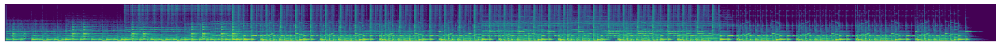

  0%|          | 0/2000 [00:00<?, ?it/s]

(214, 192, 24, 1)
Generating...
Assembling and Converting...


100%|██████████| 2000/2000 [00:10<00:00, 184.77it/s, loss=0.000648, spectral_convergence=-9]   


Saving...
Saved WAV!


In [36]:
# Wav to wav conversion

wv, sr = librosa.load(librosa.util.example_audio_file(), sr=16000)  # Load waveform
print(wv.shape)
speca = prep(wv)  # Waveform to Spectrogram

plt.figure(figsize=(50, 1))  # Show Spectrogram
plt.imshow(np.flip(speca, axis=0), cmap=None)
plt.axis("off")
plt.show()

abwv = towave(speca, name="FILENAME1", path="../baselines/melganvc/check")  # Convert and save wav